<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_7_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):

    # Add brightness to images    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)

    # Convert the image to grayscale, and blur it slightl
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Hyperparameters 
image_size = 224
BATCH_SIZE = 32
hyper_channels = 3

In [10]:
#Bounding box with one tumor
#Define the name of the 3 classes of MRI
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
#Define the list of images for the training
X_train = []
bb = []
count = 0;
#Lists of coordinates for resizing bounding box
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

#Loading training images
for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_train.append(image)

#Load train bounding box labels
image_index = 0
#Define the list of bb coordinates for the training images
bb_list = []
#List used to duplicate images with two bounding box
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] 
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the train list before image duplication:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimension of the list after image duplication:
print('Dimension of the train list after image duplication:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

#Load test images
X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_test.append(image_test)

#Load the bounding box labels for testing
image_index = 0
count_test = 0;
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                               
                #rescaling the bounding box to the correct position after crop    
                temp_array[0] = temp_array[0]*images_width_test[count_test] 
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the test list before image duplication:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimension of the list after image duplication:
print('Dimension of the test list after image duplication:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))


Dimension of the train list before image duplication:
X_train:  878
bb_list:  878
Dimension of the train list after image duplication:
X_train:  919
bb_train:  919
Dimension of the test list before image duplication:
X_test:  223
bb_list:  223
Dimension of the test list after image duplication:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [13]:
#Shuffle of the train dataset
X_train, bb_train = shuffle(X_train, bb_train)

In [14]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [15]:
tf.keras.backend.set_image_data_format('channels_last')
#Creation of the three data generator datasets to feed the model with batches of data during the training process
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [16]:
#Function to define the IoU metrics
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):

        #define the true and predicted coordinates (height and width)
        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2 
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
        #Define the bb true area 
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height 

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height 


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) 

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)

        results.append(iou)
    return np.mean(results)

# metric creation
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [17]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in red the real bounding box
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in green the predicted bounding box
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [18]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [19]:
#change folder to create the folder for saving the model
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [20]:
#list of callbacks
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [21]:
input_ = Input(shape=[image_size,image_size, hyper_channels])

x = input_

for i in range(7):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

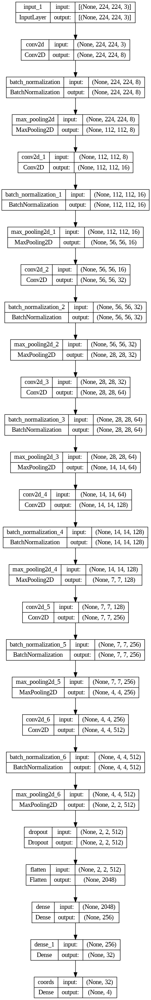

In [22]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True, show_layer_names=True, rankdir='TB', expand_nested=True)

In [23]:
#Compilation of the model
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 46.0154 - IoU: 0.0331
Epoch 1: val_IoU improved from -inf to 0.00000, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 43ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


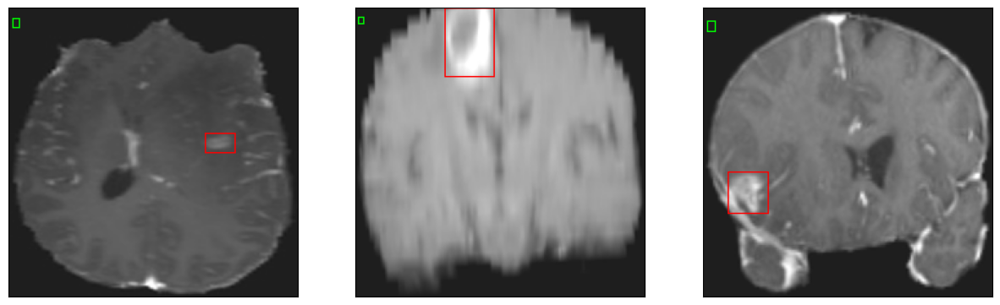

26/26 [==============================] - 21s 219ms/step - loss: 46.0154 - IoU: 0.0331 - val_loss: 66.7162 - val_IoU: 0.0000e+00
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 26.1834 - IoU: 0.1112
Epoch 2: val_IoU improved from 0.00000 to 0.05918, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


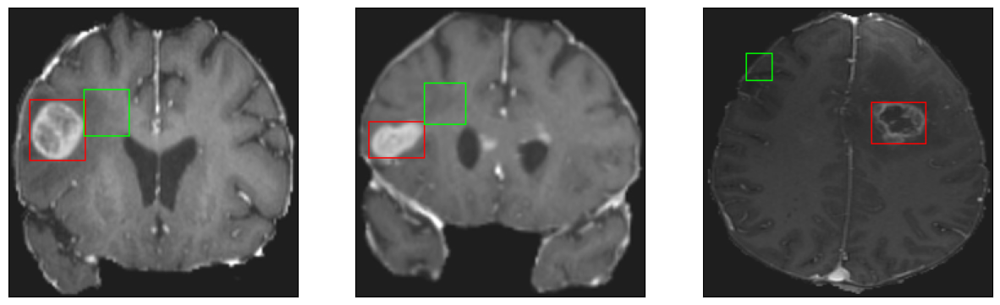

26/26 [==============================] - 3s 101ms/step - loss: 25.9807 - IoU: 0.1125 - val_loss: 27.7380 - val_IoU: 0.0592
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 21.8827 - IoU: 0.1184
Epoch 3: val_IoU improved from 0.05918 to 0.06291, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


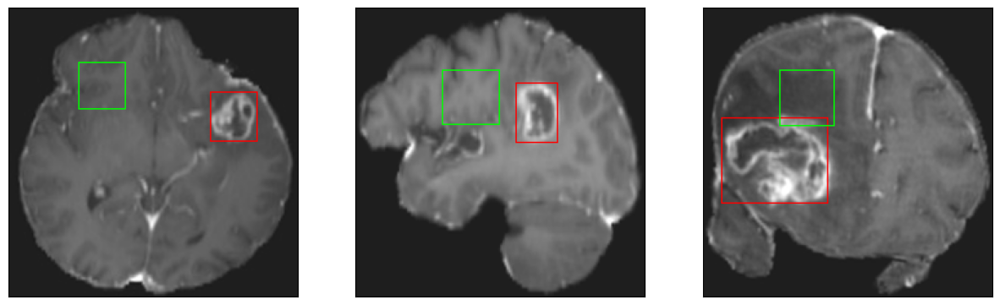

26/26 [==============================] - 3s 98ms/step - loss: 21.8827 - IoU: 0.1184 - val_loss: 27.9170 - val_IoU: 0.0629
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 19.1547 - IoU: 0.1628
Epoch 4: val_IoU improved from 0.06291 to 0.11623, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


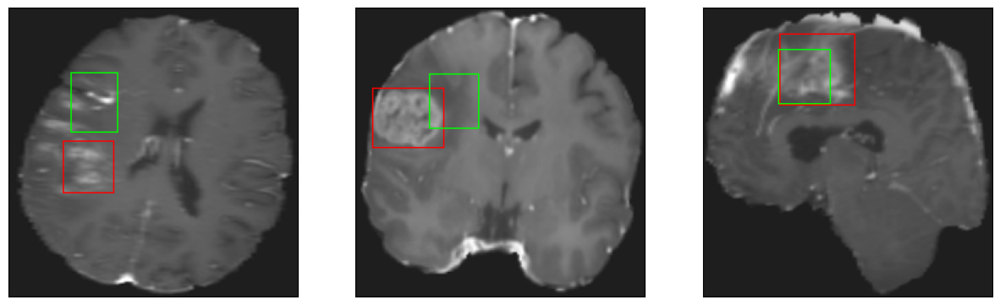

26/26 [==============================] - 3s 97ms/step - loss: 19.0367 - IoU: 0.1664 - val_loss: 22.7648 - val_IoU: 0.1162
Epoch 5/200
25/26 [===========================>..] - ETA: 0s - loss: 15.7222 - IoU: 0.2483
Epoch 5: val_IoU improved from 0.11623 to 0.13333, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


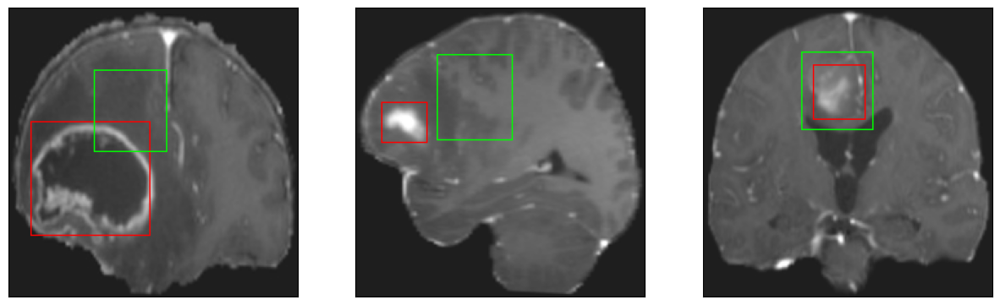

26/26 [==============================] - 3s 97ms/step - loss: 15.6850 - IoU: 0.2494 - val_loss: 26.8340 - val_IoU: 0.1333
Epoch 6/200
25/26 [===========================>..] - ETA: 0s - loss: 14.0637 - IoU: 0.2935
Epoch 6: val_IoU improved from 0.13333 to 0.17387, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


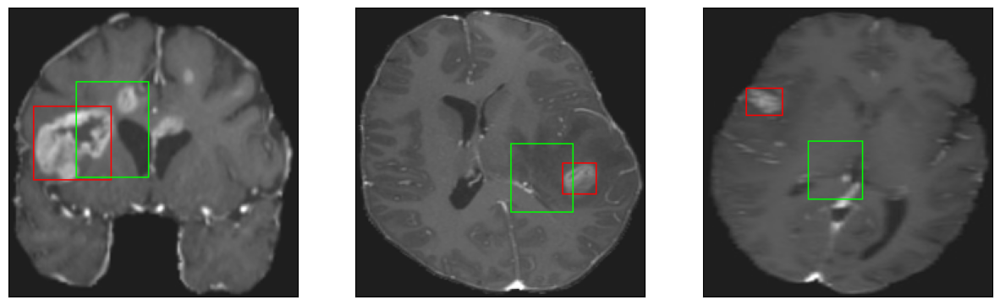

26/26 [==============================] - 3s 106ms/step - loss: 14.1636 - IoU: 0.2907 - val_loss: 21.6794 - val_IoU: 0.1739
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 12.7033 - IoU: 0.3405
Epoch 7: val_IoU improved from 0.17387 to 0.21254, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 12ms/step
4


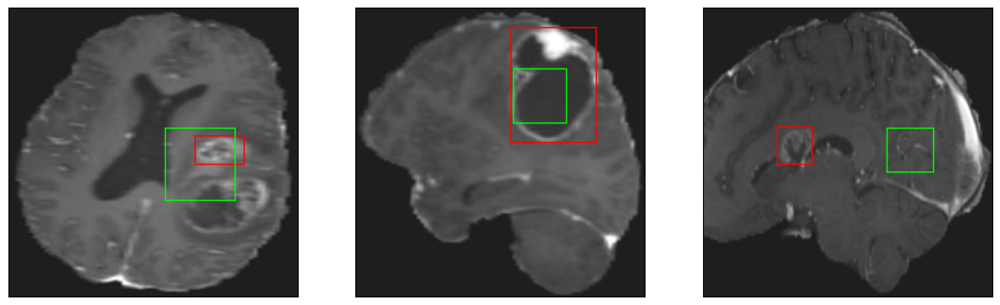

26/26 [==============================] - 4s 151ms/step - loss: 12.7033 - IoU: 0.3405 - val_loss: 18.7440 - val_IoU: 0.2125
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 11.7924 - IoU: 0.3559
Epoch 8: val_IoU improved from 0.21254 to 0.22120, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


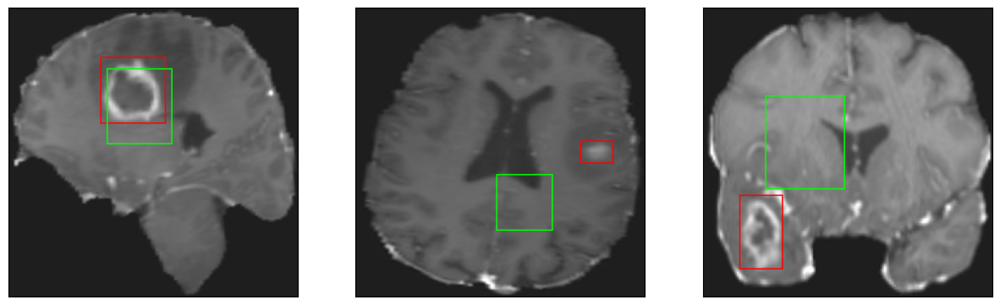

26/26 [==============================] - 3s 96ms/step - loss: 11.7985 - IoU: 0.3548 - val_loss: 18.4500 - val_IoU: 0.2212
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 10.7912 - IoU: 0.3867
Epoch 9: val_IoU did not improve from 0.22120
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


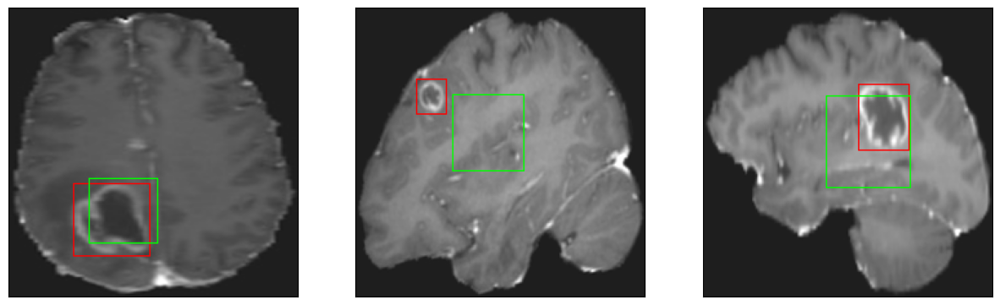

26/26 [==============================] - 2s 90ms/step - loss: 10.7912 - IoU: 0.3867 - val_loss: 19.6459 - val_IoU: 0.2040
Epoch 10/200
25/26 [===========================>..] - ETA: 0s - loss: 10.6004 - IoU: 0.3929
Epoch 10: val_IoU improved from 0.22120 to 0.32074, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


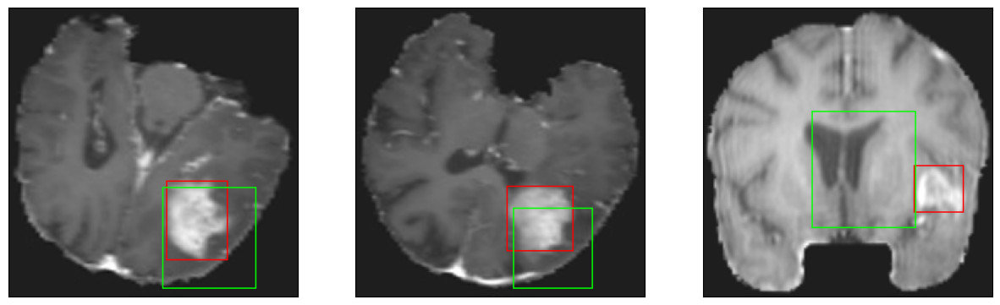

26/26 [==============================] - 3s 109ms/step - loss: 10.5749 - IoU: 0.3936 - val_loss: 16.6338 - val_IoU: 0.3207
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 10.1205 - IoU: 0.4105
Epoch 11: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


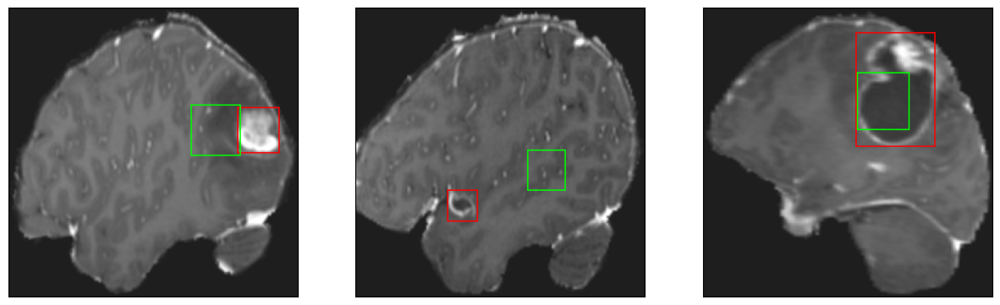

26/26 [==============================] - 2s 96ms/step - loss: 10.1255 - IoU: 0.4092 - val_loss: 14.8694 - val_IoU: 0.2693
Epoch 12/200
25/26 [===========================>..] - ETA: 0s - loss: 10.0874 - IoU: 0.4183
Epoch 12: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


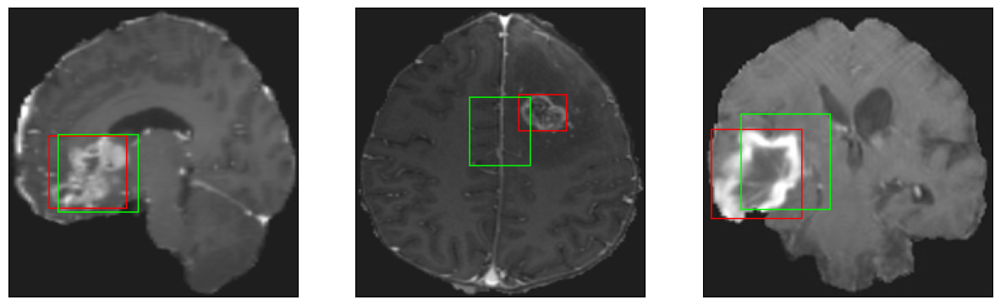

26/26 [==============================] - 3s 98ms/step - loss: 10.0435 - IoU: 0.4202 - val_loss: 18.6356 - val_IoU: 0.2346
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 9.5393 - IoU: 0.4348
Epoch 13: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


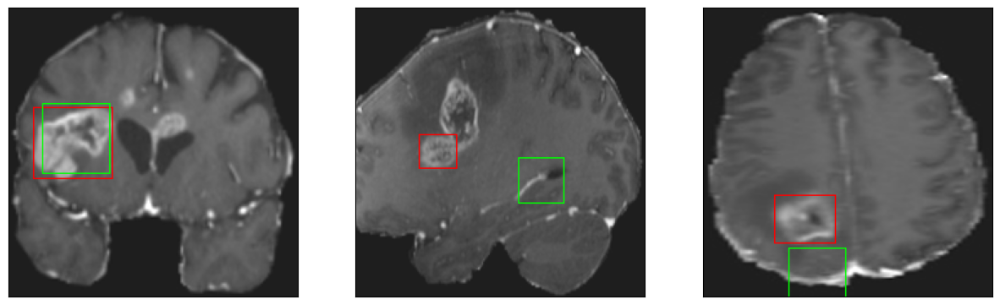

26/26 [==============================] - 2s 95ms/step - loss: 9.5393 - IoU: 0.4348 - val_loss: 14.3173 - val_IoU: 0.2699
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 9.2778 - IoU: 0.4402
Epoch 14: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


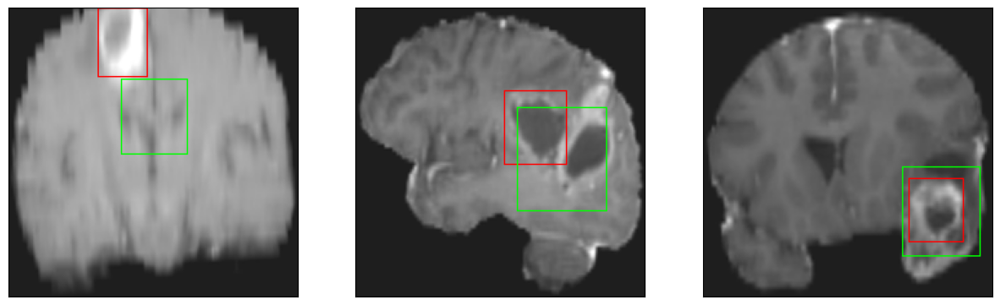

26/26 [==============================] - 3s 100ms/step - loss: 9.2778 - IoU: 0.4402 - val_loss: 15.7338 - val_IoU: 0.2727
Epoch 15/200
25/26 [===========================>..] - ETA: 0s - loss: 9.3954 - IoU: 0.4310
Epoch 15: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


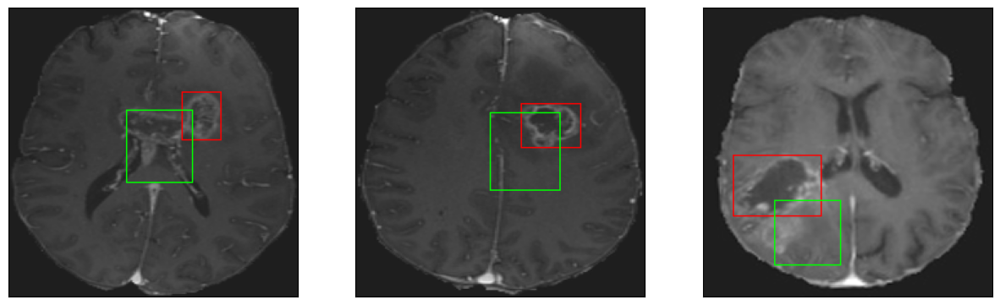

26/26 [==============================] - 2s 96ms/step - loss: 9.3885 - IoU: 0.4321 - val_loss: 17.9120 - val_IoU: 0.2178
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 9.1560 - IoU: 0.4364
Epoch 16: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


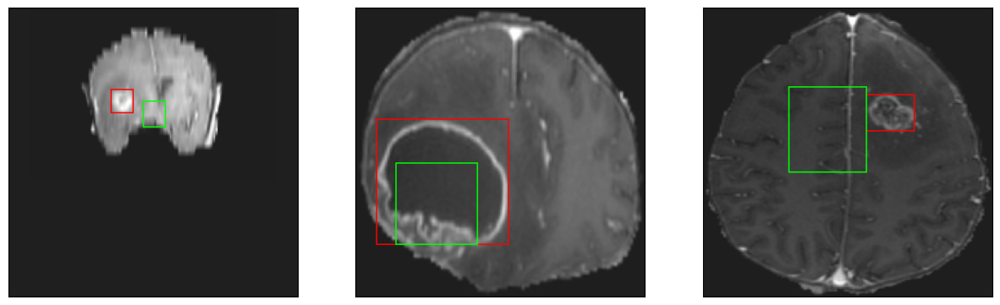

26/26 [==============================] - 3s 97ms/step - loss: 9.1461 - IoU: 0.4364 - val_loss: 15.7236 - val_IoU: 0.2228
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 8.9774 - IoU: 0.4476
Epoch 17: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


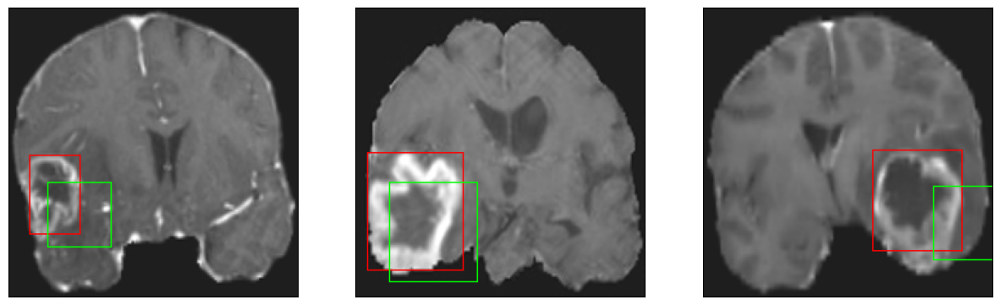

26/26 [==============================] - 2s 94ms/step - loss: 8.9774 - IoU: 0.4476 - val_loss: 13.7197 - val_IoU: 0.2537
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 8.3794 - IoU: 0.4783
Epoch 18: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


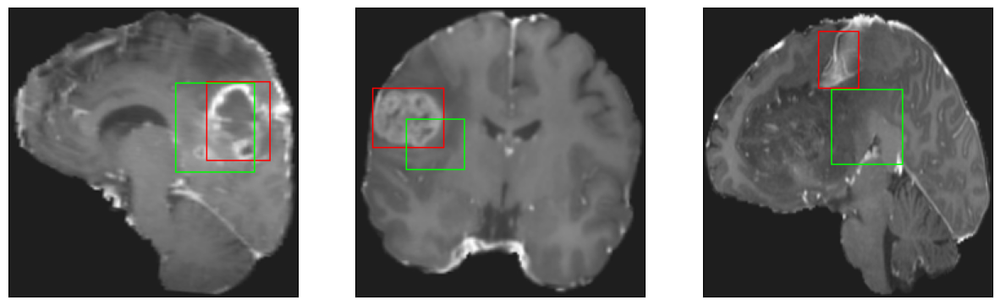

26/26 [==============================] - 3s 101ms/step - loss: 8.4050 - IoU: 0.4773 - val_loss: 15.1309 - val_IoU: 0.2754
Epoch 19/200
25/26 [===========================>..] - ETA: 0s - loss: 7.7940 - IoU: 0.4986
Epoch 19: val_IoU did not improve from 0.32074
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


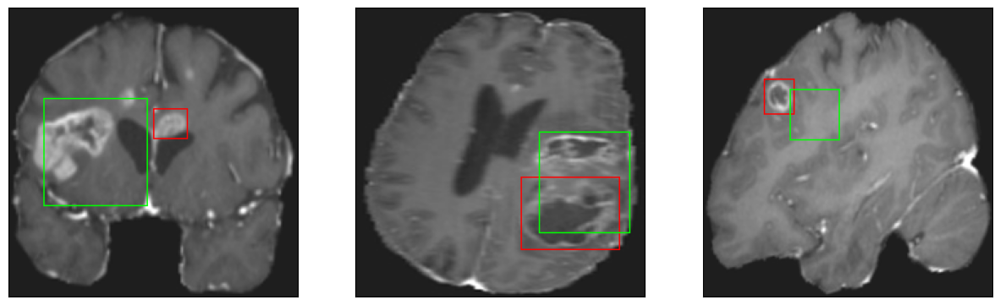

26/26 [==============================] - 2s 91ms/step - loss: 7.8277 - IoU: 0.4987 - val_loss: 16.4786 - val_IoU: 0.3121
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 7.8584 - IoU: 0.4991
Epoch 20: val_IoU improved from 0.32074 to 0.34932, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


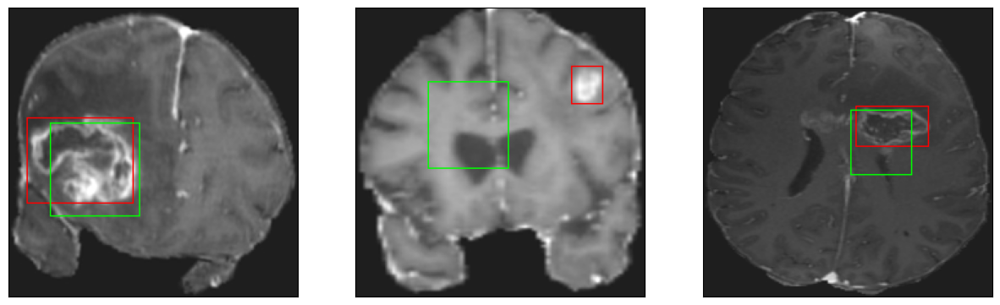

26/26 [==============================] - 4s 142ms/step - loss: 7.8584 - IoU: 0.4991 - val_loss: 12.9314 - val_IoU: 0.3493
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 8.2154 - IoU: 0.4732
Epoch 21: val_IoU did not improve from 0.34932
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


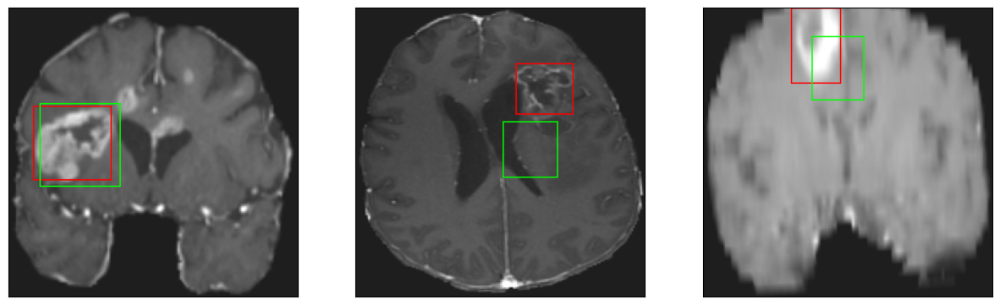

26/26 [==============================] - 3s 99ms/step - loss: 8.1730 - IoU: 0.4761 - val_loss: 13.7201 - val_IoU: 0.3448
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 7.9147 - IoU: 0.4943
Epoch 22: val_IoU improved from 0.34932 to 0.40497, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


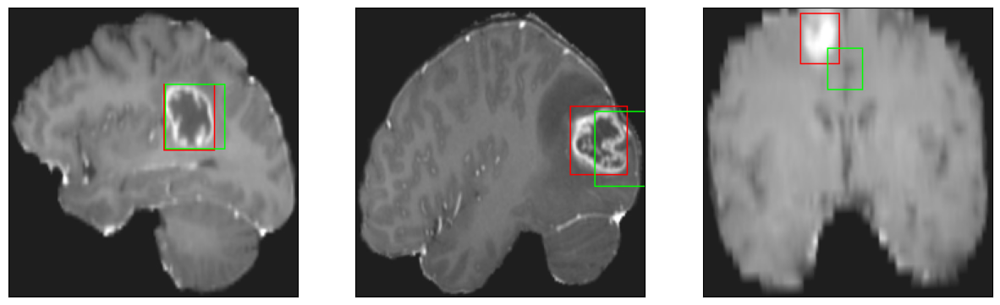

26/26 [==============================] - 3s 110ms/step - loss: 7.9147 - IoU: 0.4943 - val_loss: 10.4644 - val_IoU: 0.4050
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4261 - IoU: 0.5075
Epoch 23: val_IoU did not improve from 0.40497
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


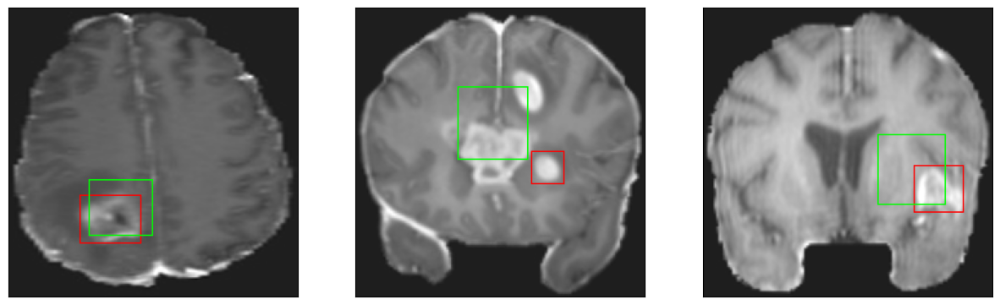

26/26 [==============================] - 2s 93ms/step - loss: 7.4693 - IoU: 0.5035 - val_loss: 10.6123 - val_IoU: 0.3815
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 7.8024 - IoU: 0.4884
Epoch 24: val_IoU did not improve from 0.40497
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


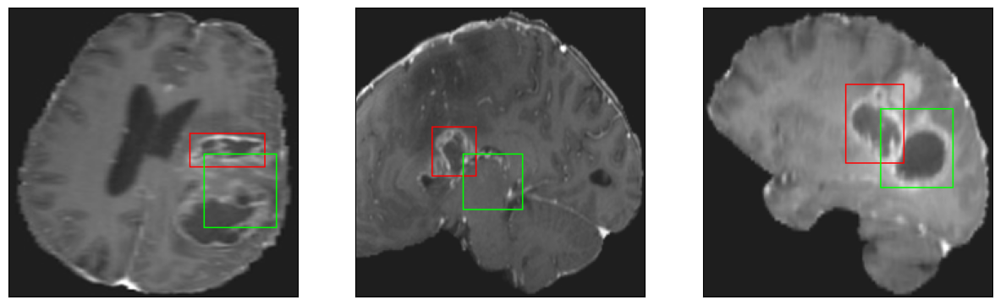

26/26 [==============================] - 2s 96ms/step - loss: 7.8024 - IoU: 0.4884 - val_loss: 13.7261 - val_IoU: 0.2646
Epoch 25/200
25/26 [===========================>..] - ETA: 0s - loss: 7.4192 - IoU: 0.5047
Epoch 25: val_IoU did not improve from 0.40497
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


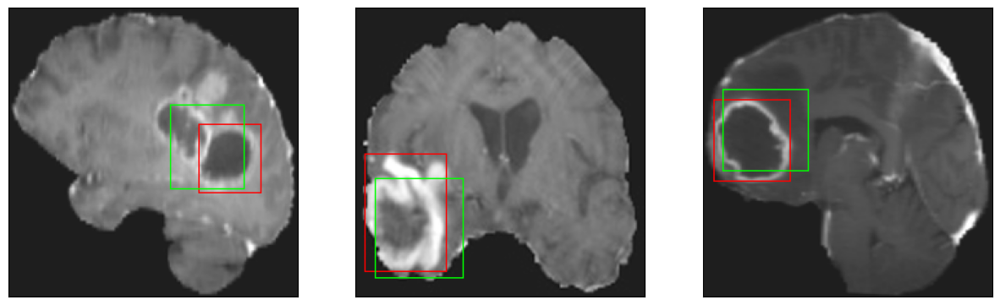

26/26 [==============================] - 3s 103ms/step - loss: 7.4488 - IoU: 0.5042 - val_loss: 10.3957 - val_IoU: 0.3975
Epoch 26/200
25/26 [===========================>..] - ETA: 0s - loss: 7.6321 - IoU: 0.5047
Epoch 26: val_IoU improved from 0.40497 to 0.43524, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


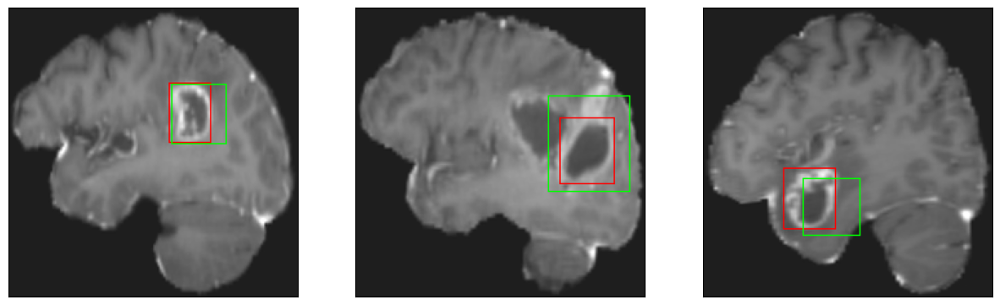

26/26 [==============================] - 4s 144ms/step - loss: 7.6079 - IoU: 0.5038 - val_loss: 9.9529 - val_IoU: 0.4352
Epoch 27/200
25/26 [===========================>..] - ETA: 0s - loss: 7.1451 - IoU: 0.5182
Epoch 27: val_IoU did not improve from 0.43524
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


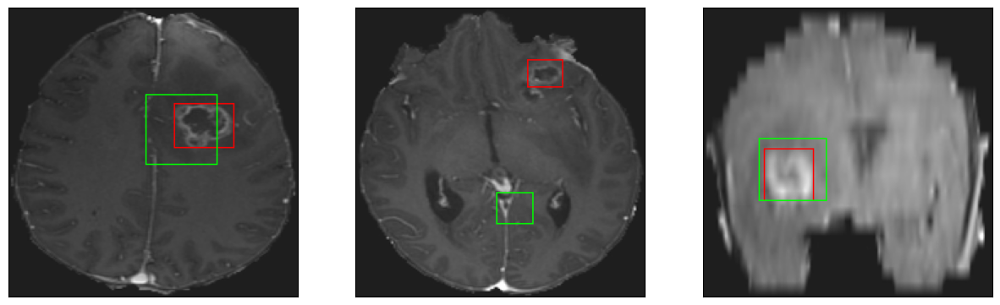

26/26 [==============================] - 3s 105ms/step - loss: 7.1336 - IoU: 0.5187 - val_loss: 11.8582 - val_IoU: 0.3698
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 7.1089 - IoU: 0.5196
Epoch 28: val_IoU did not improve from 0.43524
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


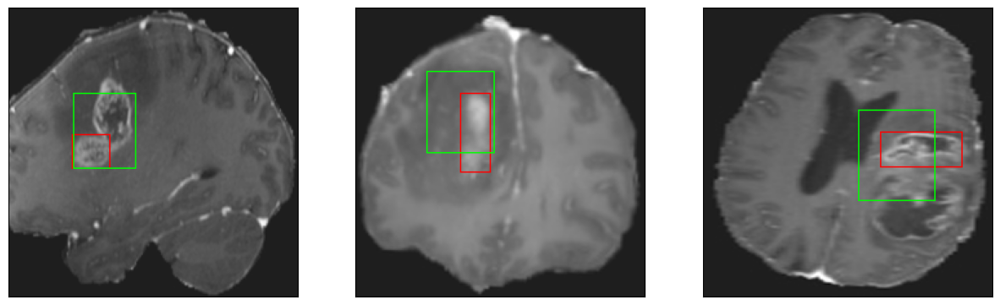

26/26 [==============================] - 3s 112ms/step - loss: 7.1089 - IoU: 0.5196 - val_loss: 12.5405 - val_IoU: 0.3993
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 7.1372 - IoU: 0.5216
Epoch 29: val_IoU did not improve from 0.43524
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


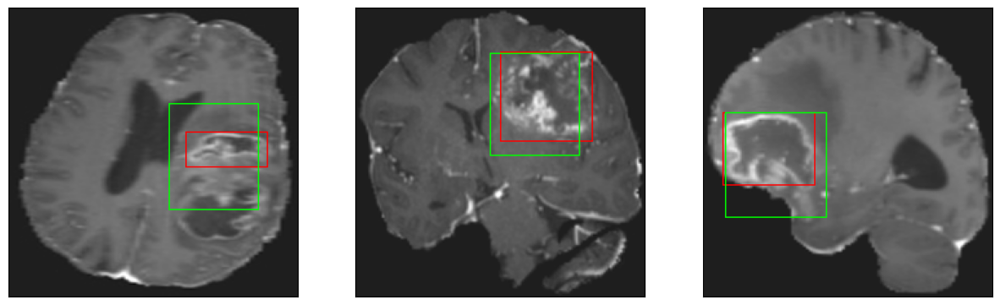

26/26 [==============================] - 3s 130ms/step - loss: 7.1372 - IoU: 0.5216 - val_loss: 14.6658 - val_IoU: 0.4011
Epoch 30/200
25/26 [===========================>..] - ETA: 0s - loss: 6.9157 - IoU: 0.5372
Epoch 30: val_IoU improved from 0.43524 to 0.46592, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


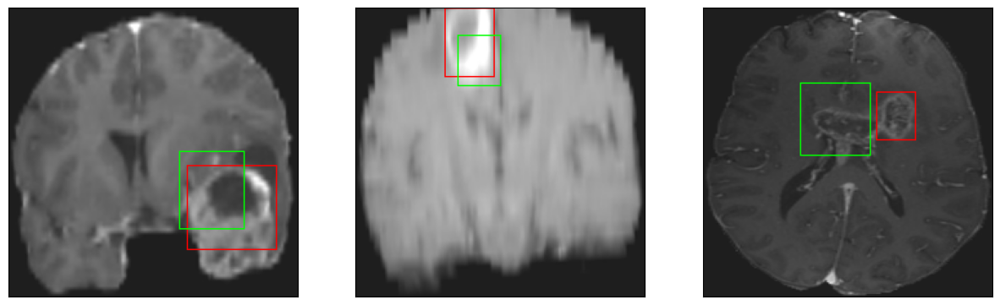

26/26 [==============================] - 4s 154ms/step - loss: 6.9181 - IoU: 0.5363 - val_loss: 9.0153 - val_IoU: 0.4659
Epoch 31/200
25/26 [===========================>..] - ETA: 0s - loss: 6.7140 - IoU: 0.5421
Epoch 31: val_IoU improved from 0.46592 to 0.47464, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


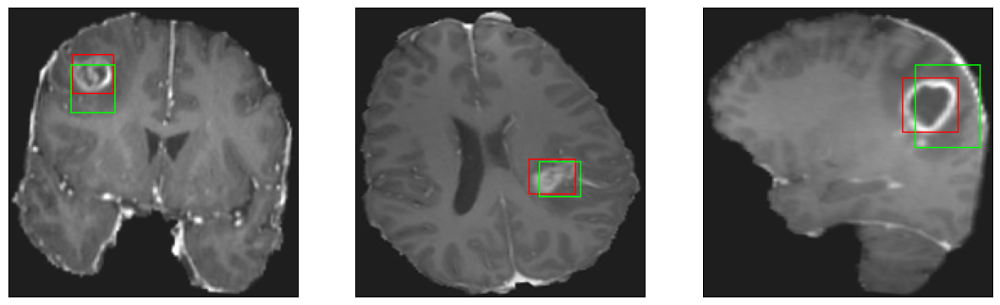

26/26 [==============================] - 3s 107ms/step - loss: 6.7263 - IoU: 0.5423 - val_loss: 9.3670 - val_IoU: 0.4746
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 6.6403 - IoU: 0.5434
Epoch 32: val_IoU did not improve from 0.47464
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


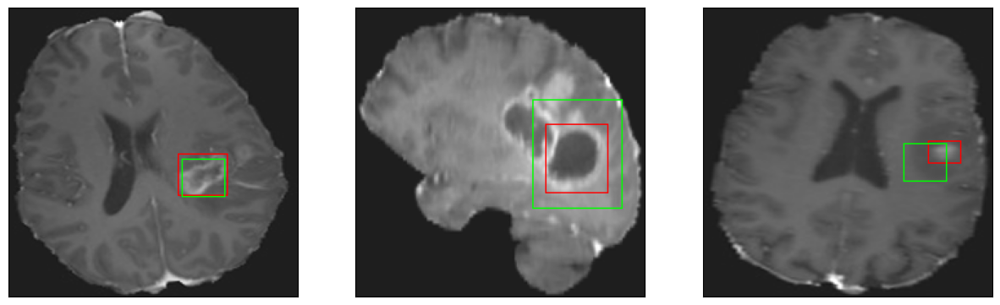

26/26 [==============================] - 3s 115ms/step - loss: 6.6403 - IoU: 0.5434 - val_loss: 10.8848 - val_IoU: 0.4089
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.7686 - IoU: 0.5424
Epoch 33: val_IoU did not improve from 0.47464
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


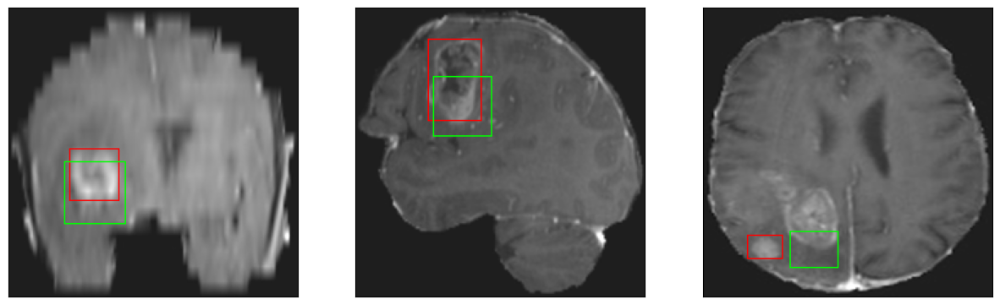

26/26 [==============================] - 3s 125ms/step - loss: 6.7686 - IoU: 0.5424 - val_loss: 10.5109 - val_IoU: 0.4050
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.5983 - IoU: 0.5448
Epoch 34: val_IoU did not improve from 0.47464
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


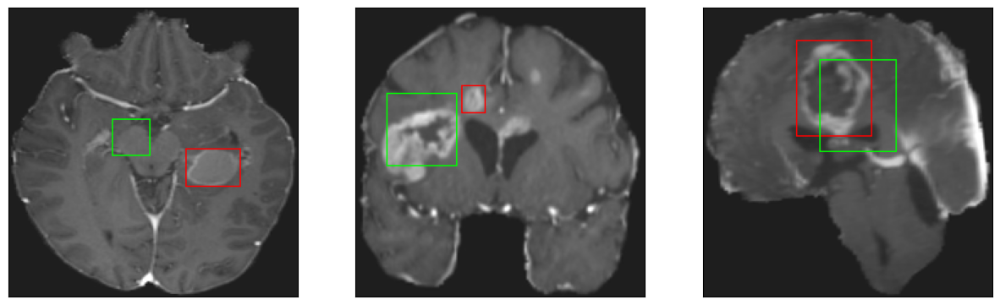

26/26 [==============================] - 3s 102ms/step - loss: 6.5983 - IoU: 0.5448 - val_loss: 9.6134 - val_IoU: 0.4513
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4879 - IoU: 0.5468
Epoch 35: val_IoU did not improve from 0.47464
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


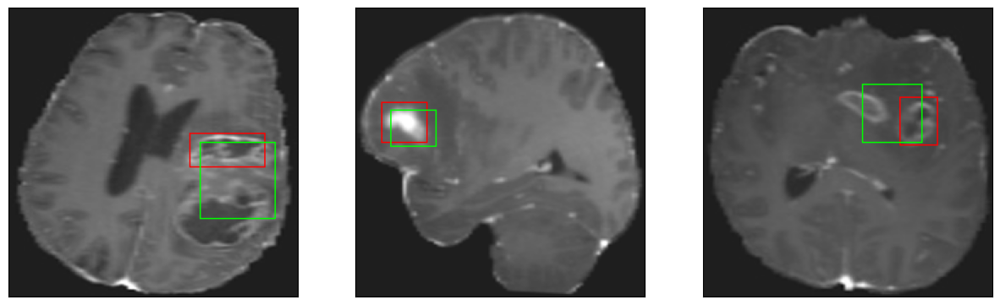

26/26 [==============================] - 3s 102ms/step - loss: 6.4834 - IoU: 0.5474 - val_loss: 10.2269 - val_IoU: 0.4178
Epoch 36/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3694 - IoU: 0.5511
Epoch 36: val_IoU did not improve from 0.47464
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


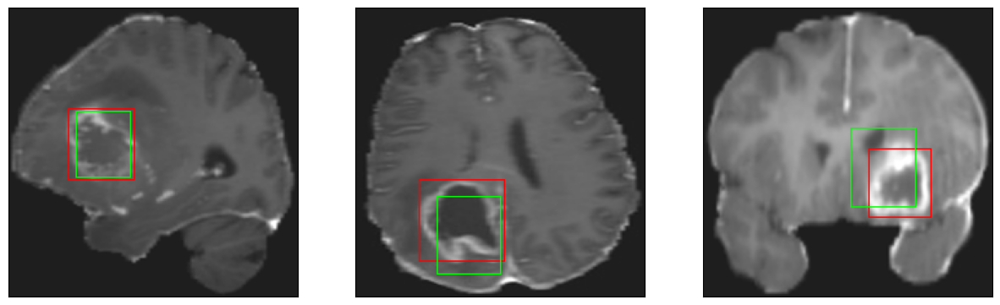

26/26 [==============================] - 3s 104ms/step - loss: 6.4014 - IoU: 0.5494 - val_loss: 10.6717 - val_IoU: 0.3891
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6304 - IoU: 0.5394
Epoch 37: val_IoU improved from 0.47464 to 0.50532, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


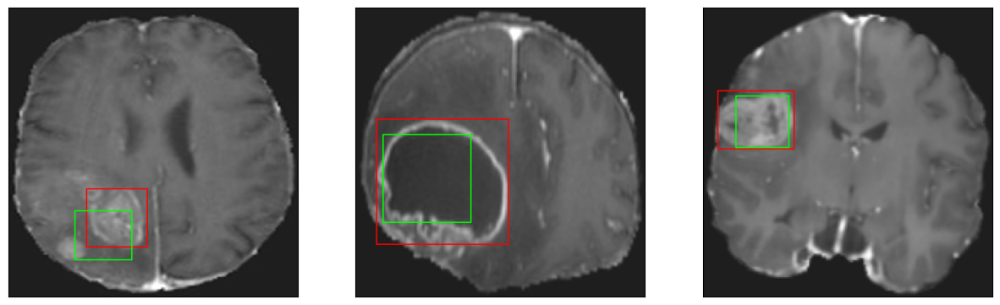

26/26 [==============================] - 4s 150ms/step - loss: 6.6126 - IoU: 0.5404 - val_loss: 9.3373 - val_IoU: 0.5053
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 6.5033 - IoU: 0.5435
Epoch 38: val_IoU improved from 0.50532 to 0.51757, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


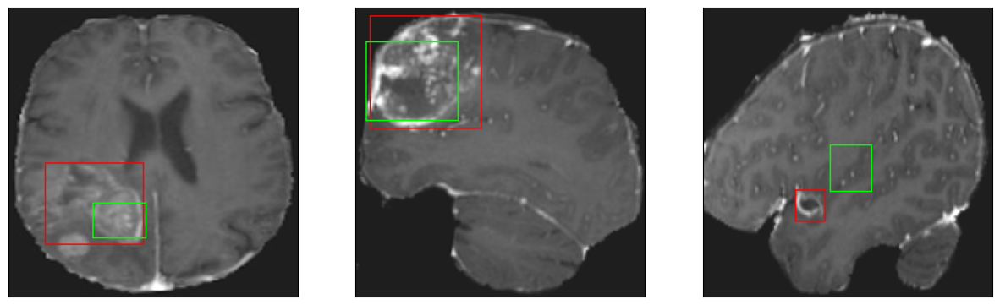

26/26 [==============================] - 3s 109ms/step - loss: 6.5033 - IoU: 0.5435 - val_loss: 8.5323 - val_IoU: 0.5176
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.4909 - IoU: 0.5426
Epoch 39: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


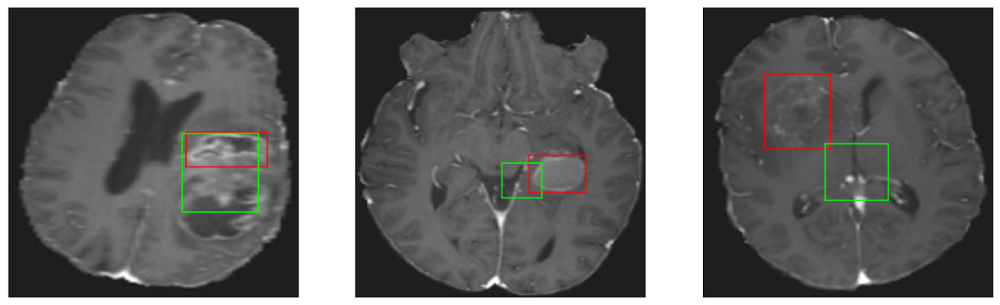

26/26 [==============================] - 3s 108ms/step - loss: 6.4769 - IoU: 0.5444 - val_loss: 9.6973 - val_IoU: 0.4446
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 6.5617 - IoU: 0.5438
Epoch 40: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


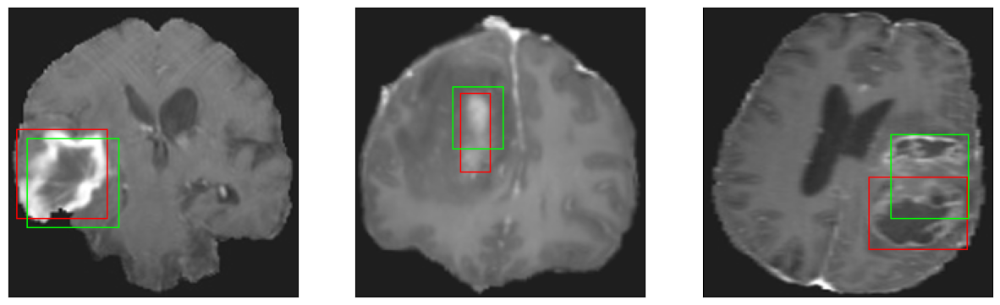

26/26 [==============================] - 3s 129ms/step - loss: 6.5617 - IoU: 0.5438 - val_loss: 10.0736 - val_IoU: 0.4320
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 6.6553 - IoU: 0.5426
Epoch 41: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


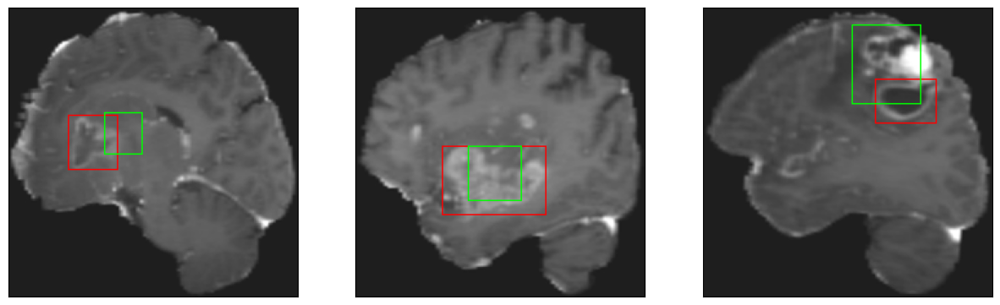

26/26 [==============================] - 3s 114ms/step - loss: 6.6553 - IoU: 0.5426 - val_loss: 9.6512 - val_IoU: 0.4360
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 5.8547 - IoU: 0.5726
Epoch 42: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


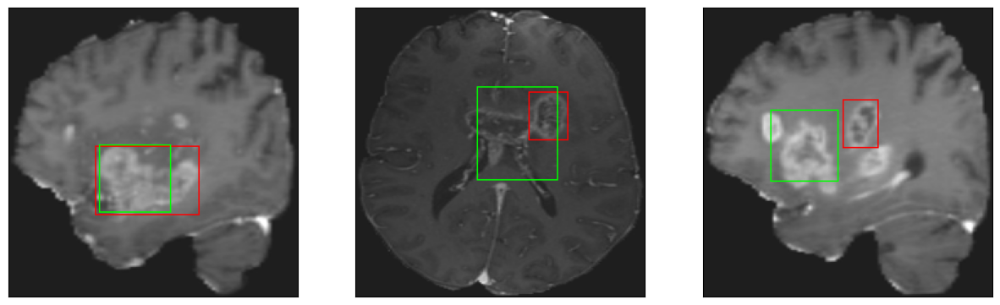

26/26 [==============================] - 3s 101ms/step - loss: 5.8547 - IoU: 0.5726 - val_loss: 10.5067 - val_IoU: 0.4517
Epoch 43/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9804 - IoU: 0.5641
Epoch 43: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


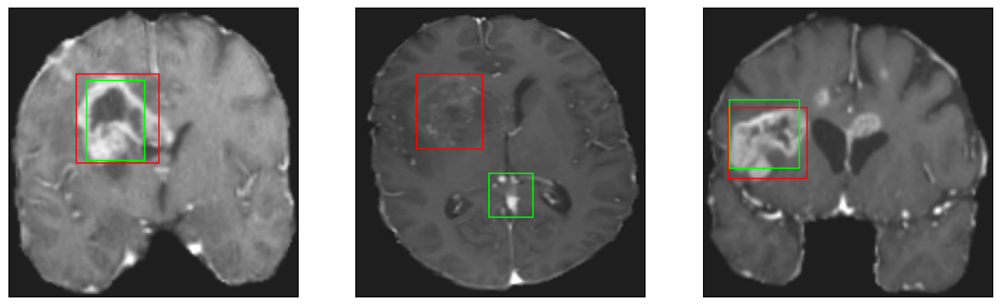

26/26 [==============================] - 3s 114ms/step - loss: 5.9680 - IoU: 0.5646 - val_loss: 8.6636 - val_IoU: 0.5065
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 5.7402 - IoU: 0.5806
Epoch 44: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


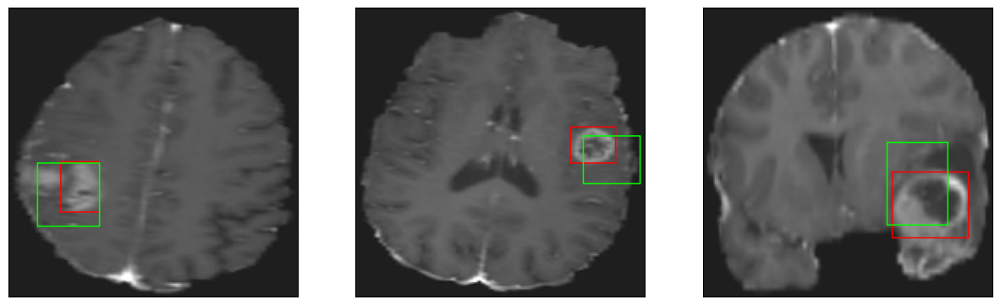

26/26 [==============================] - 3s 114ms/step - loss: 5.7402 - IoU: 0.5806 - val_loss: 8.9597 - val_IoU: 0.5153
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 6.2213 - IoU: 0.5505
Epoch 45: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


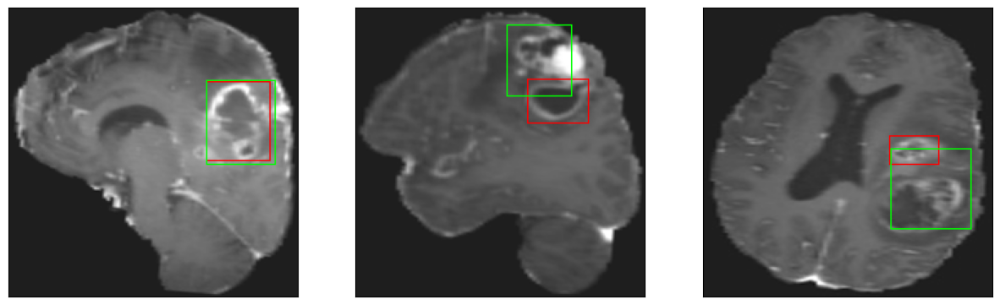

26/26 [==============================] - 3s 117ms/step - loss: 6.2213 - IoU: 0.5505 - val_loss: 10.0878 - val_IoU: 0.4397
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 5.9675 - IoU: 0.5649
Epoch 46: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


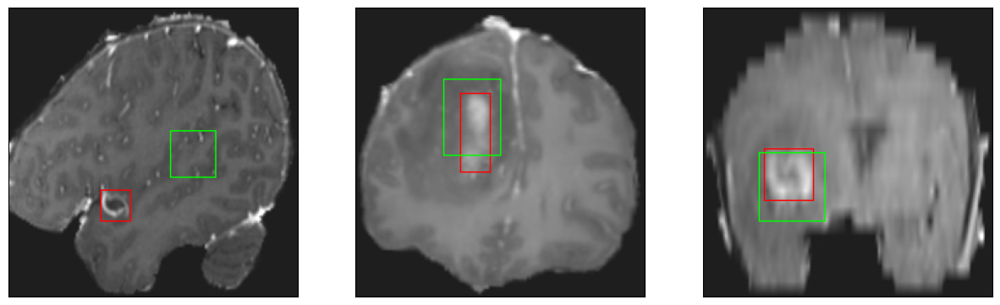

26/26 [==============================] - 3s 101ms/step - loss: 5.9675 - IoU: 0.5649 - val_loss: 9.1538 - val_IoU: 0.4748
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 5.7327 - IoU: 0.5817
Epoch 47: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


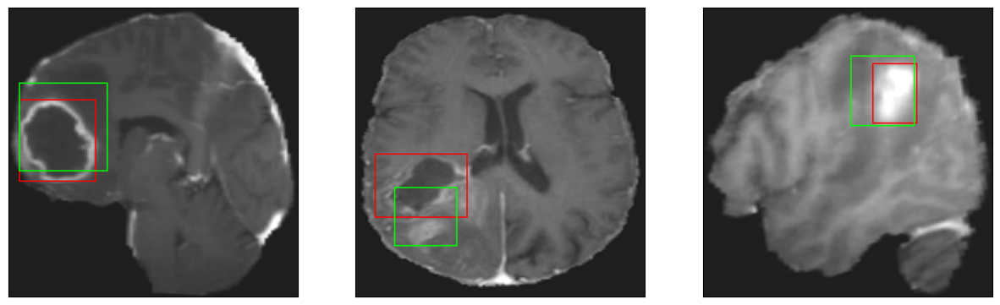

26/26 [==============================] - 3s 104ms/step - loss: 5.7639 - IoU: 0.5803 - val_loss: 9.9621 - val_IoU: 0.4374
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 5.6756 - IoU: 0.5774
Epoch 48: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


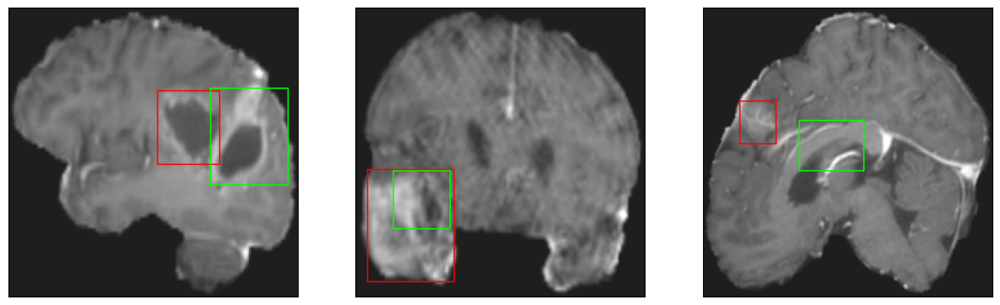

26/26 [==============================] - 3s 125ms/step - loss: 5.6756 - IoU: 0.5774 - val_loss: 8.8252 - val_IoU: 0.5008
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8010 - IoU: 0.5773
Epoch 49: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


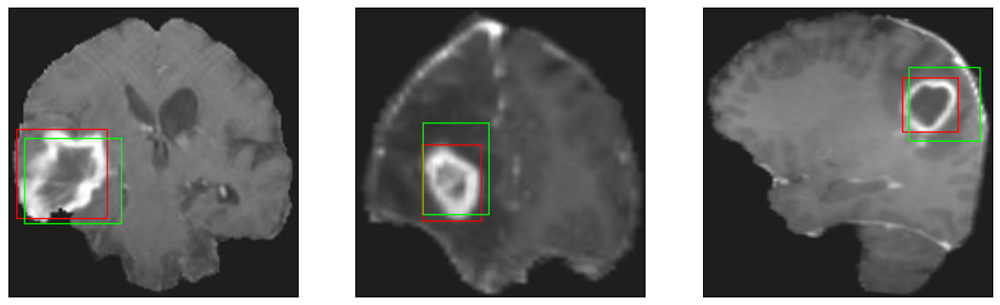

26/26 [==============================] - 3s 110ms/step - loss: 5.8553 - IoU: 0.5770 - val_loss: 10.4357 - val_IoU: 0.4561
Epoch 50/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8054 - IoU: 0.5815
Epoch 50: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


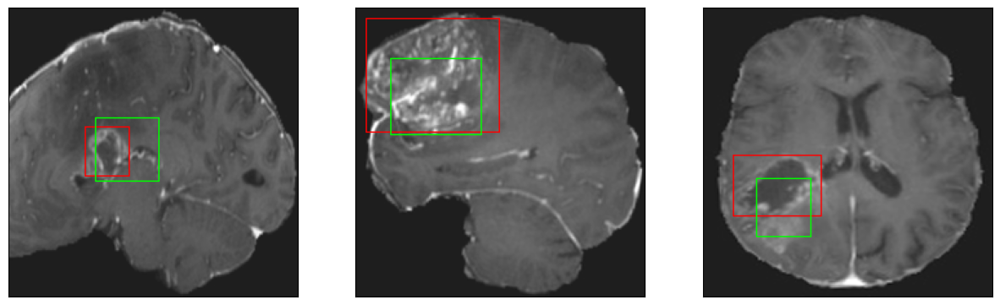

26/26 [==============================] - 3s 105ms/step - loss: 5.7751 - IoU: 0.5826 - val_loss: 9.0385 - val_IoU: 0.4924
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 5.7203 - IoU: 0.5767
Epoch 51: val_IoU did not improve from 0.51757
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


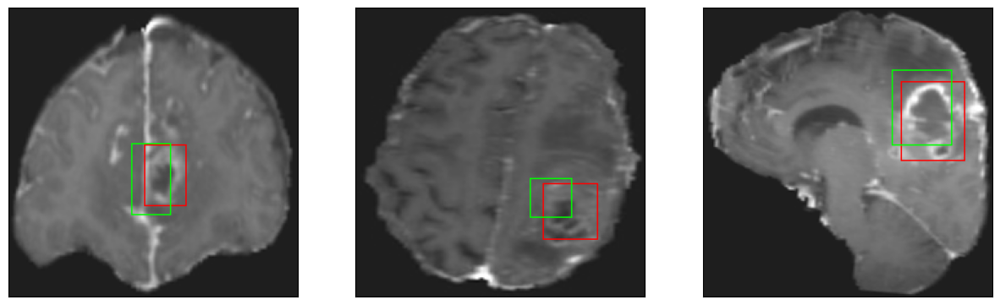

26/26 [==============================] - 3s 104ms/step - loss: 5.7203 - IoU: 0.5767 - val_loss: 8.9090 - val_IoU: 0.4938
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 5.6016 - IoU: 0.5903
Epoch 52: val_IoU improved from 0.51757 to 0.52063, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


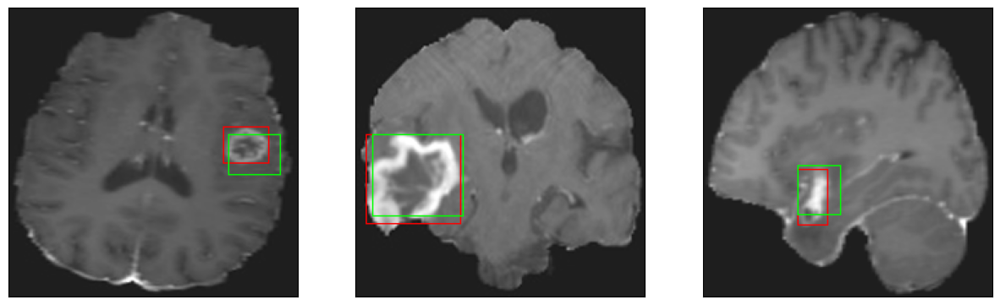

26/26 [==============================] - 4s 165ms/step - loss: 5.6016 - IoU: 0.5903 - val_loss: 8.4333 - val_IoU: 0.5206
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0894 - IoU: 0.5627
Epoch 53: val_IoU did not improve from 0.52063
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


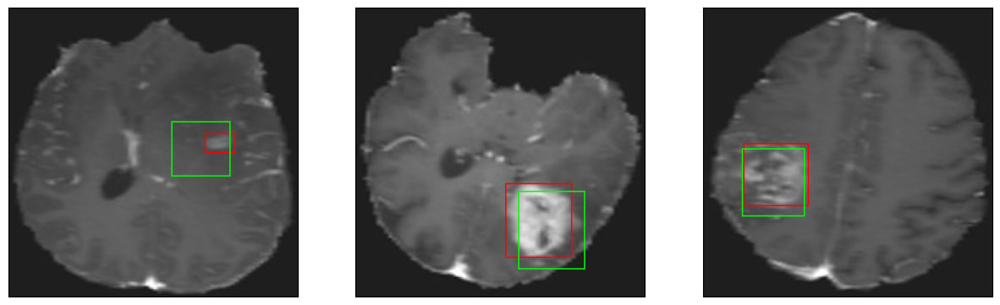

26/26 [==============================] - 3s 122ms/step - loss: 6.0354 - IoU: 0.5651 - val_loss: 10.3604 - val_IoU: 0.4238
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.5824 - IoU: 0.5898
Epoch 54: val_IoU did not improve from 0.52063
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


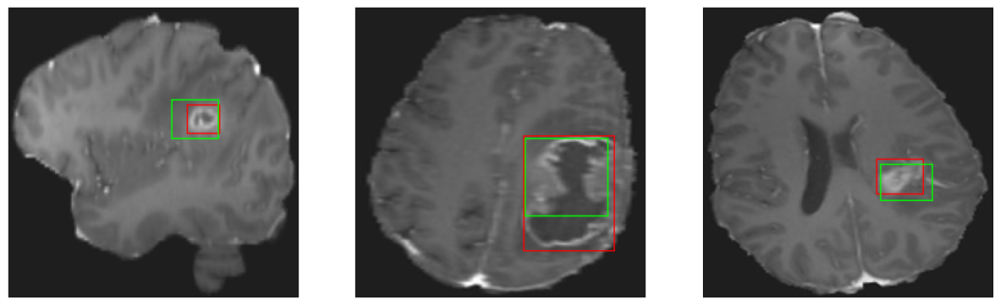

26/26 [==============================] - 3s 112ms/step - loss: 5.5824 - IoU: 0.5898 - val_loss: 10.6578 - val_IoU: 0.4613
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3912 - IoU: 0.5970
Epoch 55: val_IoU did not improve from 0.52063
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


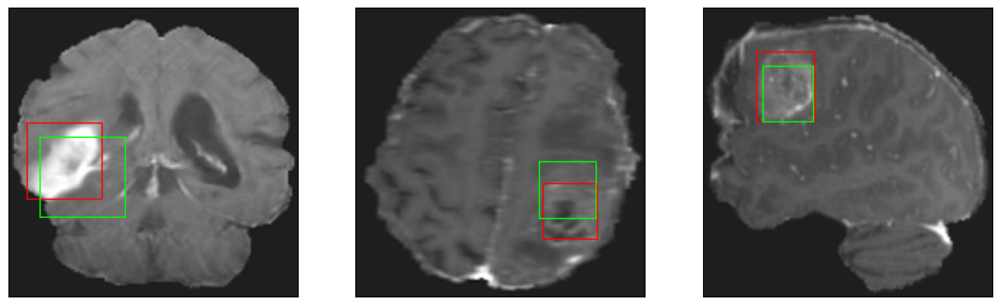

26/26 [==============================] - 3s 101ms/step - loss: 5.4041 - IoU: 0.5966 - val_loss: 9.6874 - val_IoU: 0.4774
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4853 - IoU: 0.5995
Epoch 56: val_IoU did not improve from 0.52063
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


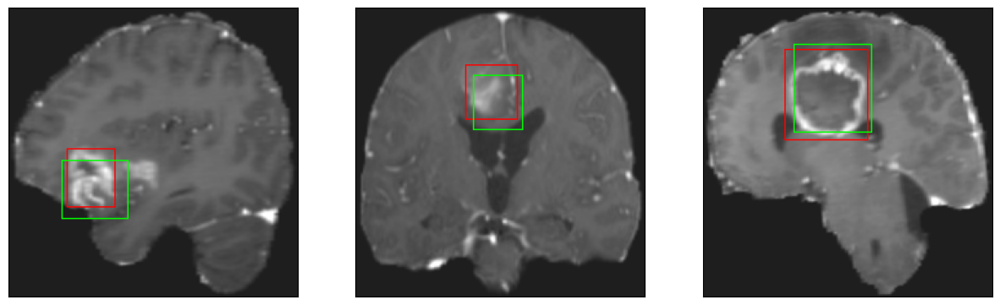

26/26 [==============================] - 3s 115ms/step - loss: 5.4801 - IoU: 0.6008 - val_loss: 8.8076 - val_IoU: 0.5102
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 5.7774 - IoU: 0.5779
Epoch 57: val_IoU improved from 0.52063 to 0.53357, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


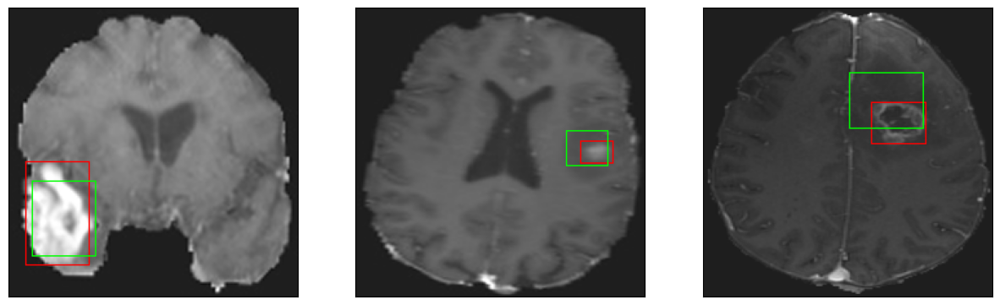

26/26 [==============================] - 4s 157ms/step - loss: 5.7774 - IoU: 0.5779 - val_loss: 8.3900 - val_IoU: 0.5336
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.5103 - IoU: 0.5910
Epoch 58: val_IoU did not improve from 0.53357
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


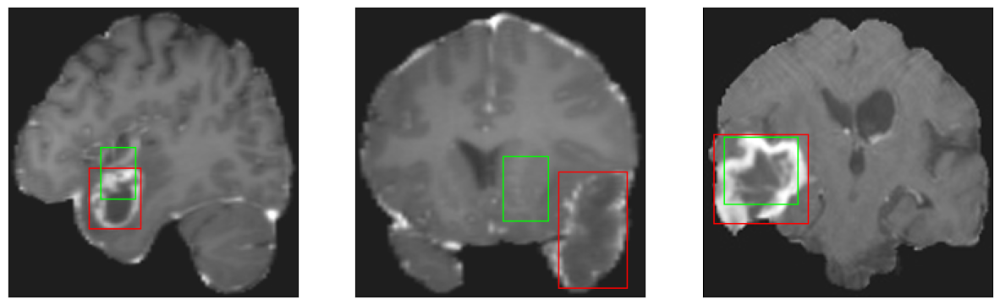

26/26 [==============================] - 3s 116ms/step - loss: 5.5103 - IoU: 0.5910 - val_loss: 11.5388 - val_IoU: 0.3892
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 5.5497 - IoU: 0.5815
Epoch 59: val_IoU did not improve from 0.53357
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


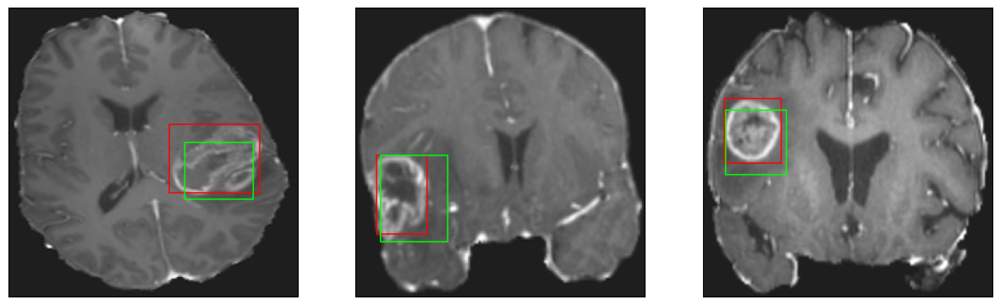

26/26 [==============================] - 3s 120ms/step - loss: 5.5497 - IoU: 0.5815 - val_loss: 9.6171 - val_IoU: 0.4703
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 5.6825 - IoU: 0.5877
Epoch 60: val_IoU did not improve from 0.53357
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


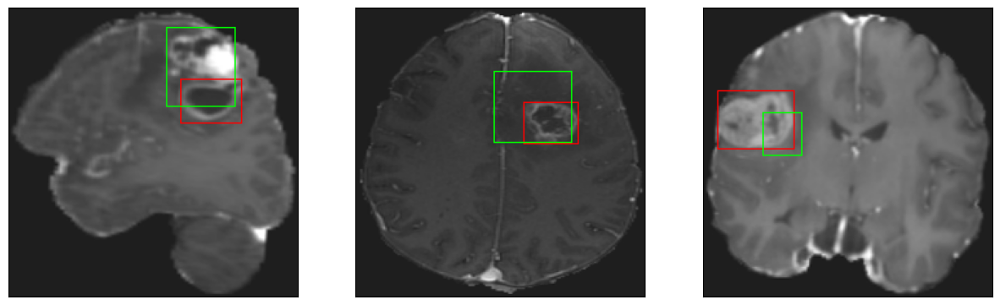

26/26 [==============================] - 3s 118ms/step - loss: 5.6825 - IoU: 0.5877 - val_loss: 8.9929 - val_IoU: 0.4898
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3374 - IoU: 0.5998
Epoch 61: val_IoU did not improve from 0.53357
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


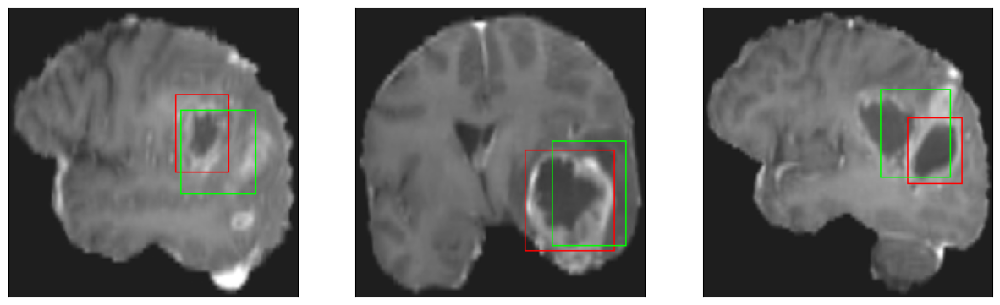

26/26 [==============================] - 3s 130ms/step - loss: 5.3025 - IoU: 0.6011 - val_loss: 8.5225 - val_IoU: 0.5173
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 5.4229 - IoU: 0.5992
Epoch 62: val_IoU improved from 0.53357 to 0.54559, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


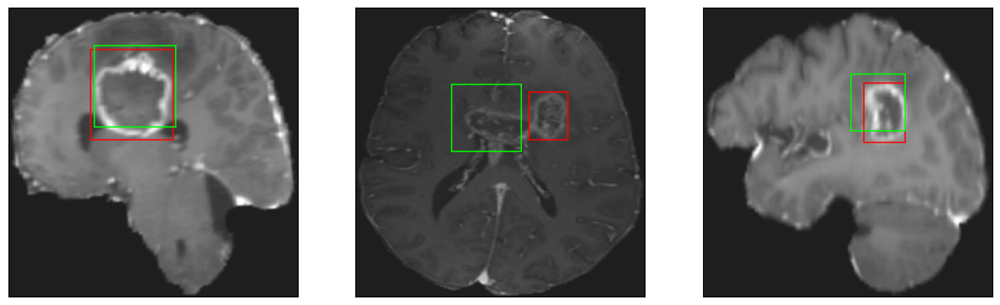

26/26 [==============================] - 4s 157ms/step - loss: 5.4229 - IoU: 0.5992 - val_loss: 8.1179 - val_IoU: 0.5456
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6539 - IoU: 0.5837
Epoch 63: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


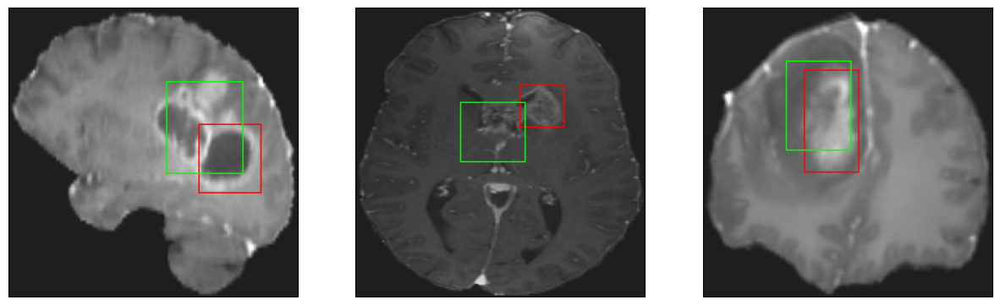

26/26 [==============================] - 3s 102ms/step - loss: 5.6579 - IoU: 0.5844 - val_loss: 8.7104 - val_IoU: 0.5390
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3081 - IoU: 0.6023
Epoch 64: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


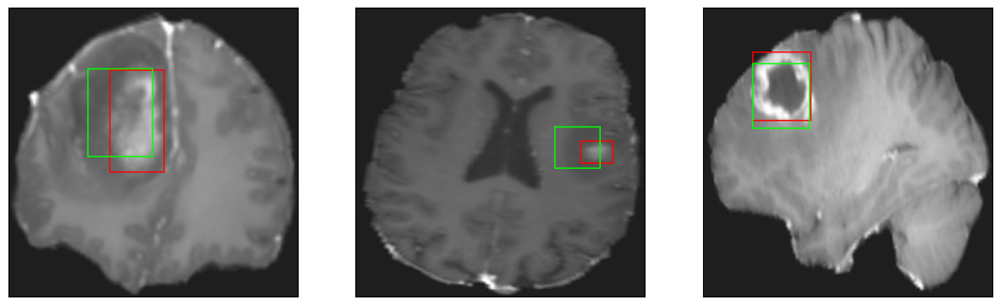

26/26 [==============================] - 3s 118ms/step - loss: 5.3113 - IoU: 0.6011 - val_loss: 8.5794 - val_IoU: 0.5321
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4083 - IoU: 0.5914
Epoch 65: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


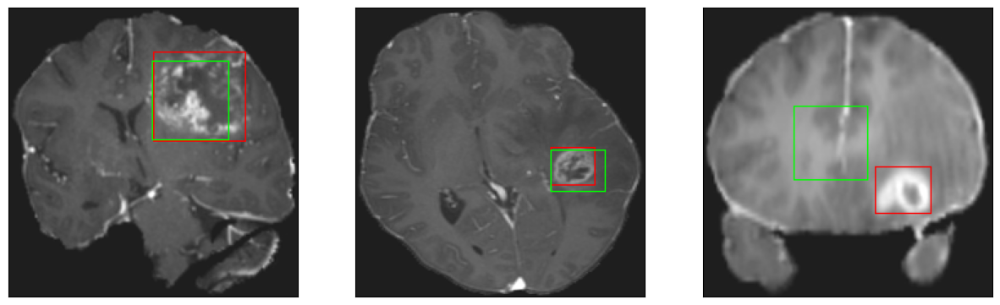

26/26 [==============================] - 3s 104ms/step - loss: 5.4243 - IoU: 0.5918 - val_loss: 12.8934 - val_IoU: 0.3559
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1794 - IoU: 0.6085
Epoch 66: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


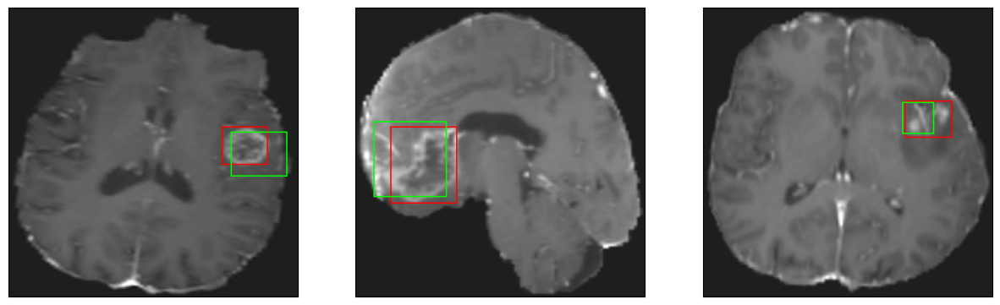

26/26 [==============================] - 3s 110ms/step - loss: 5.1754 - IoU: 0.6092 - val_loss: 8.6646 - val_IoU: 0.5250
Epoch 67/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0469 - IoU: 0.6221
Epoch 67: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


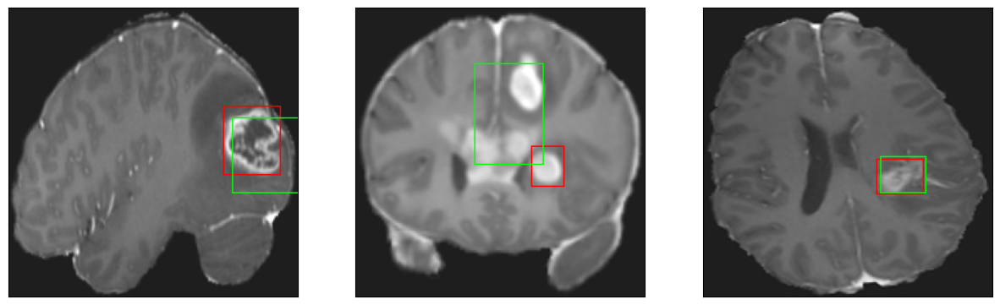

26/26 [==============================] - 3s 99ms/step - loss: 5.0811 - IoU: 0.6197 - val_loss: 9.3898 - val_IoU: 0.4989
Epoch 68/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9499 - IoU: 0.6238
Epoch 68: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


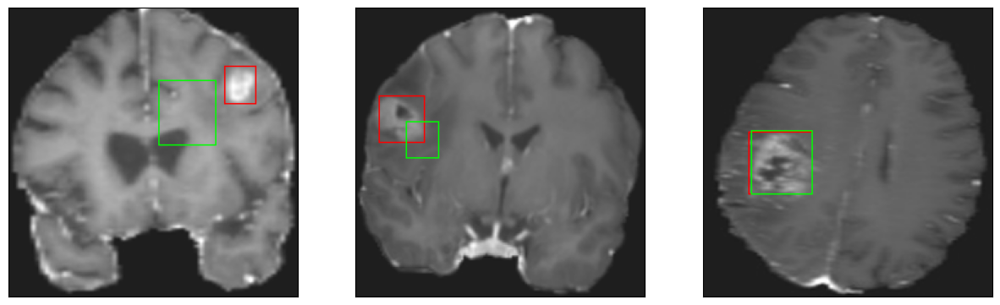

26/26 [==============================] - 3s 126ms/step - loss: 4.9791 - IoU: 0.6219 - val_loss: 9.4366 - val_IoU: 0.4895
Epoch 69/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1641 - IoU: 0.6052
Epoch 69: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


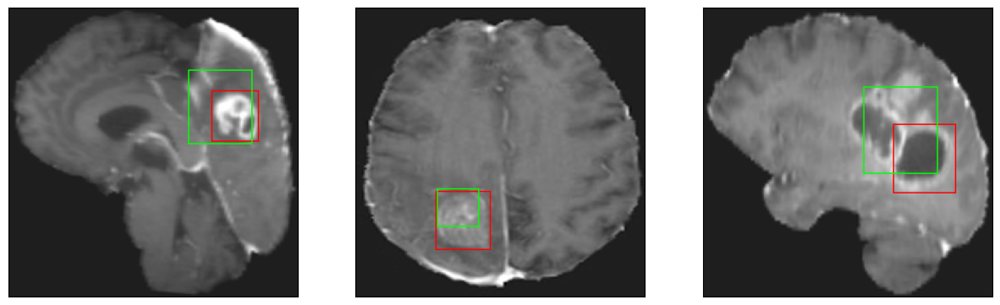

26/26 [==============================] - 3s 101ms/step - loss: 5.2230 - IoU: 0.6056 - val_loss: 9.0118 - val_IoU: 0.5018
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 5.4581 - IoU: 0.5985
Epoch 70: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


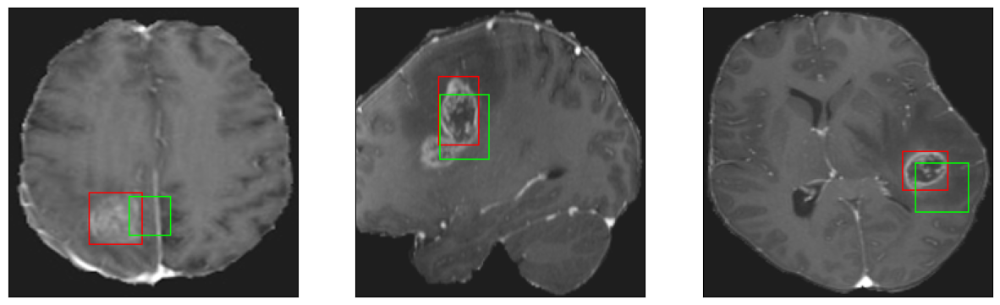

26/26 [==============================] - 3s 100ms/step - loss: 5.4581 - IoU: 0.5985 - val_loss: 9.3439 - val_IoU: 0.4561
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4353 - IoU: 0.6056
Epoch 71: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


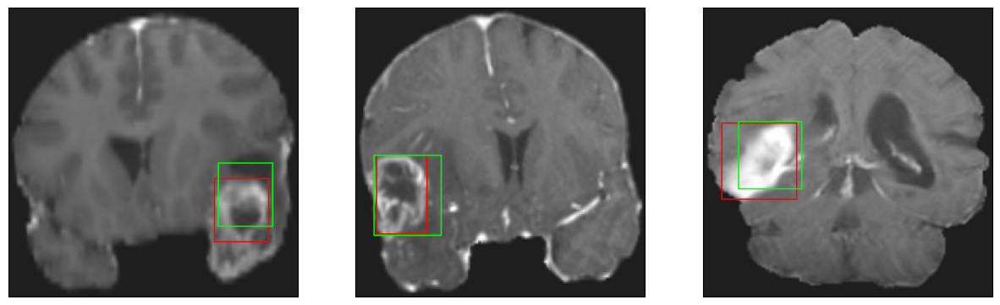

26/26 [==============================] - 2s 96ms/step - loss: 5.4030 - IoU: 0.6051 - val_loss: 8.2476 - val_IoU: 0.5375
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1950 - IoU: 0.6097
Epoch 72: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


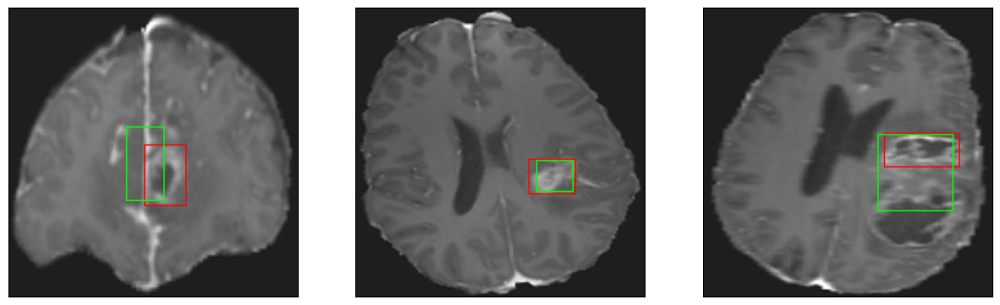

26/26 [==============================] - 3s 105ms/step - loss: 5.1923 - IoU: 0.6070 - val_loss: 8.4325 - val_IoU: 0.5273
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 5.1339 - IoU: 0.5999
Epoch 73: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


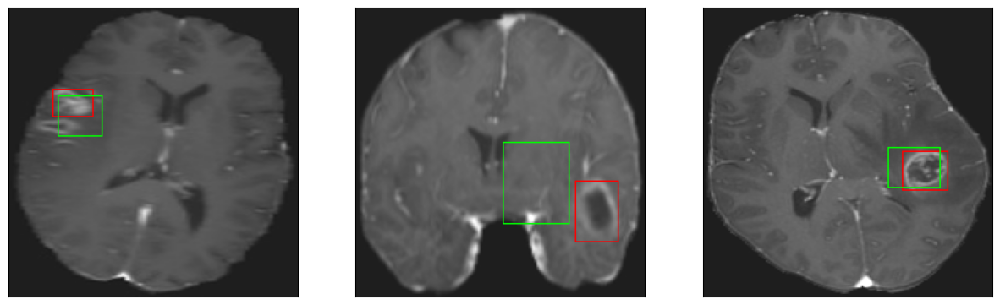

26/26 [==============================] - 3s 122ms/step - loss: 5.1339 - IoU: 0.5999 - val_loss: 10.9454 - val_IoU: 0.4137
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.1786 - IoU: 0.6015
Epoch 74: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


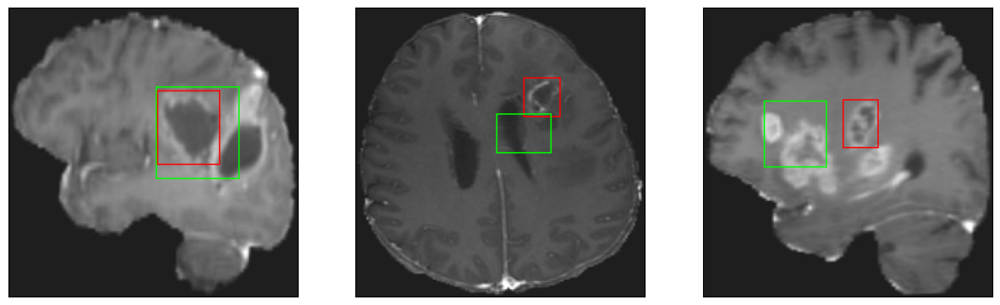

26/26 [==============================] - 3s 131ms/step - loss: 5.1786 - IoU: 0.6015 - val_loss: 10.4764 - val_IoU: 0.4603
Epoch 75/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2628 - IoU: 0.5981
Epoch 75: val_IoU did not improve from 0.54559
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


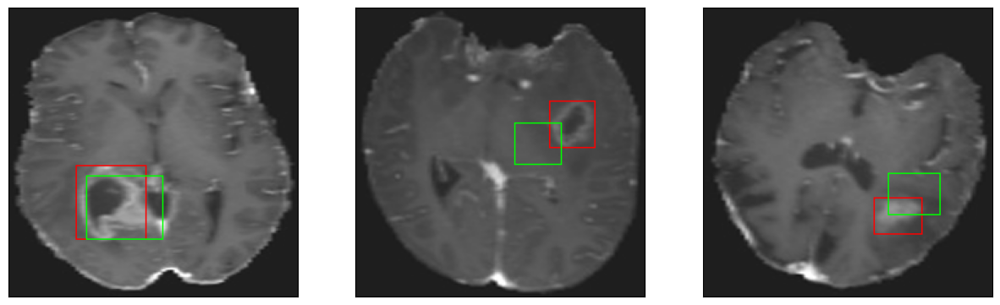

26/26 [==============================] - 3s 98ms/step - loss: 5.2406 - IoU: 0.5985 - val_loss: 10.1687 - val_IoU: 0.4586
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2023 - IoU: 0.6043
Epoch 76: val_IoU improved from 0.54559 to 0.54664, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


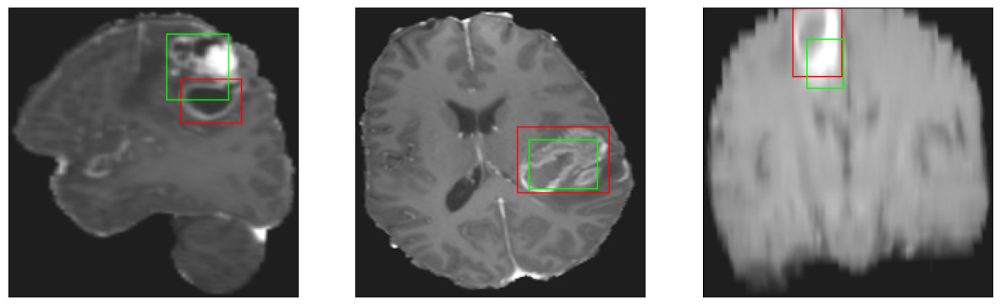

26/26 [==============================] - 4s 152ms/step - loss: 5.1918 - IoU: 0.6043 - val_loss: 8.0317 - val_IoU: 0.5466
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 5.0672 - IoU: 0.6081
Epoch 77: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


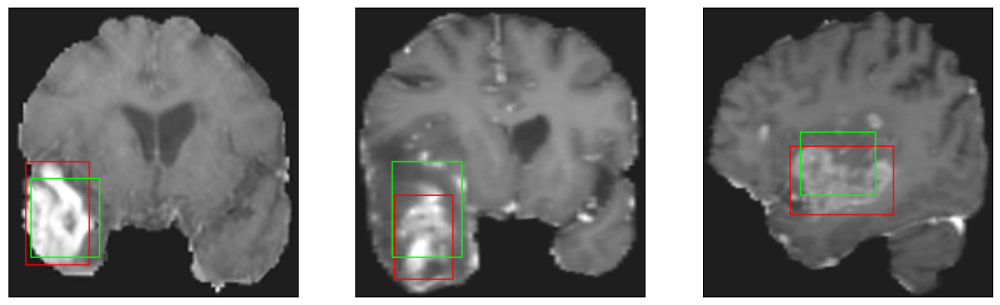

26/26 [==============================] - 3s 131ms/step - loss: 5.0672 - IoU: 0.6081 - val_loss: 9.9160 - val_IoU: 0.4760
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0193 - IoU: 0.6202
Epoch 78: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


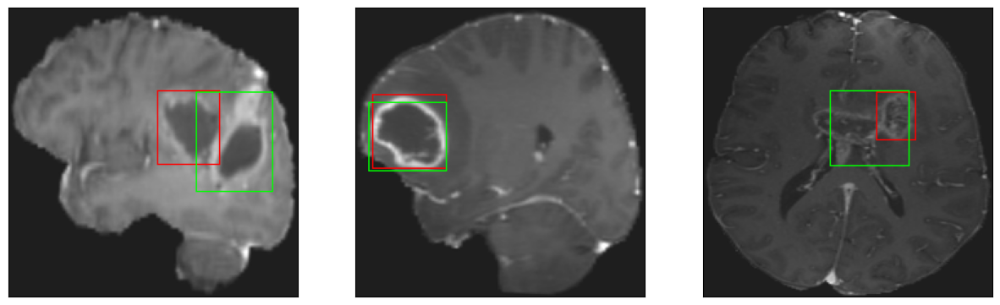

26/26 [==============================] - 3s 112ms/step - loss: 4.9858 - IoU: 0.6213 - val_loss: 8.4218 - val_IoU: 0.5289
Epoch 79/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9256 - IoU: 0.6208
Epoch 79: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


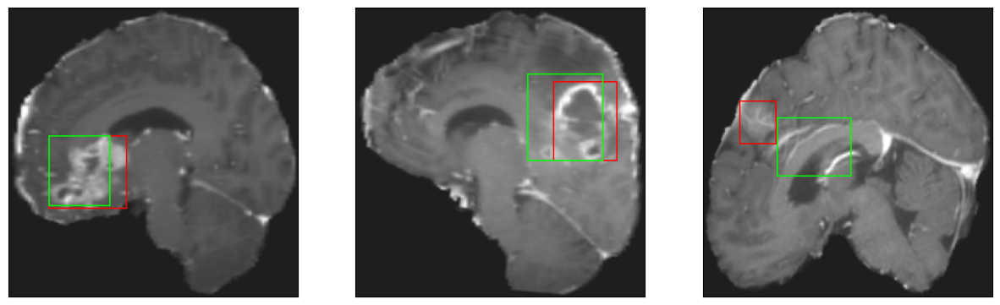

26/26 [==============================] - 3s 111ms/step - loss: 4.9946 - IoU: 0.6162 - val_loss: 9.5396 - val_IoU: 0.4720
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 5.0689 - IoU: 0.6185
Epoch 80: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


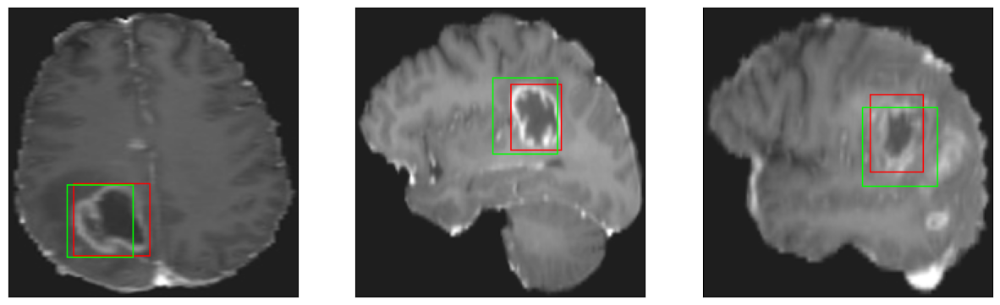

26/26 [==============================] - 3s 116ms/step - loss: 5.0689 - IoU: 0.6185 - val_loss: 8.2965 - val_IoU: 0.5389
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8614 - IoU: 0.6353
Epoch 81: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


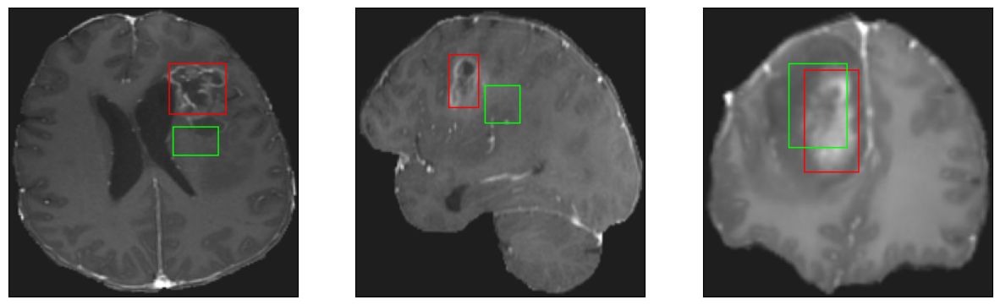

26/26 [==============================] - 3s 126ms/step - loss: 4.8490 - IoU: 0.6346 - val_loss: 8.7557 - val_IoU: 0.5001
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 4.9633 - IoU: 0.6227
Epoch 82: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


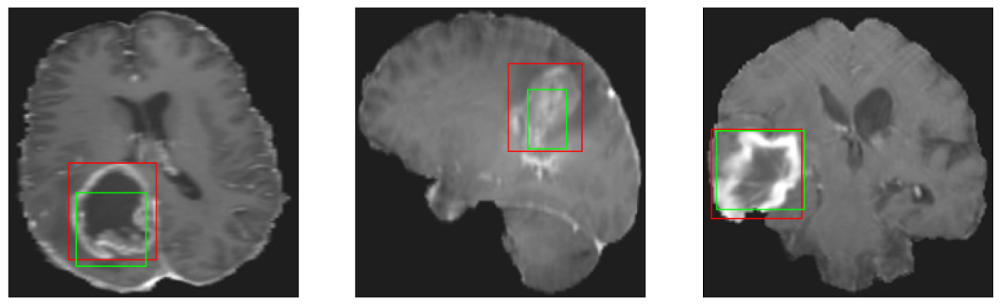

26/26 [==============================] - 3s 112ms/step - loss: 4.9633 - IoU: 0.6227 - val_loss: 8.9263 - val_IoU: 0.5042
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1357 - IoU: 0.6108
Epoch 83: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


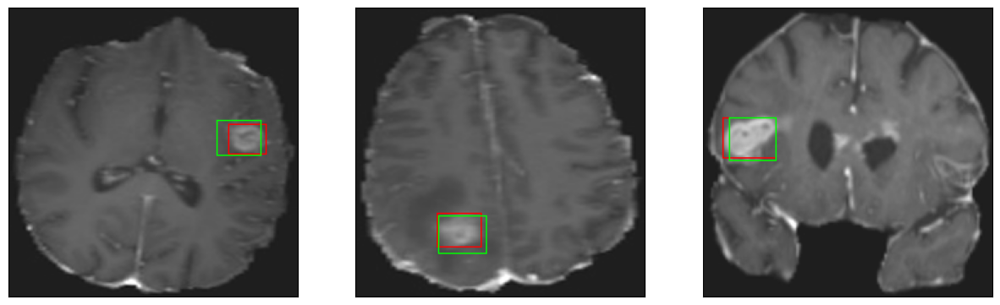

26/26 [==============================] - 3s 109ms/step - loss: 5.1928 - IoU: 0.6086 - val_loss: 8.5823 - val_IoU: 0.5296
Epoch 84/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9959 - IoU: 0.6083
Epoch 84: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


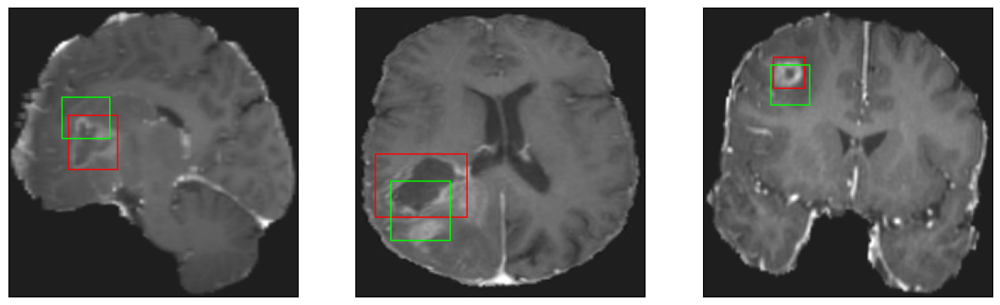

26/26 [==============================] - 3s 121ms/step - loss: 4.9787 - IoU: 0.6083 - val_loss: 8.3560 - val_IoU: 0.5356
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9685 - IoU: 0.6187
Epoch 85: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


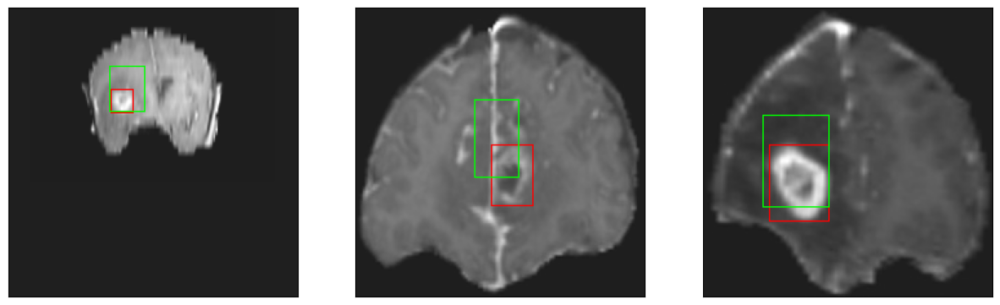

26/26 [==============================] - 3s 105ms/step - loss: 4.9725 - IoU: 0.6170 - val_loss: 10.4009 - val_IoU: 0.4346
Epoch 86/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8551 - IoU: 0.6210
Epoch 86: val_IoU did not improve from 0.54664
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


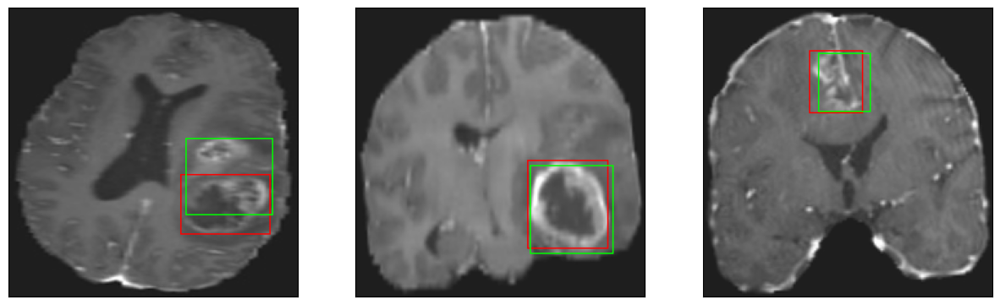

26/26 [==============================] - 3s 98ms/step - loss: 4.8763 - IoU: 0.6199 - val_loss: 8.8092 - val_IoU: 0.5256
Epoch 87/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8140 - IoU: 0.6215
Epoch 87: val_IoU improved from 0.54664 to 0.55263, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


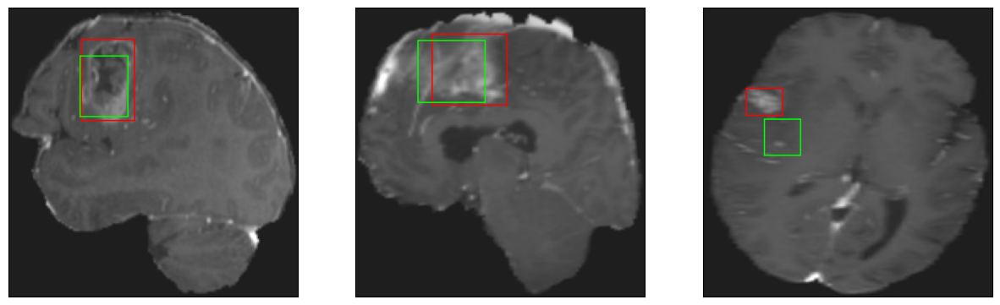

26/26 [==============================] - 4s 170ms/step - loss: 4.8298 - IoU: 0.6210 - val_loss: 8.2116 - val_IoU: 0.5526
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 4.8275 - IoU: 0.6238
Epoch 88: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


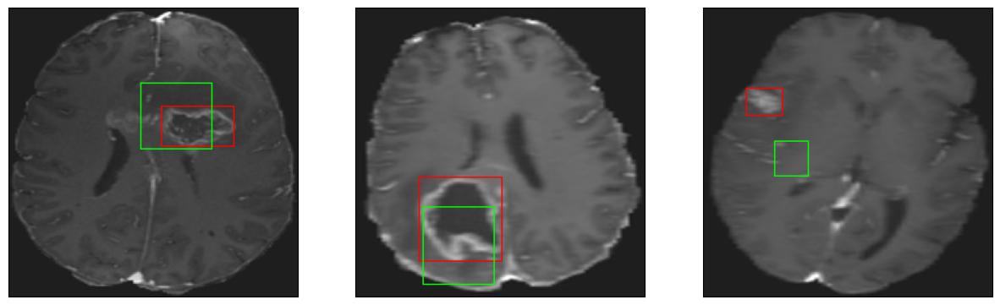

26/26 [==============================] - 3s 106ms/step - loss: 4.8275 - IoU: 0.6238 - val_loss: 8.8779 - val_IoU: 0.5190
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7162 - IoU: 0.6334
Epoch 89: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


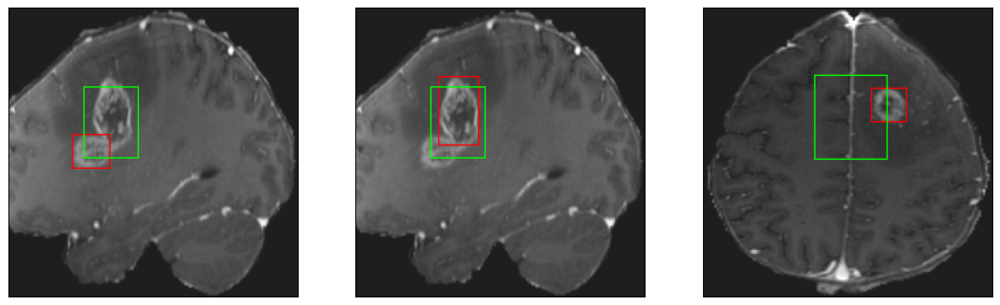

26/26 [==============================] - 3s 104ms/step - loss: 4.7120 - IoU: 0.6324 - val_loss: 8.6968 - val_IoU: 0.5208
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 4.7397 - IoU: 0.6328
Epoch 90: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


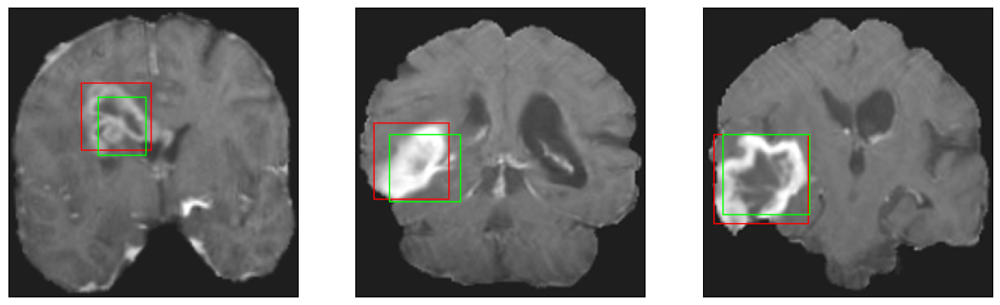

26/26 [==============================] - 3s 119ms/step - loss: 4.7397 - IoU: 0.6328 - val_loss: 9.2550 - val_IoU: 0.4884
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 4.8851 - IoU: 0.6154
Epoch 91: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


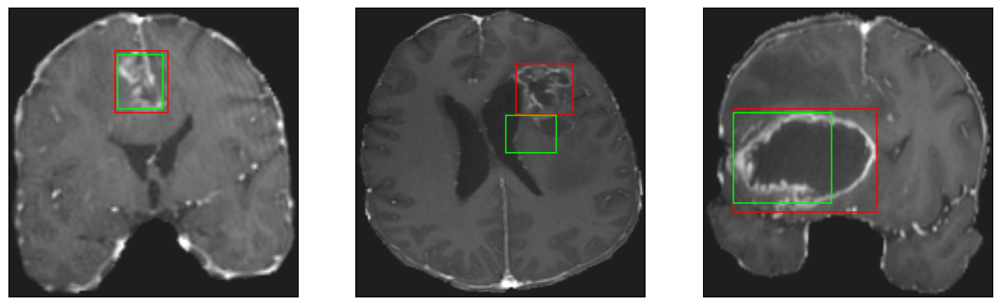

26/26 [==============================] - 3s 102ms/step - loss: 4.8851 - IoU: 0.6154 - val_loss: 8.2433 - val_IoU: 0.5412
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9444 - IoU: 0.6138
Epoch 92: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


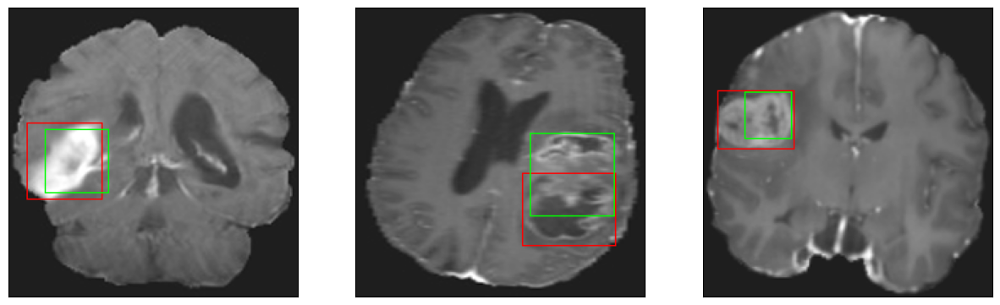

26/26 [==============================] - 3s 111ms/step - loss: 4.9029 - IoU: 0.6159 - val_loss: 8.2452 - val_IoU: 0.5391
Epoch 93/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8749 - IoU: 0.6264
Epoch 93: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


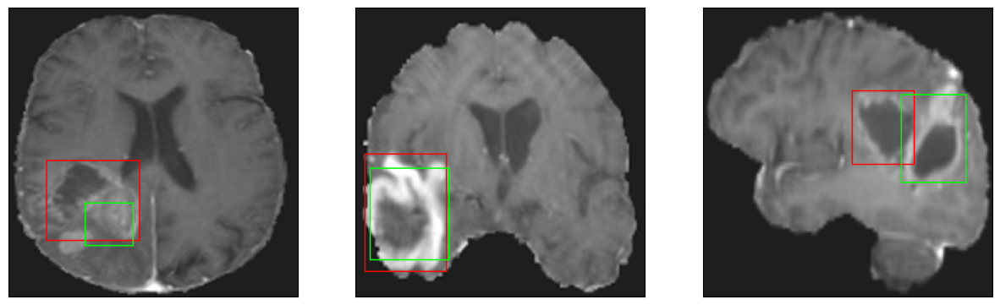

26/26 [==============================] - 3s 125ms/step - loss: 4.8354 - IoU: 0.6273 - val_loss: 9.0719 - val_IoU: 0.4895
Epoch 94/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9009 - IoU: 0.6194
Epoch 94: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


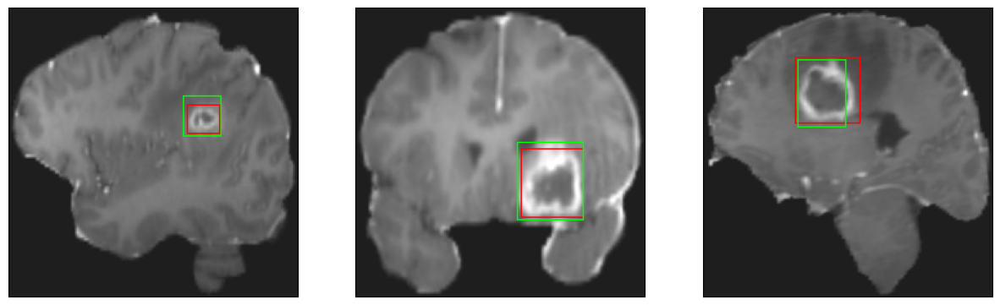

26/26 [==============================] - 3s 118ms/step - loss: 4.8810 - IoU: 0.6182 - val_loss: 8.6123 - val_IoU: 0.5177
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1451 - IoU: 0.6102
Epoch 95: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


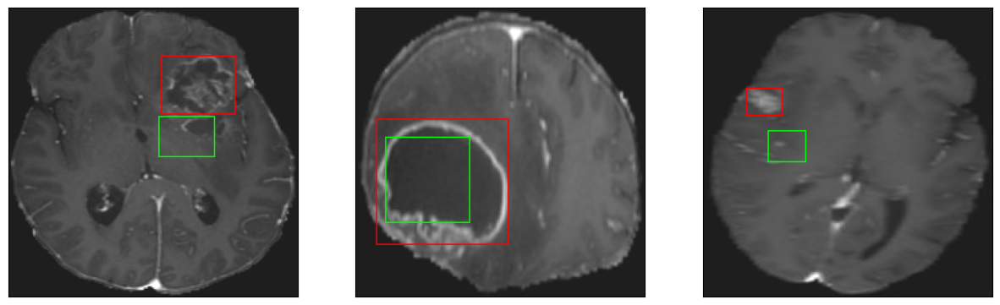

26/26 [==============================] - 3s 108ms/step - loss: 5.1059 - IoU: 0.6116 - val_loss: 9.5625 - val_IoU: 0.4710
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6189 - IoU: 0.6336
Epoch 96: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


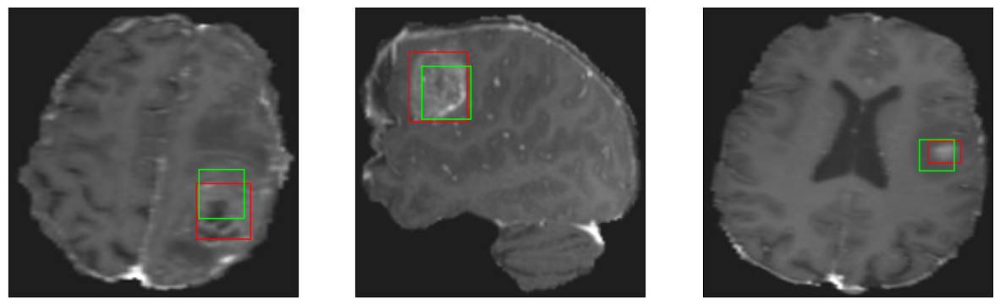

26/26 [==============================] - 2s 96ms/step - loss: 4.6831 - IoU: 0.6316 - val_loss: 9.3067 - val_IoU: 0.4869
Epoch 97/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8174 - IoU: 0.6267
Epoch 97: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


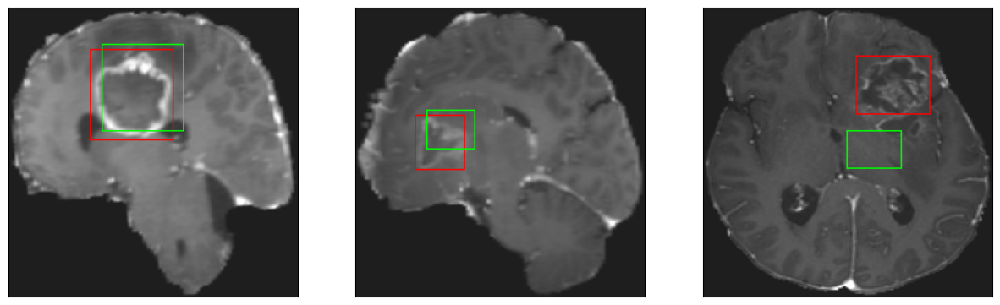

26/26 [==============================] - 3s 112ms/step - loss: 4.8324 - IoU: 0.6278 - val_loss: 8.8396 - val_IoU: 0.5139
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 4.7150 - IoU: 0.6337
Epoch 98: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


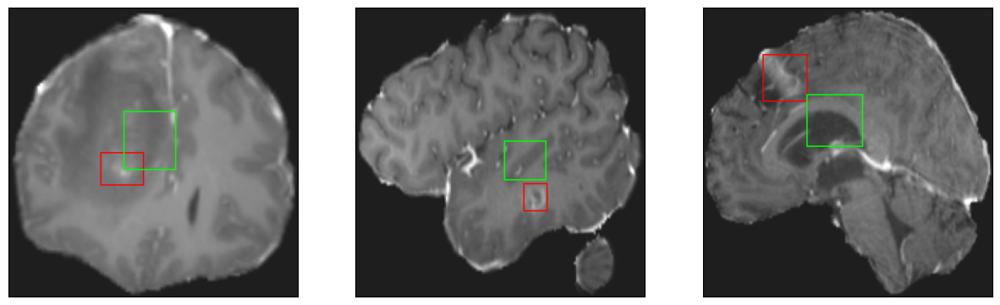

26/26 [==============================] - 3s 118ms/step - loss: 4.7150 - IoU: 0.6337 - val_loss: 8.3815 - val_IoU: 0.5310
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 4.6970 - IoU: 0.6292
Epoch 99: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


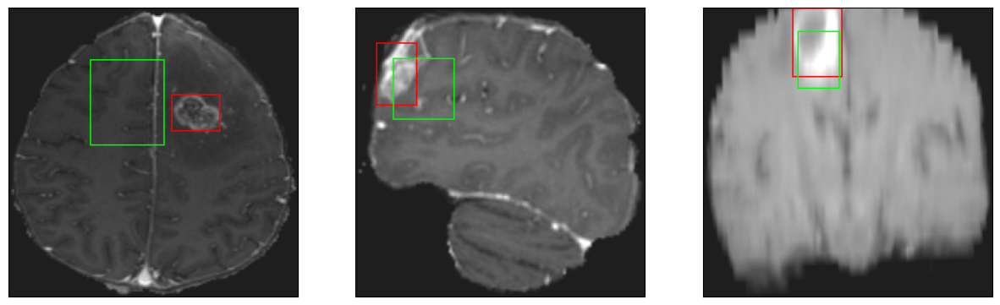

26/26 [==============================] - 3s 105ms/step - loss: 4.6970 - IoU: 0.6292 - val_loss: 8.3376 - val_IoU: 0.5286
Epoch 100/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6525 - IoU: 0.6312
Epoch 100: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


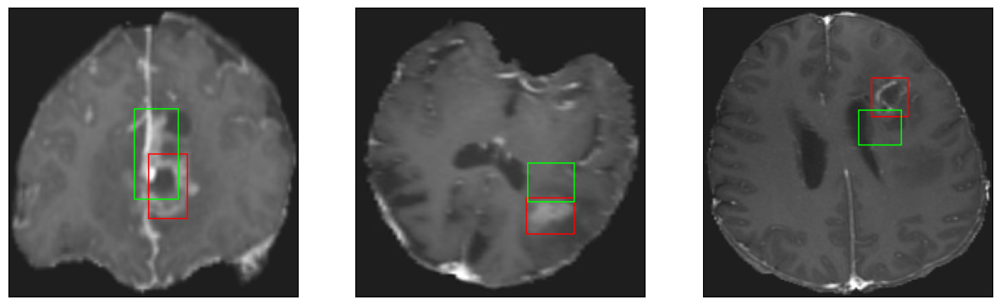

26/26 [==============================] - 3s 109ms/step - loss: 4.6728 - IoU: 0.6309 - val_loss: 8.2032 - val_IoU: 0.5463
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 4.7298 - IoU: 0.6342
Epoch 101: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


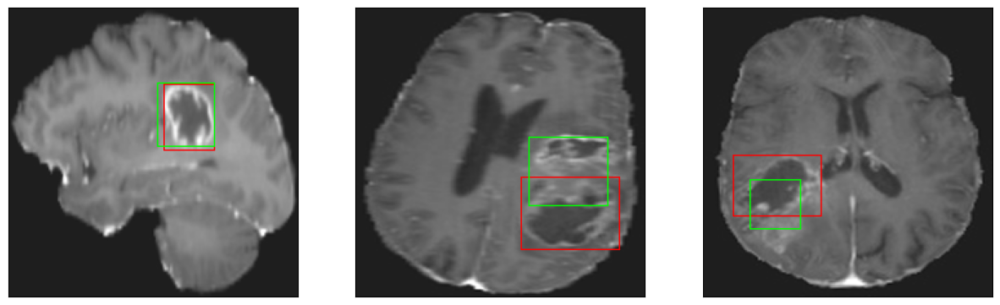

26/26 [==============================] - 3s 121ms/step - loss: 4.7298 - IoU: 0.6342 - val_loss: 8.7018 - val_IoU: 0.5268
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6908 - IoU: 0.6340
Epoch 102: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


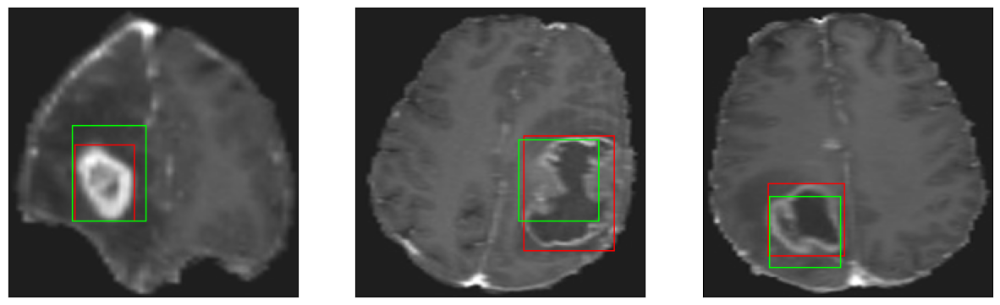

26/26 [==============================] - 3s 129ms/step - loss: 4.6583 - IoU: 0.6362 - val_loss: 9.5054 - val_IoU: 0.5187
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 4.6722 - IoU: 0.6363
Epoch 103: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


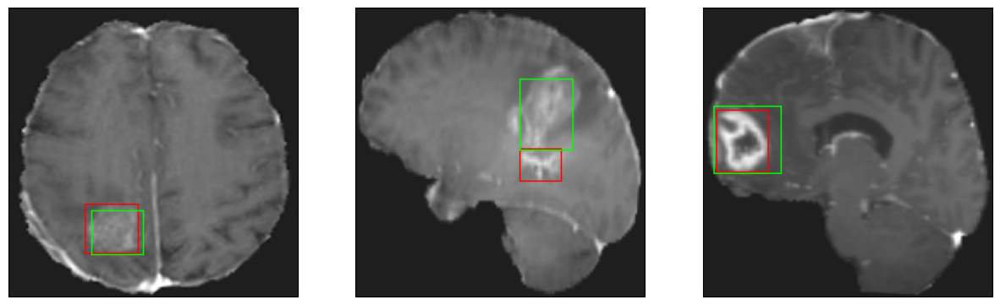

26/26 [==============================] - 3s 108ms/step - loss: 4.6722 - IoU: 0.6363 - val_loss: 8.7885 - val_IoU: 0.5395
Epoch 104/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8427 - IoU: 0.6304
Epoch 104: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


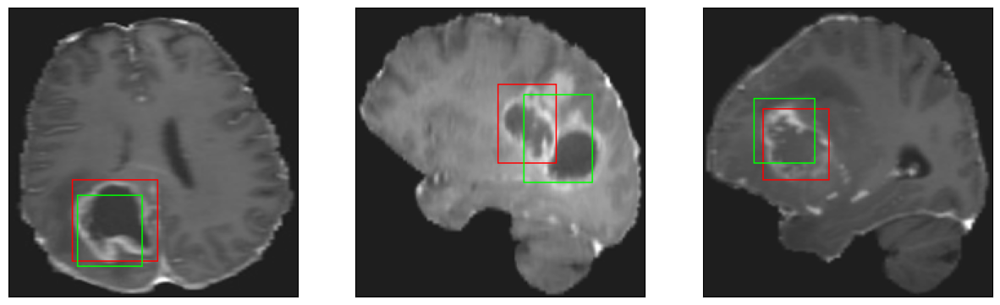

26/26 [==============================] - 3s 109ms/step - loss: 4.8601 - IoU: 0.6294 - val_loss: 8.4384 - val_IoU: 0.5370
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7403 - IoU: 0.6367
Epoch 105: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


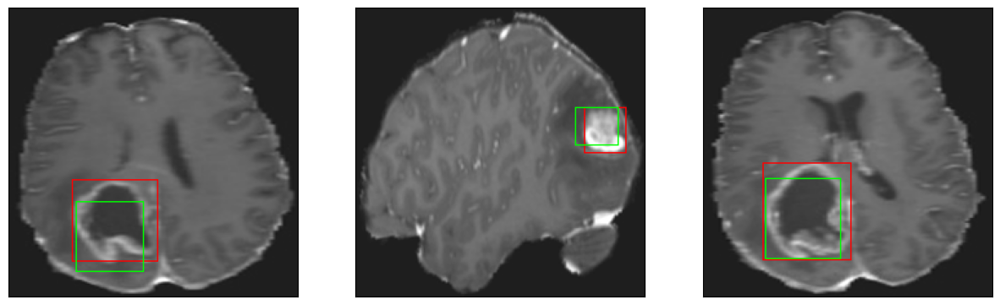

26/26 [==============================] - 4s 137ms/step - loss: 4.7235 - IoU: 0.6363 - val_loss: 9.5564 - val_IoU: 0.4794
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5573 - IoU: 0.6453
Epoch 106: val_IoU did not improve from 0.55263
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


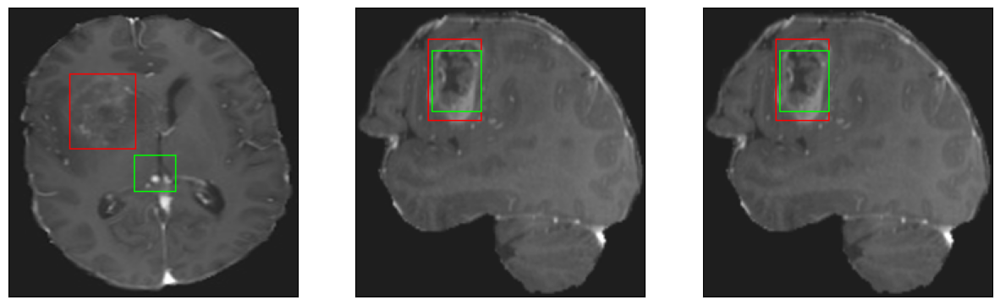

26/26 [==============================] - 3s 101ms/step - loss: 4.5196 - IoU: 0.6458 - val_loss: 9.4234 - val_IoU: 0.4935
Epoch 107/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6276 - IoU: 0.6292
Epoch 107: val_IoU improved from 0.55263 to 0.56197, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


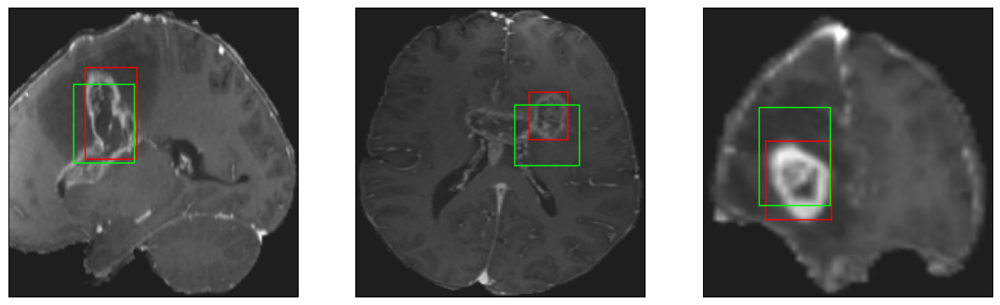

26/26 [==============================] - 4s 154ms/step - loss: 4.7131 - IoU: 0.6273 - val_loss: 8.1243 - val_IoU: 0.5620
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6313 - IoU: 0.6350
Epoch 108: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


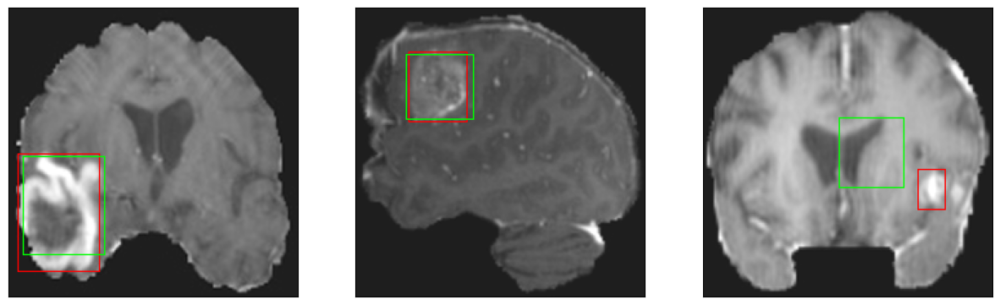

26/26 [==============================] - 3s 117ms/step - loss: 4.6224 - IoU: 0.6355 - val_loss: 8.3435 - val_IoU: 0.5484
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 4.4879 - IoU: 0.6423
Epoch 109: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


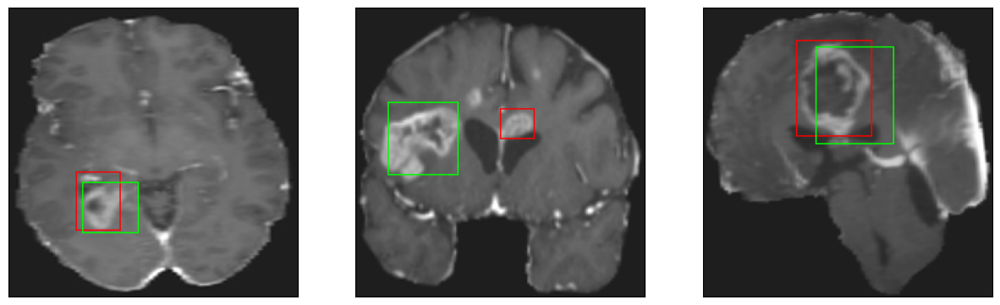

26/26 [==============================] - 3s 117ms/step - loss: 4.4879 - IoU: 0.6423 - val_loss: 8.3716 - val_IoU: 0.5454
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7866 - IoU: 0.6364
Epoch 110: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


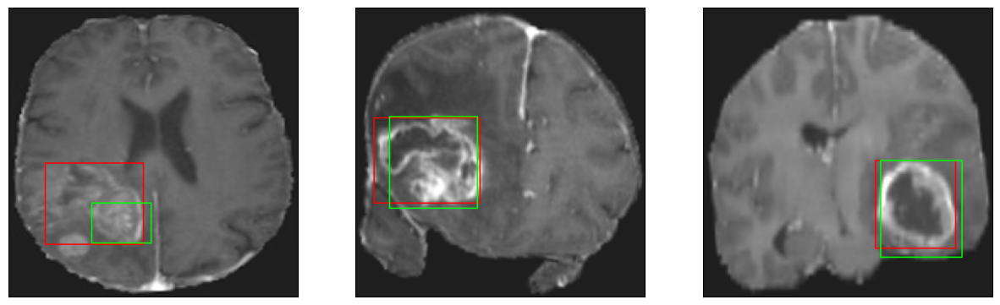

26/26 [==============================] - 3s 108ms/step - loss: 4.7352 - IoU: 0.6398 - val_loss: 8.0638 - val_IoU: 0.5587
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 4.4588 - IoU: 0.6451
Epoch 111: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


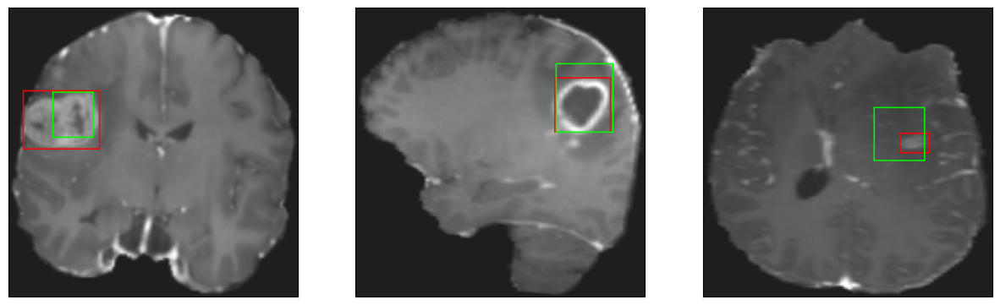

26/26 [==============================] - 3s 106ms/step - loss: 4.4588 - IoU: 0.6451 - val_loss: 8.5006 - val_IoU: 0.5326
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 4.7374 - IoU: 0.6298
Epoch 112: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


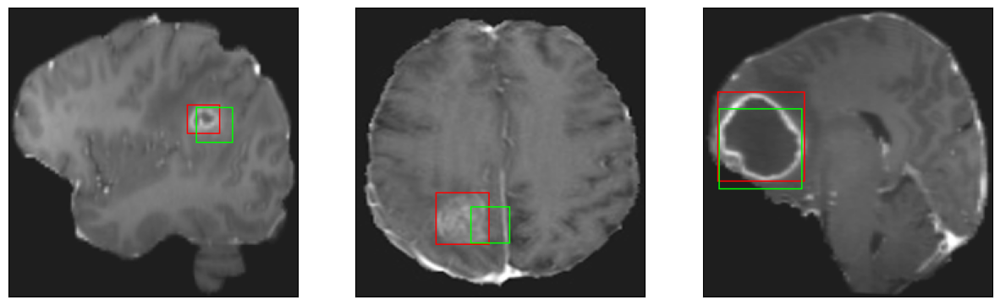

26/26 [==============================] - 3s 112ms/step - loss: 4.7374 - IoU: 0.6298 - val_loss: 8.4719 - val_IoU: 0.5241
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 4.8052 - IoU: 0.6327
Epoch 113: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


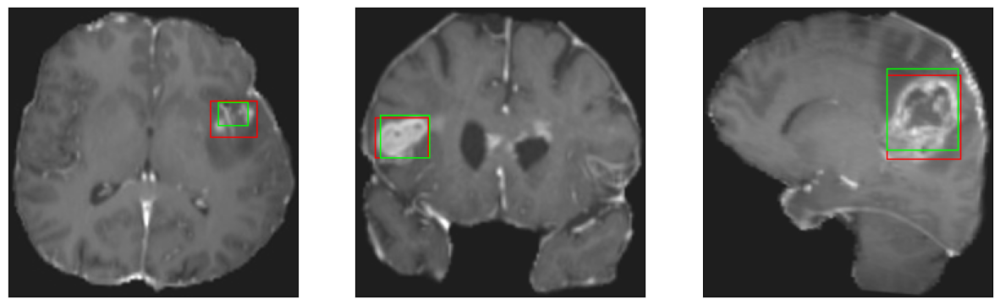

26/26 [==============================] - 3s 103ms/step - loss: 4.8052 - IoU: 0.6327 - val_loss: 8.4027 - val_IoU: 0.5376
Epoch 114/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5211 - IoU: 0.6417
Epoch 114: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


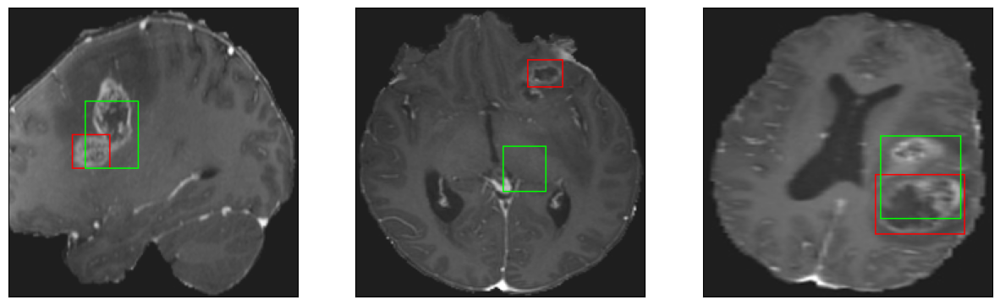

26/26 [==============================] - 3s 103ms/step - loss: 4.5426 - IoU: 0.6405 - val_loss: 8.9497 - val_IoU: 0.5002
Epoch 115/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7071 - IoU: 0.6332
Epoch 115: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


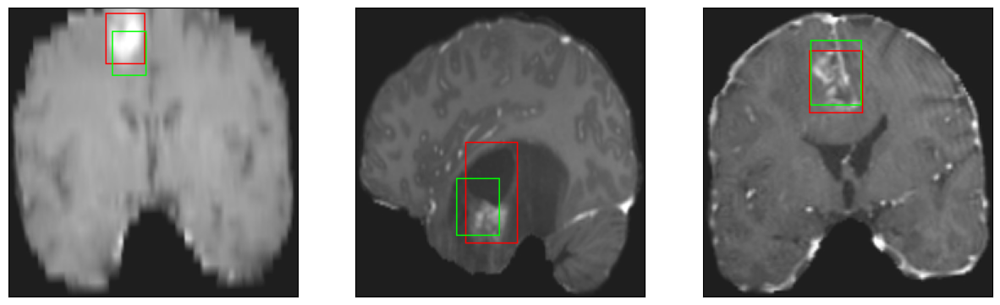

26/26 [==============================] - 3s 133ms/step - loss: 4.6720 - IoU: 0.6322 - val_loss: 9.8408 - val_IoU: 0.4542
Epoch 116/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8142 - IoU: 0.6259
Epoch 116: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


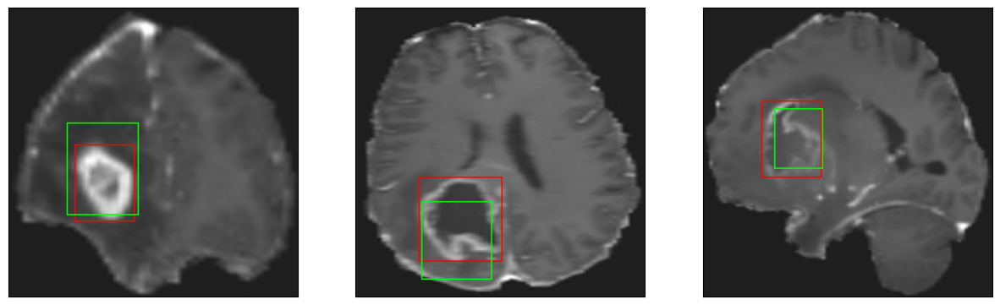

26/26 [==============================] - 3s 101ms/step - loss: 4.8833 - IoU: 0.6230 - val_loss: 9.1936 - val_IoU: 0.5006
Epoch 117/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7786 - IoU: 0.6258
Epoch 117: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


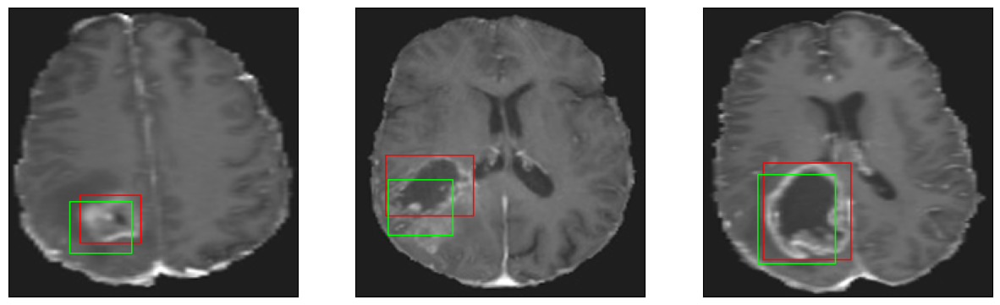

26/26 [==============================] - 3s 103ms/step - loss: 4.7286 - IoU: 0.6283 - val_loss: 8.1114 - val_IoU: 0.5534
Epoch 118/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4696 - IoU: 0.6464
Epoch 118: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


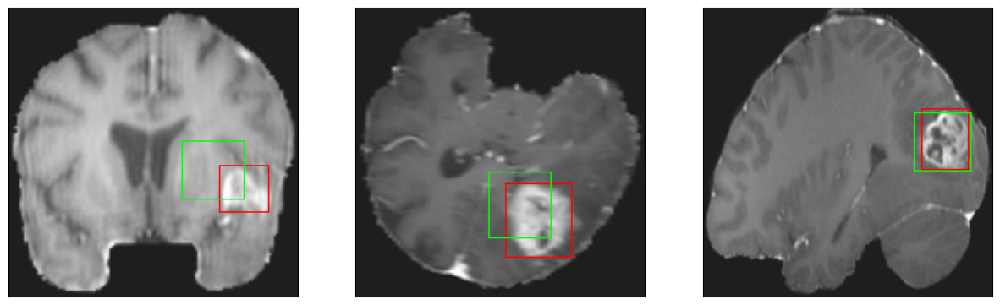

26/26 [==============================] - 3s 107ms/step - loss: 4.4798 - IoU: 0.6466 - val_loss: 8.6168 - val_IoU: 0.5376
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.5203 - IoU: 0.6399
Epoch 119: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


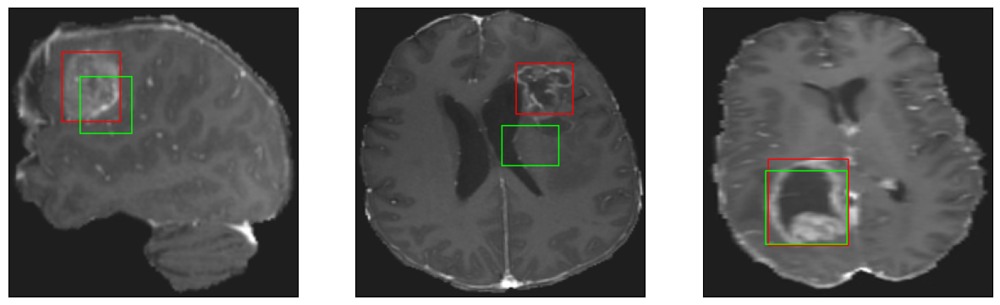

26/26 [==============================] - 3s 115ms/step - loss: 4.5203 - IoU: 0.6399 - val_loss: 7.9934 - val_IoU: 0.5618
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.6208 - IoU: 0.6347
Epoch 120: val_IoU did not improve from 0.56197
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


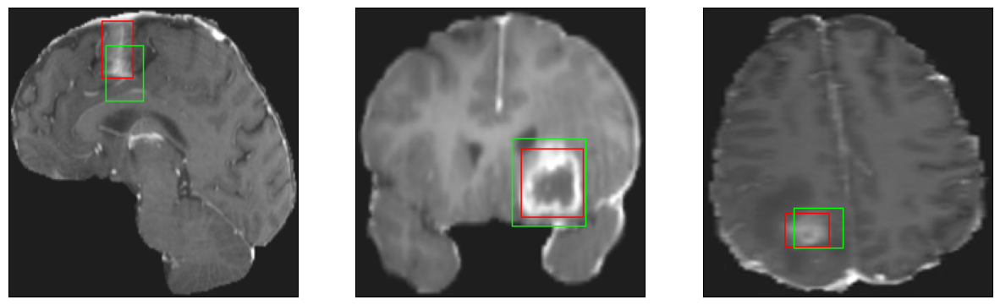

26/26 [==============================] - 3s 101ms/step - loss: 4.6208 - IoU: 0.6347 - val_loss: 8.6175 - val_IoU: 0.5375
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 4.7050 - IoU: 0.6355
Epoch 121: val_IoU improved from 0.56197 to 0.56330, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


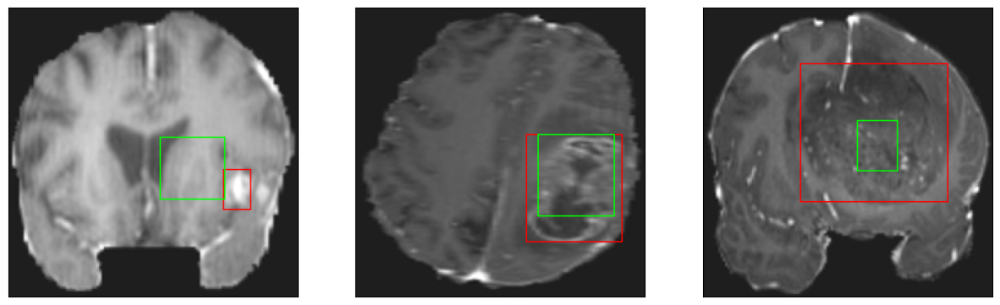

26/26 [==============================] - 5s 182ms/step - loss: 4.7050 - IoU: 0.6355 - val_loss: 8.0406 - val_IoU: 0.5633
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 4.6740 - IoU: 0.6313
Epoch 122: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


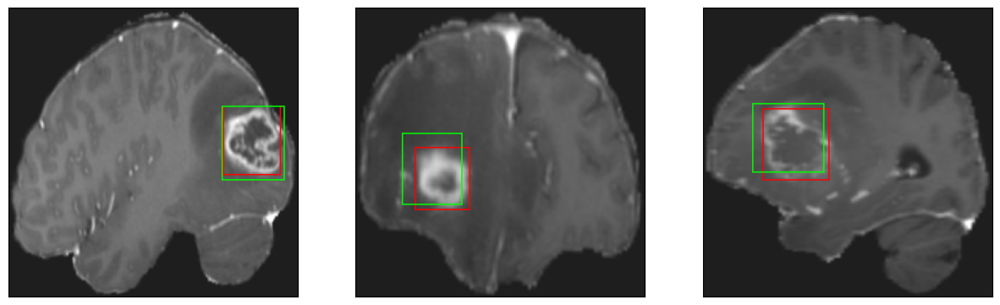

26/26 [==============================] - 3s 115ms/step - loss: 4.6740 - IoU: 0.6313 - val_loss: 8.1659 - val_IoU: 0.5537
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6625 - IoU: 0.6360
Epoch 123: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


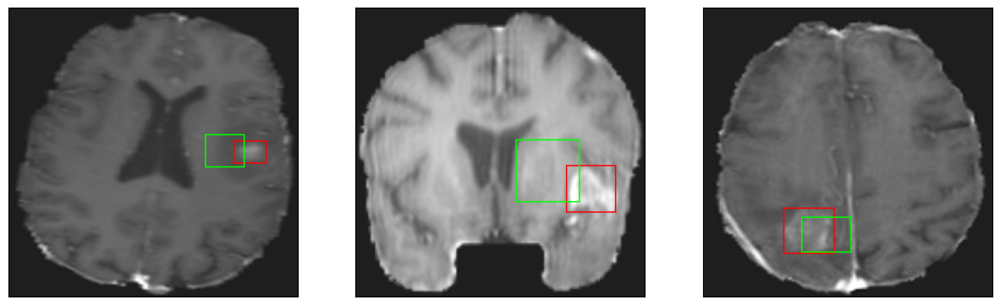

26/26 [==============================] - 3s 103ms/step - loss: 4.6290 - IoU: 0.6379 - val_loss: 8.3777 - val_IoU: 0.5293
Epoch 124/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6269 - IoU: 0.6318
Epoch 124: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


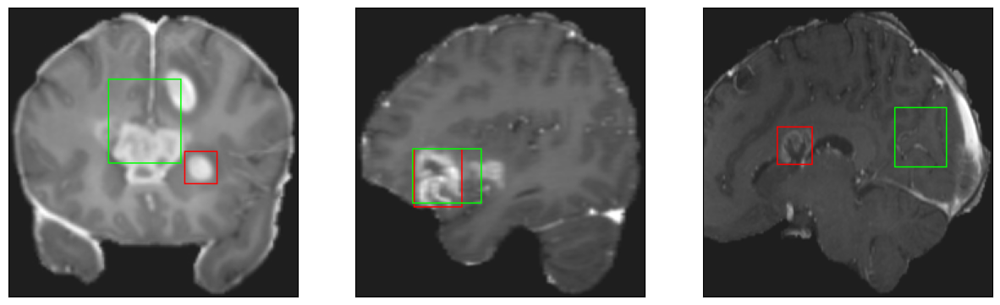

26/26 [==============================] - 3s 112ms/step - loss: 4.5906 - IoU: 0.6327 - val_loss: 8.6859 - val_IoU: 0.5287
Epoch 125/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6104 - IoU: 0.6465
Epoch 125: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


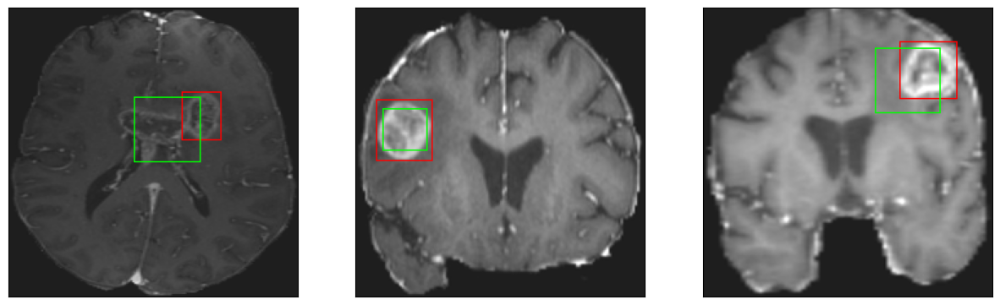

26/26 [==============================] - 3s 117ms/step - loss: 4.5669 - IoU: 0.6474 - val_loss: 8.2725 - val_IoU: 0.5390
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3710 - IoU: 0.6460
Epoch 126: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


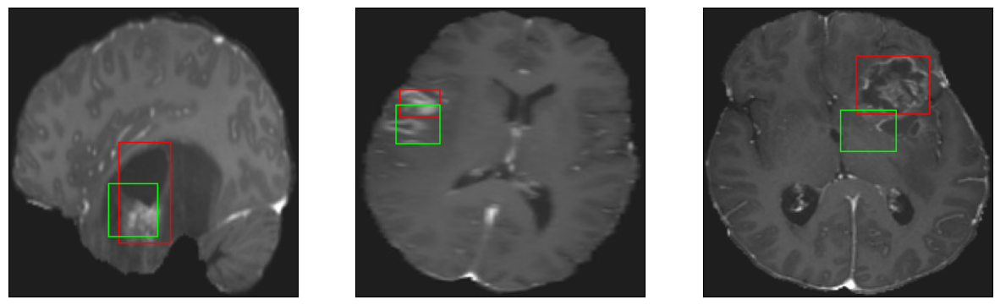

26/26 [==============================] - 3s 105ms/step - loss: 4.3571 - IoU: 0.6456 - val_loss: 8.3820 - val_IoU: 0.5386
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 4.4235 - IoU: 0.6398
Epoch 127: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


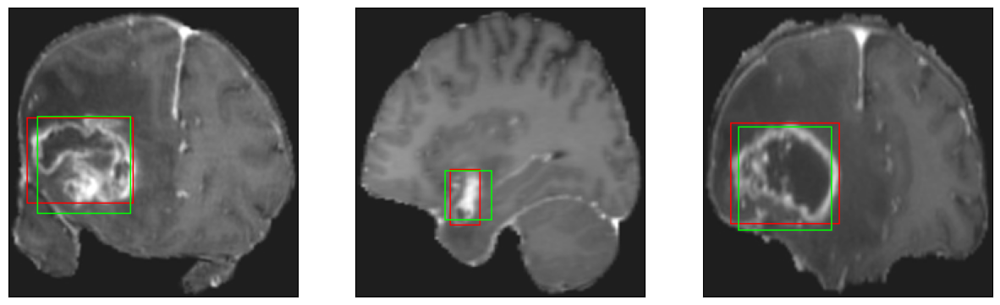

26/26 [==============================] - 3s 118ms/step - loss: 4.4235 - IoU: 0.6398 - val_loss: 8.5094 - val_IoU: 0.5395
Epoch 128/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6872 - IoU: 0.6391
Epoch 128: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


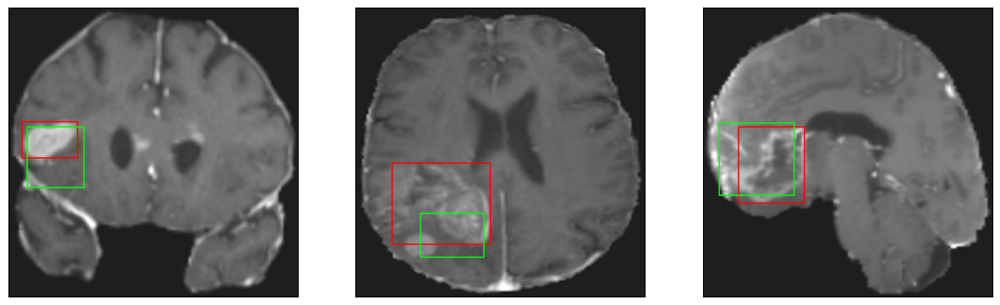

26/26 [==============================] - 3s 123ms/step - loss: 4.6561 - IoU: 0.6401 - val_loss: 8.5939 - val_IoU: 0.5404
Epoch 129/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5065 - IoU: 0.6426
Epoch 129: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


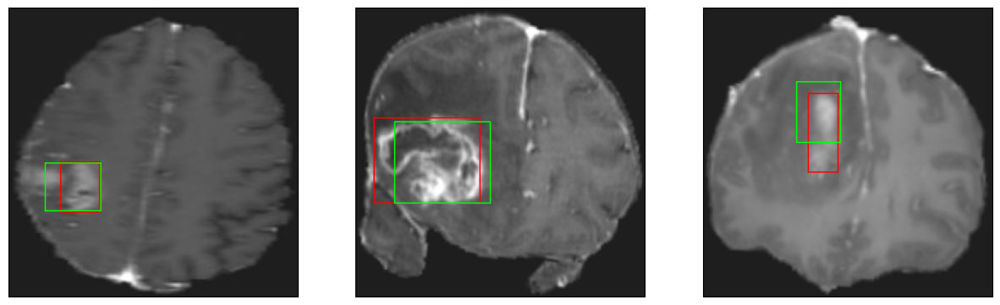

26/26 [==============================] - 3s 114ms/step - loss: 4.5738 - IoU: 0.6418 - val_loss: 8.9484 - val_IoU: 0.5216
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 4.7367 - IoU: 0.6275
Epoch 130: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


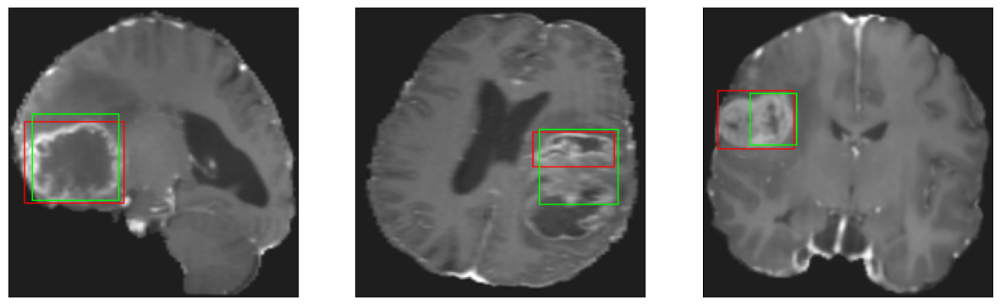

26/26 [==============================] - 3s 105ms/step - loss: 4.7367 - IoU: 0.6275 - val_loss: 9.1527 - val_IoU: 0.4909
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.6571 - IoU: 0.6311
Epoch 131: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


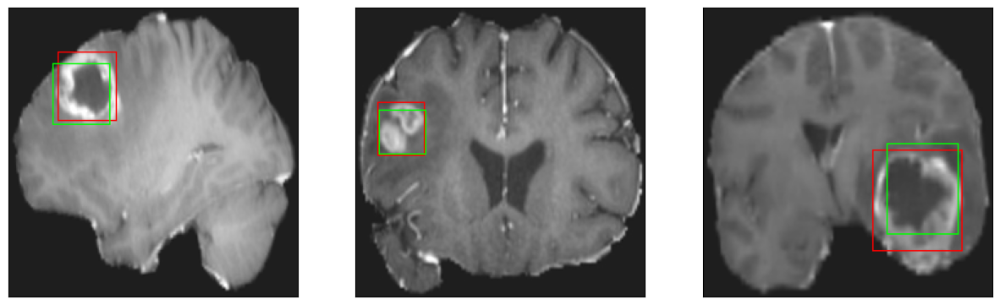

26/26 [==============================] - 3s 122ms/step - loss: 4.6571 - IoU: 0.6311 - val_loss: 8.7373 - val_IoU: 0.5269
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.4181 - IoU: 0.6466
Epoch 132: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


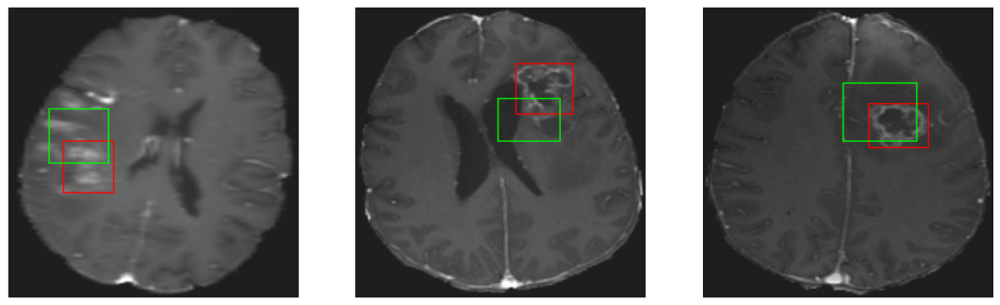

26/26 [==============================] - 3s 115ms/step - loss: 4.4181 - IoU: 0.6466 - val_loss: 7.9989 - val_IoU: 0.5576
Epoch 133/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5953 - IoU: 0.6380
Epoch 133: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


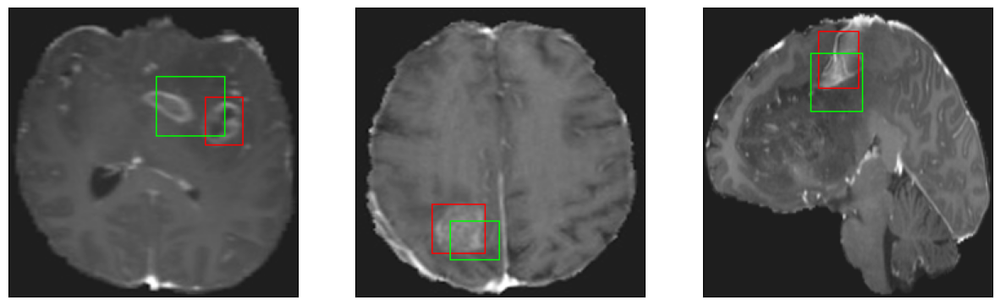

26/26 [==============================] - 3s 108ms/step - loss: 4.5782 - IoU: 0.6387 - val_loss: 8.6127 - val_IoU: 0.5305
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4665 - IoU: 0.6418
Epoch 134: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4


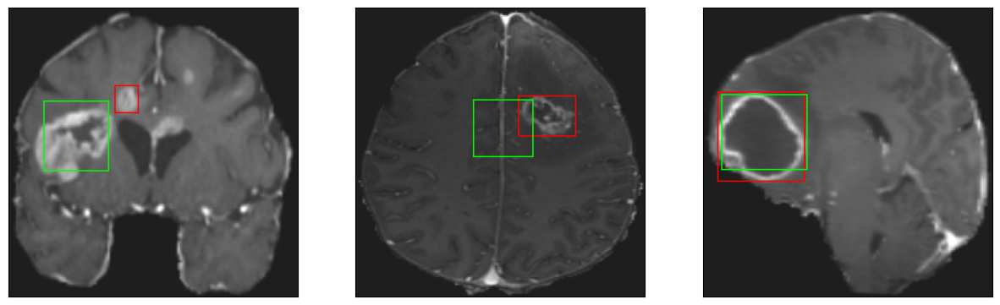

26/26 [==============================] - 3s 123ms/step - loss: 4.4319 - IoU: 0.6424 - val_loss: 9.3967 - val_IoU: 0.4839
Epoch 135/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4340 - IoU: 0.6460
Epoch 135: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


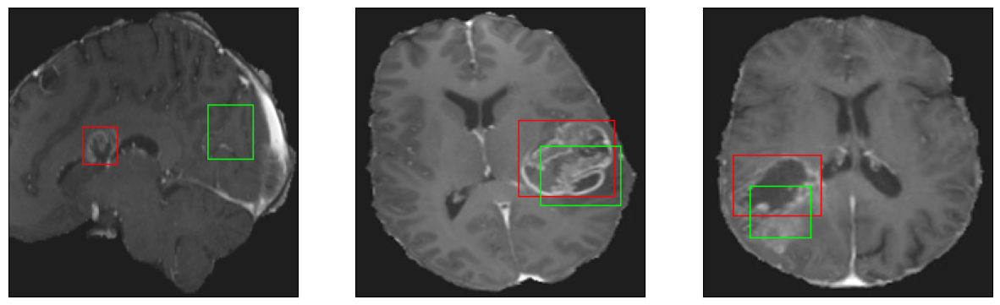

26/26 [==============================] - 3s 105ms/step - loss: 4.4068 - IoU: 0.6472 - val_loss: 8.8342 - val_IoU: 0.5147
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 4.5968 - IoU: 0.6250
Epoch 136: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


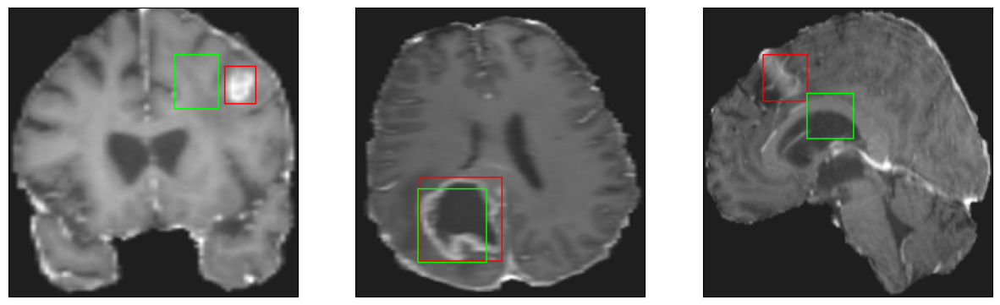

26/26 [==============================] - 3s 97ms/step - loss: 4.5968 - IoU: 0.6250 - val_loss: 8.3201 - val_IoU: 0.5462
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.6397 - IoU: 0.6316
Epoch 137: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


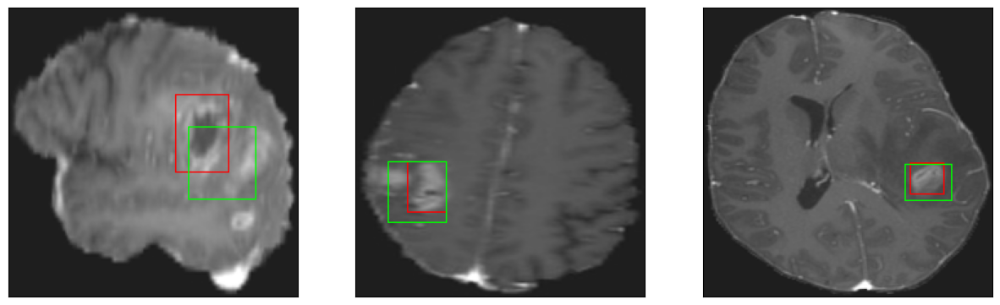

26/26 [==============================] - 3s 106ms/step - loss: 4.6397 - IoU: 0.6316 - val_loss: 8.4444 - val_IoU: 0.5393
Epoch 138/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4455 - IoU: 0.6478
Epoch 138: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


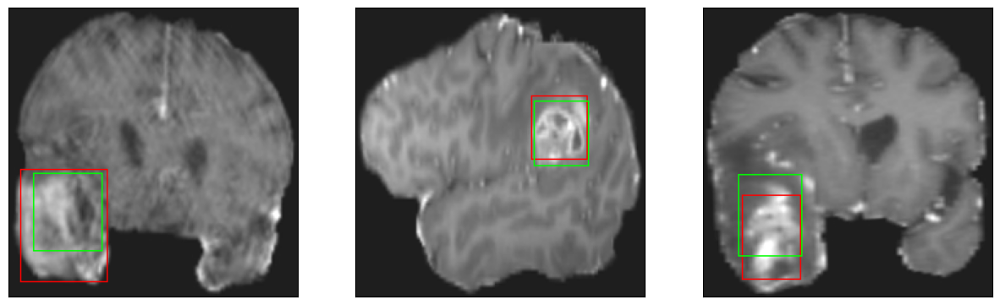

26/26 [==============================] - 3s 115ms/step - loss: 4.4565 - IoU: 0.6475 - val_loss: 8.1512 - val_IoU: 0.5599
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3925 - IoU: 0.6500
Epoch 139: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


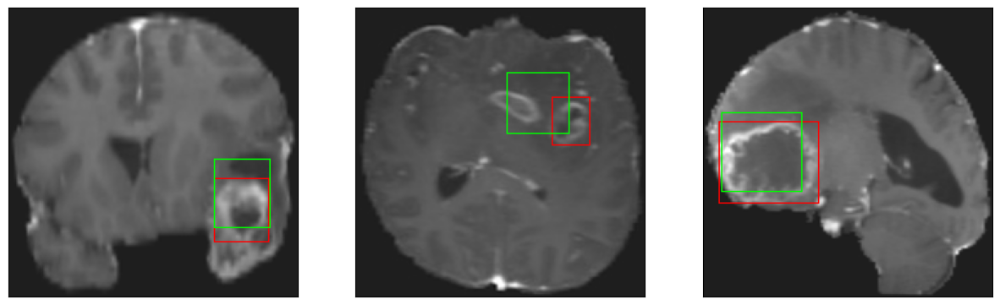

26/26 [==============================] - 3s 128ms/step - loss: 4.3570 - IoU: 0.6517 - val_loss: 8.0451 - val_IoU: 0.5585
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 4.4615 - IoU: 0.6472
Epoch 140: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


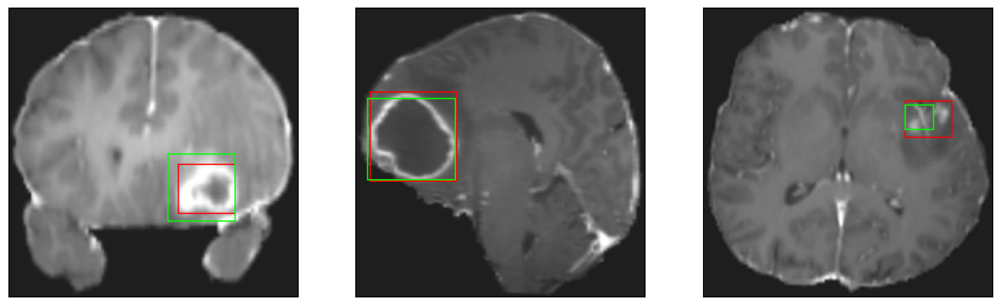

26/26 [==============================] - 3s 105ms/step - loss: 4.4615 - IoU: 0.6472 - val_loss: 8.1590 - val_IoU: 0.5575
Epoch 141/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3424 - IoU: 0.6547
Epoch 141: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


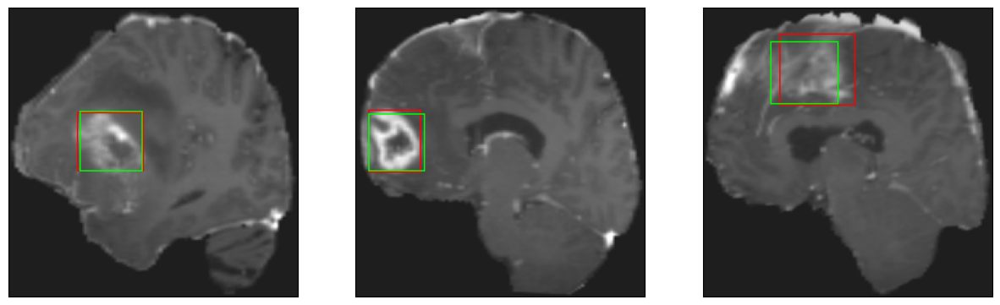

26/26 [==============================] - 3s 132ms/step - loss: 4.3285 - IoU: 0.6560 - val_loss: 9.0119 - val_IoU: 0.5145
Epoch 142/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1594 - IoU: 0.6564
Epoch 142: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


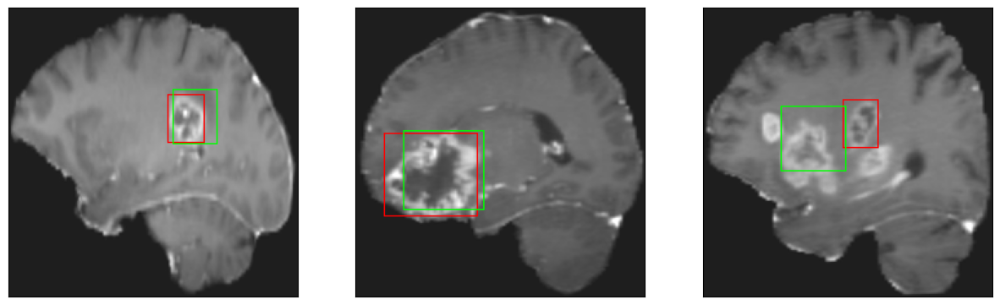

26/26 [==============================] - 3s 122ms/step - loss: 4.1848 - IoU: 0.6569 - val_loss: 8.1657 - val_IoU: 0.5516
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 4.2463 - IoU: 0.6520
Epoch 143: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


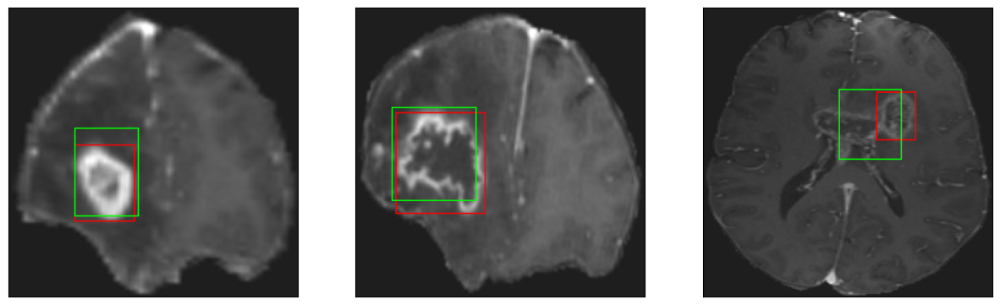

26/26 [==============================] - 3s 135ms/step - loss: 4.2463 - IoU: 0.6520 - val_loss: 8.4268 - val_IoU: 0.5405
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 4.3255 - IoU: 0.6536
Epoch 144: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


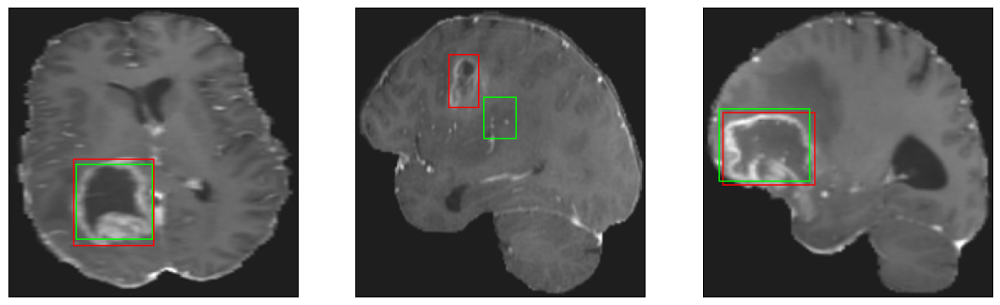

26/26 [==============================] - 3s 123ms/step - loss: 4.3255 - IoU: 0.6536 - val_loss: 8.2275 - val_IoU: 0.5402
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 4.1843 - IoU: 0.6586
Epoch 145: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


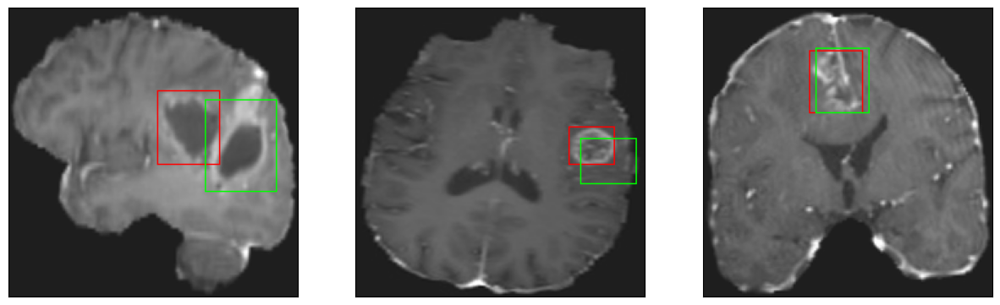

26/26 [==============================] - 3s 106ms/step - loss: 4.1843 - IoU: 0.6586 - val_loss: 8.6903 - val_IoU: 0.5239
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3505 - IoU: 0.6494
Epoch 146: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


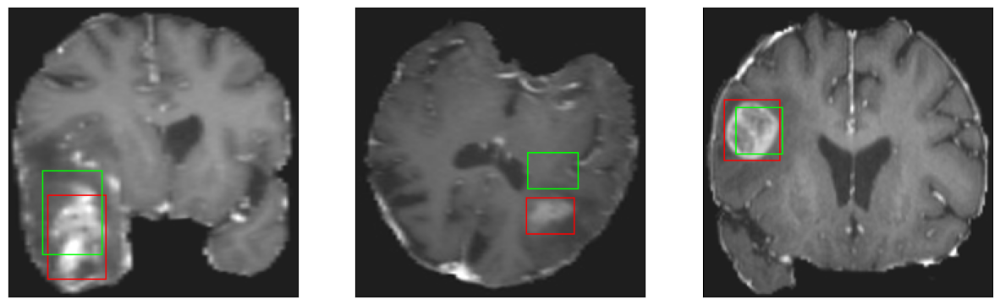

26/26 [==============================] - 3s 104ms/step - loss: 4.3732 - IoU: 0.6479 - val_loss: 8.4376 - val_IoU: 0.5443
Epoch 147/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7178 - IoU: 0.6314
Epoch 147: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


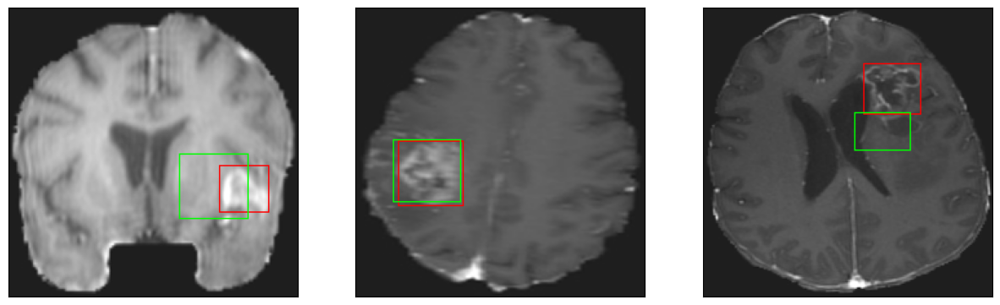

26/26 [==============================] - 3s 112ms/step - loss: 4.6721 - IoU: 0.6334 - val_loss: 8.6310 - val_IoU: 0.5315
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3738 - IoU: 0.6525
Epoch 148: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


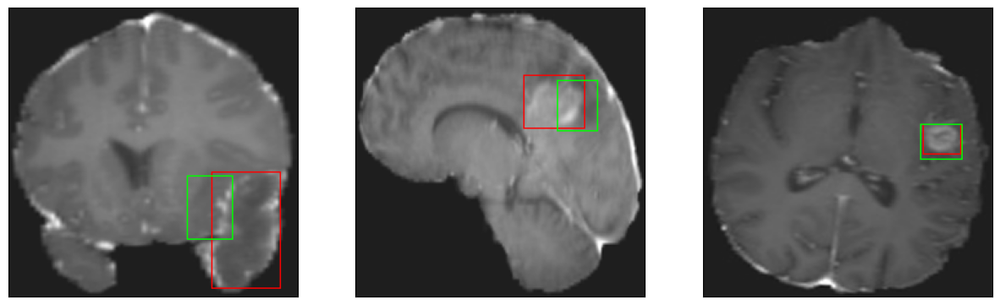

26/26 [==============================] - 3s 105ms/step - loss: 4.3681 - IoU: 0.6543 - val_loss: 8.2375 - val_IoU: 0.5549
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.6120 - IoU: 0.6395
Epoch 149: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


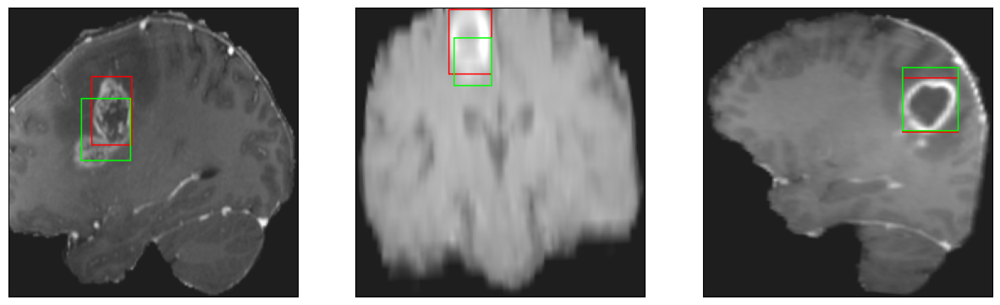

26/26 [==============================] - 3s 126ms/step - loss: 4.6120 - IoU: 0.6395 - val_loss: 8.3234 - val_IoU: 0.5446
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3549 - IoU: 0.6487
Epoch 150: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


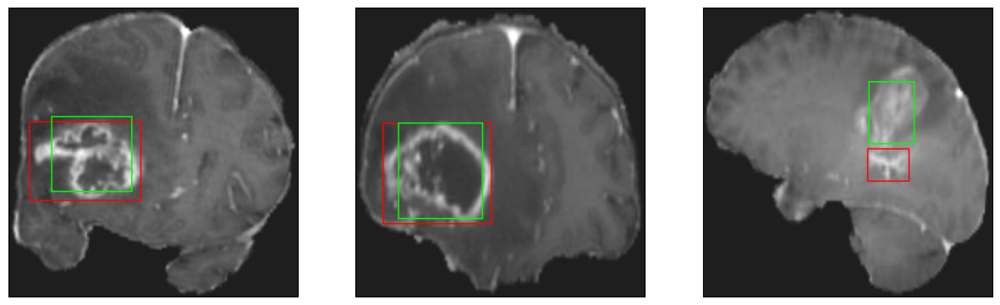

26/26 [==============================] - 3s 106ms/step - loss: 4.3265 - IoU: 0.6500 - val_loss: 8.8072 - val_IoU: 0.5169
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 4.4929 - IoU: 0.6477
Epoch 151: val_IoU did not improve from 0.56330
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


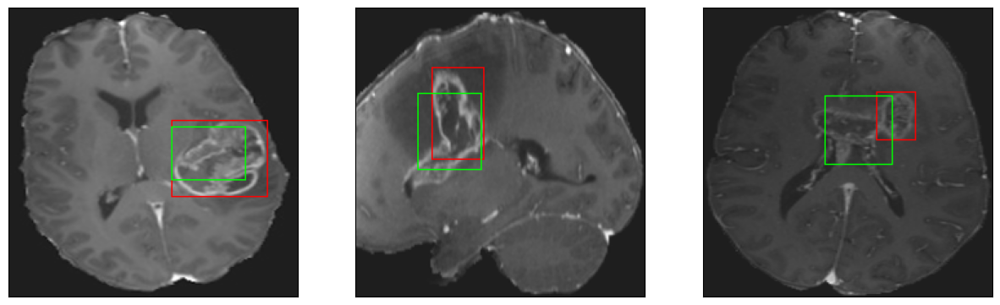

26/26 [==============================] - 3s 126ms/step - loss: 4.4929 - IoU: 0.6477 - val_loss: 9.0820 - val_IoU: 0.5060
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 4.2652 - IoU: 0.6490
Epoch 152: val_IoU improved from 0.56330 to 0.56371, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


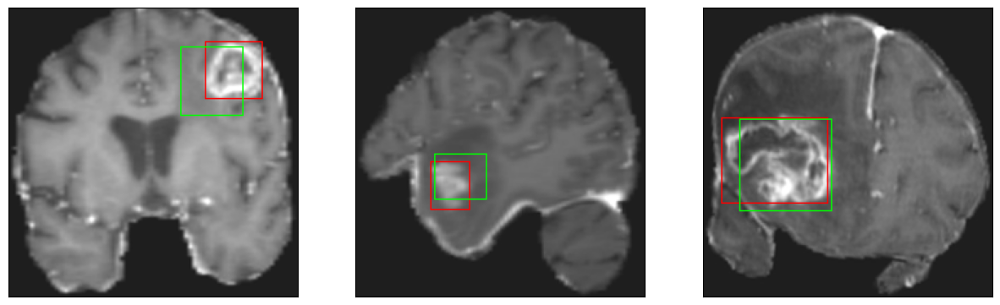

26/26 [==============================] - 4s 148ms/step - loss: 4.2652 - IoU: 0.6490 - val_loss: 8.2459 - val_IoU: 0.5637
Epoch 153/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3025 - IoU: 0.6498
Epoch 153: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


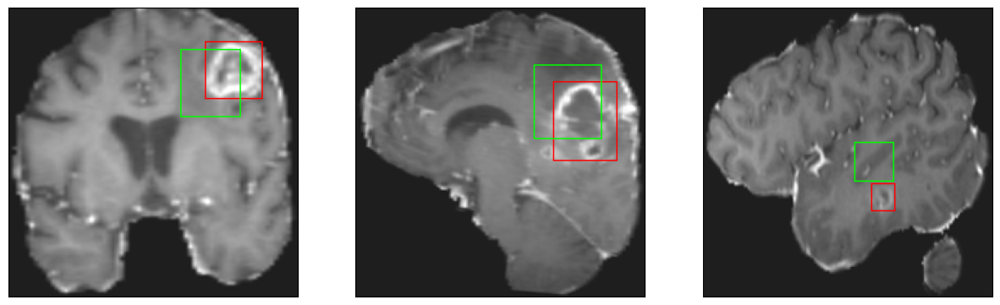

26/26 [==============================] - 2s 94ms/step - loss: 4.3087 - IoU: 0.6502 - val_loss: 8.7691 - val_IoU: 0.5205
Epoch 154/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1365 - IoU: 0.6679
Epoch 154: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


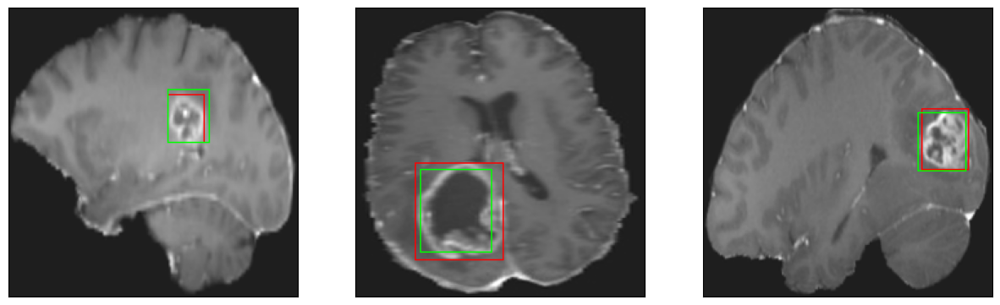

26/26 [==============================] - 3s 114ms/step - loss: 4.1806 - IoU: 0.6672 - val_loss: 8.3279 - val_IoU: 0.5485
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 4.2364 - IoU: 0.6551
Epoch 155: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


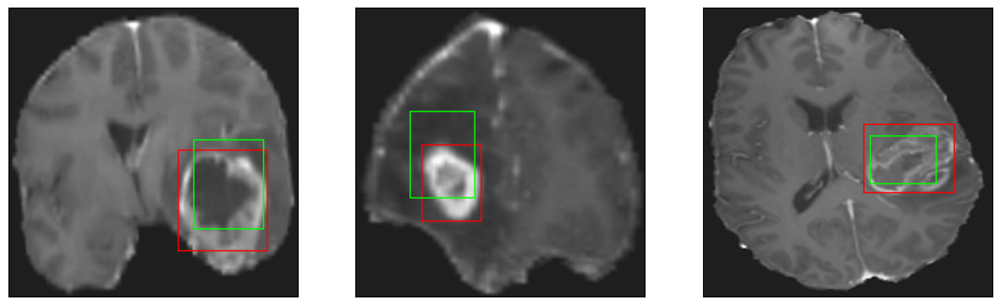

26/26 [==============================] - 3s 128ms/step - loss: 4.2364 - IoU: 0.6551 - val_loss: 8.2081 - val_IoU: 0.5504
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4979 - IoU: 0.6431
Epoch 156: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


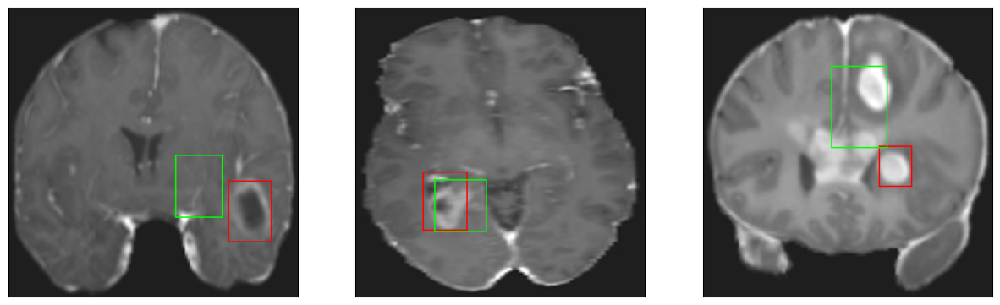

26/26 [==============================] - 3s 115ms/step - loss: 4.5175 - IoU: 0.6436 - val_loss: 8.7650 - val_IoU: 0.5301
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 4.2849 - IoU: 0.6489
Epoch 157: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


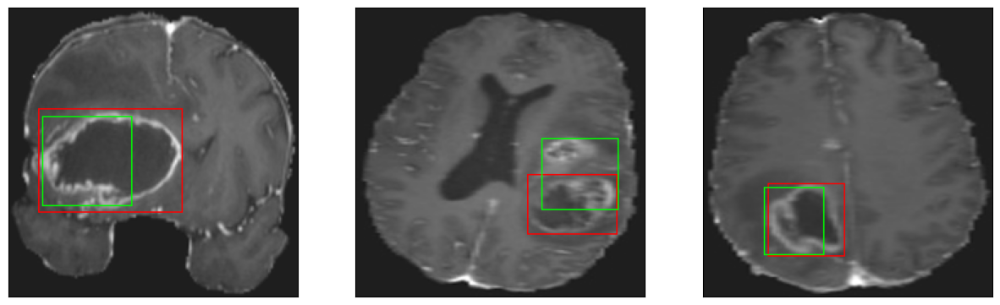

26/26 [==============================] - 3s 105ms/step - loss: 4.2849 - IoU: 0.6489 - val_loss: 8.4206 - val_IoU: 0.5475
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4300 - IoU: 0.6476
Epoch 158: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


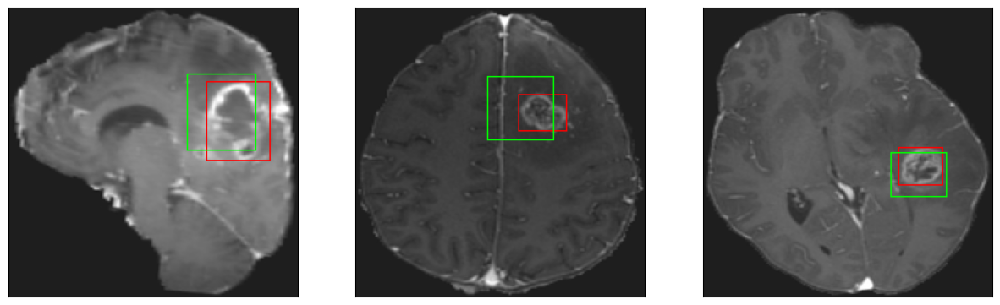

26/26 [==============================] - 3s 125ms/step - loss: 4.4043 - IoU: 0.6486 - val_loss: 8.1620 - val_IoU: 0.5488
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 4.2886 - IoU: 0.6543
Epoch 159: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


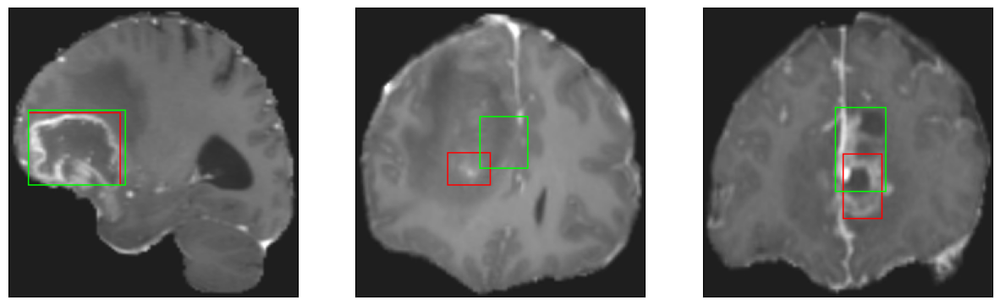

26/26 [==============================] - 3s 131ms/step - loss: 4.2886 - IoU: 0.6543 - val_loss: 8.7707 - val_IoU: 0.5414
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3717 - IoU: 0.6442
Epoch 160: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


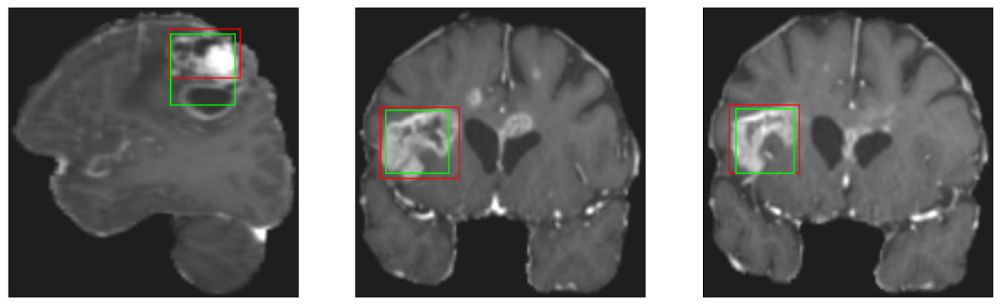

26/26 [==============================] - 3s 103ms/step - loss: 4.4213 - IoU: 0.6428 - val_loss: 8.7676 - val_IoU: 0.5272
Epoch 161/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5069 - IoU: 0.6466
Epoch 161: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


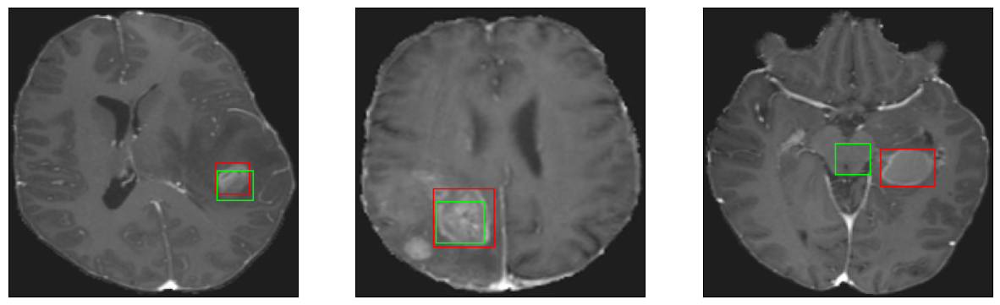

26/26 [==============================] - 3s 107ms/step - loss: 4.5281 - IoU: 0.6453 - val_loss: 8.8992 - val_IoU: 0.5174
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4165 - IoU: 0.6515
Epoch 162: val_IoU did not improve from 0.56371
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 13ms/step
4


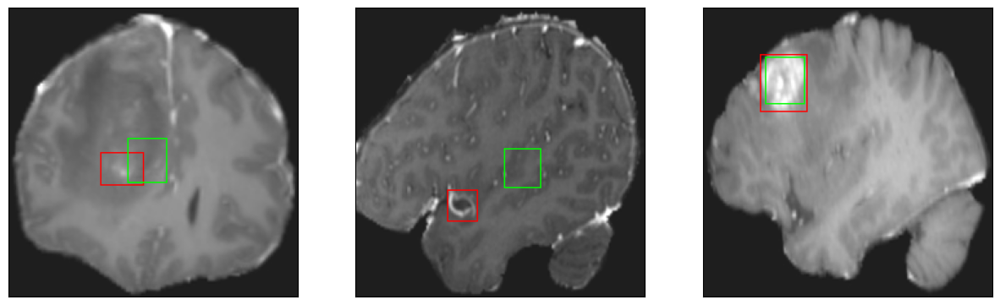

26/26 [==============================] - 3s 132ms/step - loss: 4.4150 - IoU: 0.6497 - val_loss: 8.3184 - val_IoU: 0.5550
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 4.2107 - IoU: 0.6608
Epoch 163: val_IoU improved from 0.56371 to 0.56377, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4


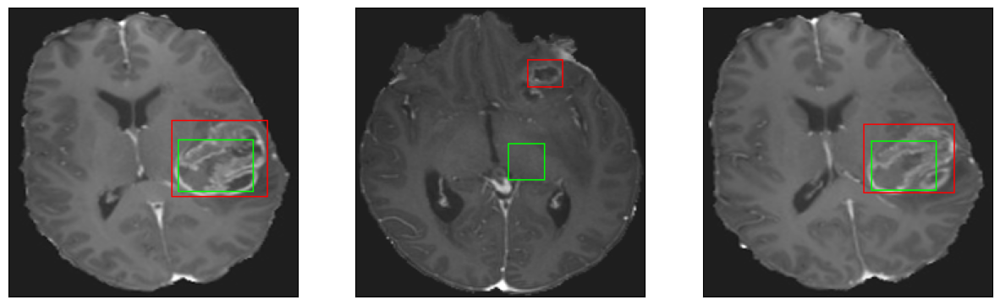

26/26 [==============================] - 4s 147ms/step - loss: 4.2107 - IoU: 0.6608 - val_loss: 8.2813 - val_IoU: 0.5638
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.2898 - IoU: 0.6604
Epoch 164: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


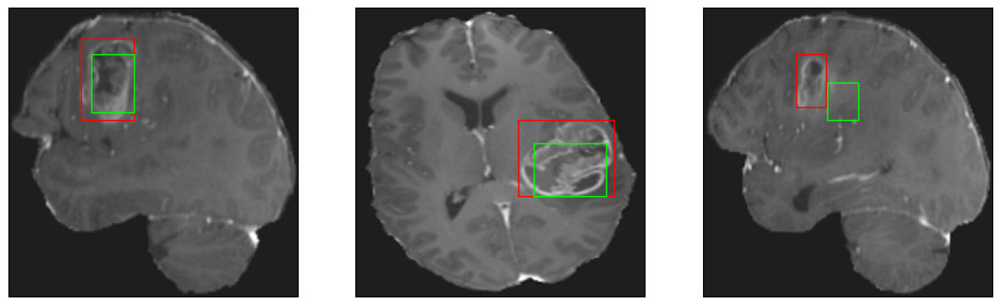

26/26 [==============================] - 3s 111ms/step - loss: 4.2898 - IoU: 0.6604 - val_loss: 9.1048 - val_IoU: 0.5003
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5725 - IoU: 0.6354
Epoch 165: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4


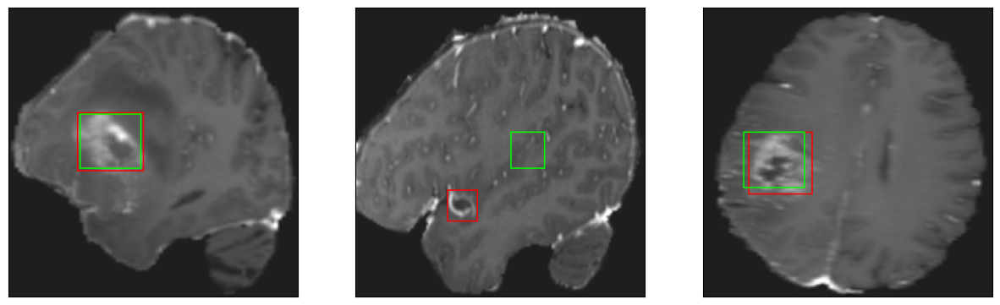

26/26 [==============================] - 3s 106ms/step - loss: 4.5711 - IoU: 0.6383 - val_loss: 8.1597 - val_IoU: 0.5627
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1887 - IoU: 0.6614
Epoch 166: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


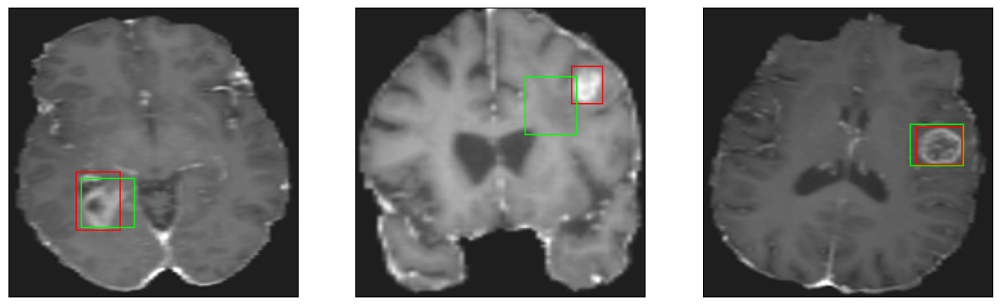

26/26 [==============================] - 3s 115ms/step - loss: 4.2283 - IoU: 0.6599 - val_loss: 8.7354 - val_IoU: 0.5160
Epoch 167/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2203 - IoU: 0.6581
Epoch 167: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


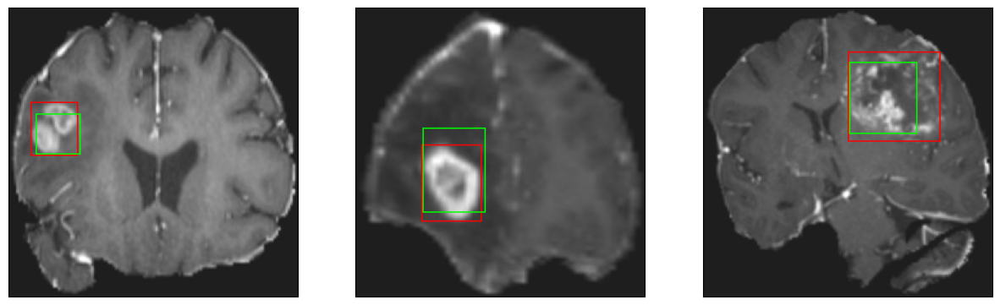

26/26 [==============================] - 3s 110ms/step - loss: 4.1862 - IoU: 0.6605 - val_loss: 8.2334 - val_IoU: 0.5521
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.2984 - IoU: 0.6576
Epoch 168: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


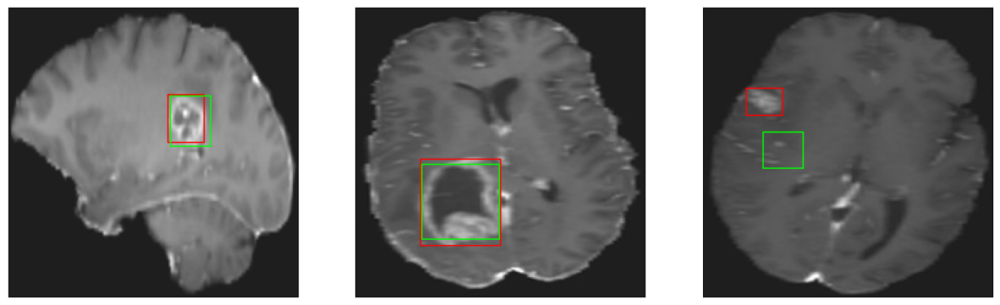

26/26 [==============================] - 3s 113ms/step - loss: 4.2984 - IoU: 0.6576 - val_loss: 8.6412 - val_IoU: 0.5202
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 4.1345 - IoU: 0.6600
Epoch 169: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


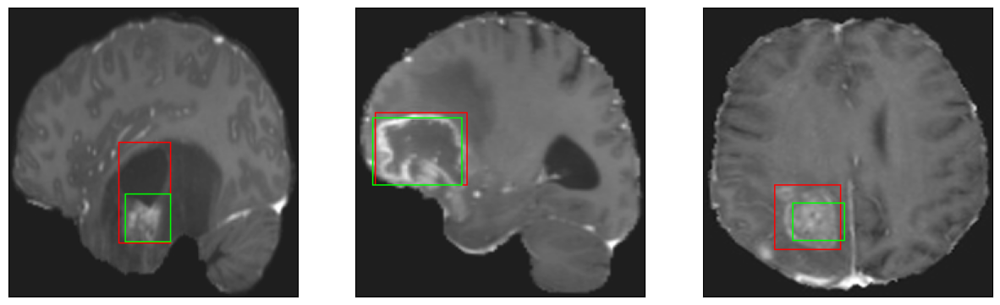

26/26 [==============================] - 3s 127ms/step - loss: 4.1345 - IoU: 0.6600 - val_loss: 8.4469 - val_IoU: 0.5395
Epoch 170/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1735 - IoU: 0.6650
Epoch 170: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


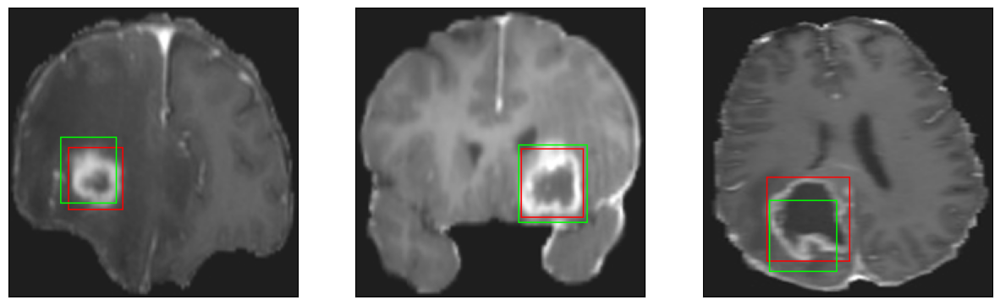

26/26 [==============================] - 3s 101ms/step - loss: 4.1675 - IoU: 0.6646 - val_loss: 8.3297 - val_IoU: 0.5483
Epoch 171/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3655 - IoU: 0.6584
Epoch 171: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


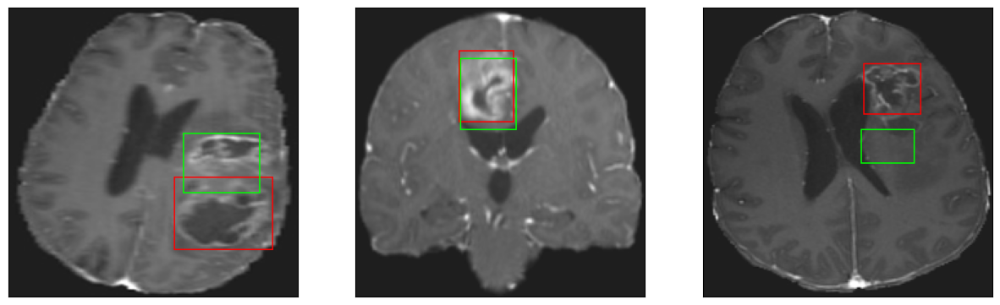

26/26 [==============================] - 3s 99ms/step - loss: 4.3902 - IoU: 0.6591 - val_loss: 8.5279 - val_IoU: 0.5308
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1533 - IoU: 0.6598
Epoch 172: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


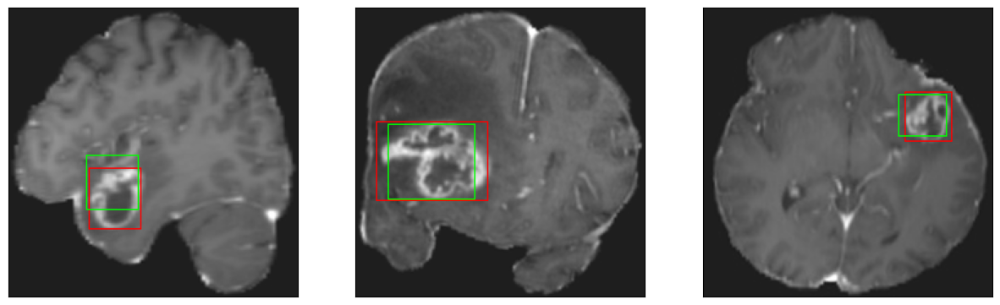

26/26 [==============================] - 3s 118ms/step - loss: 4.1398 - IoU: 0.6598 - val_loss: 8.3452 - val_IoU: 0.5469
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 4.5318 - IoU: 0.6488
Epoch 173: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


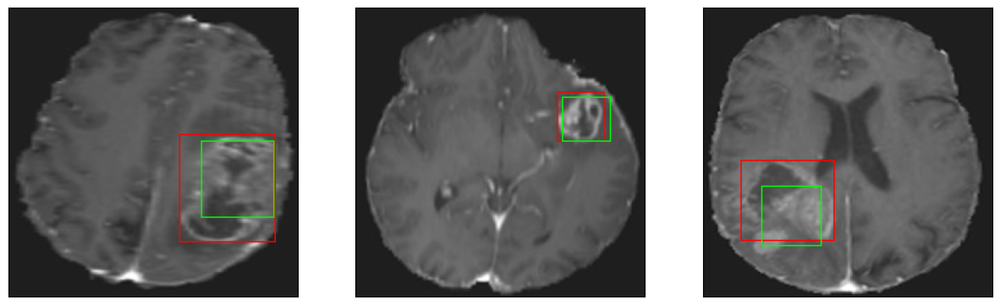

26/26 [==============================] - 3s 136ms/step - loss: 4.5318 - IoU: 0.6488 - val_loss: 8.4942 - val_IoU: 0.5420
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 4.5604 - IoU: 0.6233
Epoch 174: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


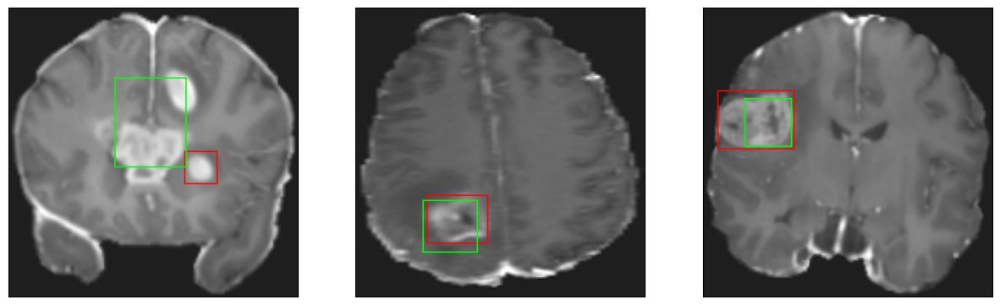

26/26 [==============================] - 3s 119ms/step - loss: 4.5604 - IoU: 0.6233 - val_loss: 8.4496 - val_IoU: 0.5371
Epoch 175/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2320 - IoU: 0.6546
Epoch 175: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


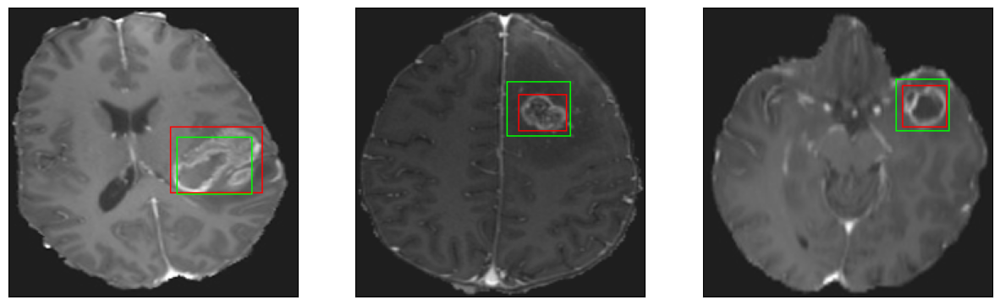

26/26 [==============================] - 3s 110ms/step - loss: 4.2144 - IoU: 0.6552 - val_loss: 8.4889 - val_IoU: 0.5604
Epoch 176/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0880 - IoU: 0.6669
Epoch 176: val_IoU did not improve from 0.56377
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


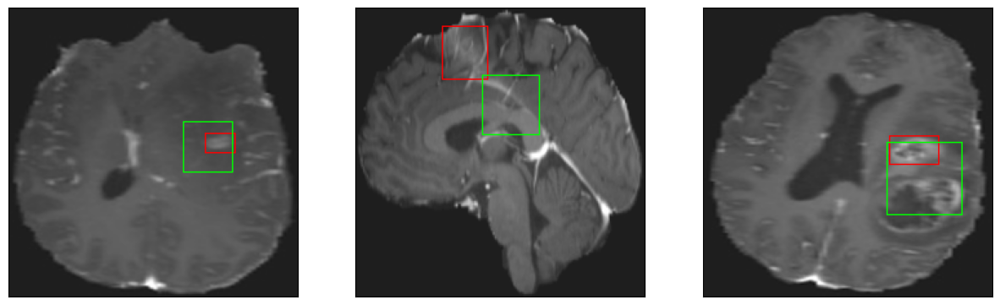

26/26 [==============================] - 3s 111ms/step - loss: 4.0831 - IoU: 0.6679 - val_loss: 8.2682 - val_IoU: 0.5601
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 4.1335 - IoU: 0.6671
Epoch 177: val_IoU improved from 0.56377 to 0.57602, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


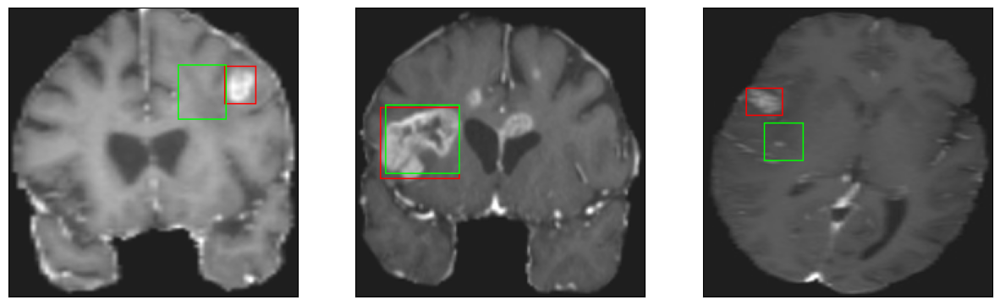

26/26 [==============================] - 4s 172ms/step - loss: 4.1335 - IoU: 0.6671 - val_loss: 7.9586 - val_IoU: 0.5760
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 4.0944 - IoU: 0.6696
Epoch 178: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


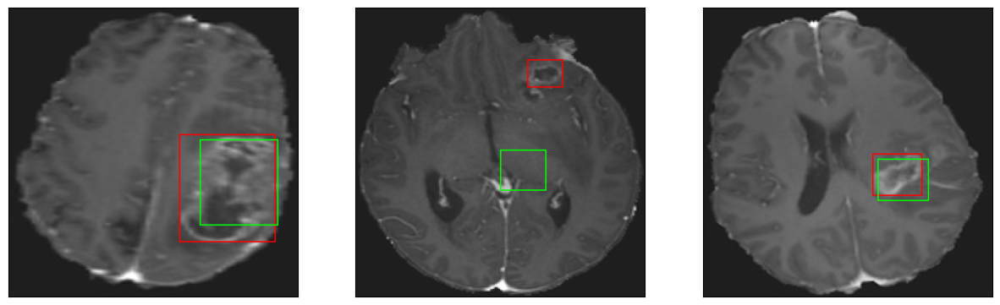

26/26 [==============================] - 3s 110ms/step - loss: 4.0944 - IoU: 0.6696 - val_loss: 8.7147 - val_IoU: 0.5246
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 4.2967 - IoU: 0.6548
Epoch 179: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


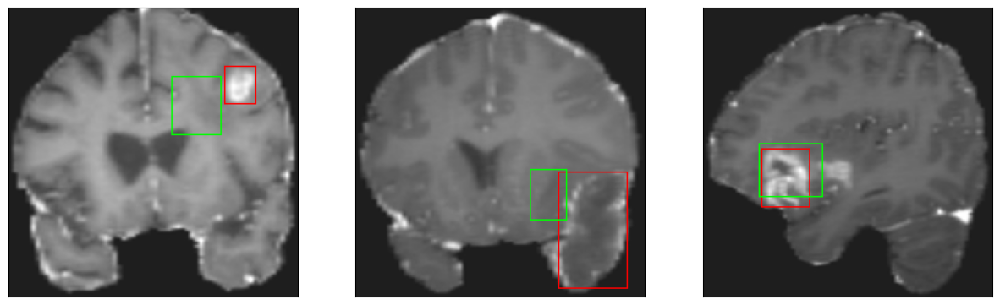

26/26 [==============================] - 3s 102ms/step - loss: 4.2967 - IoU: 0.6548 - val_loss: 8.7204 - val_IoU: 0.5136
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2150 - IoU: 0.6505
Epoch 180: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


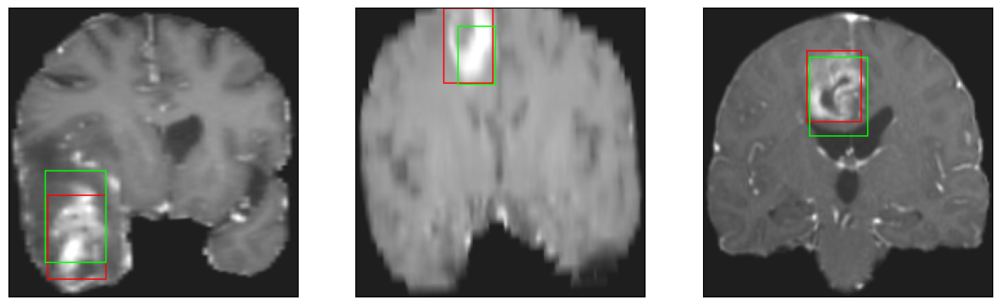

26/26 [==============================] - 3s 117ms/step - loss: 4.2179 - IoU: 0.6503 - val_loss: 8.3028 - val_IoU: 0.5614
Epoch 181/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3675 - IoU: 0.6455
Epoch 181: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


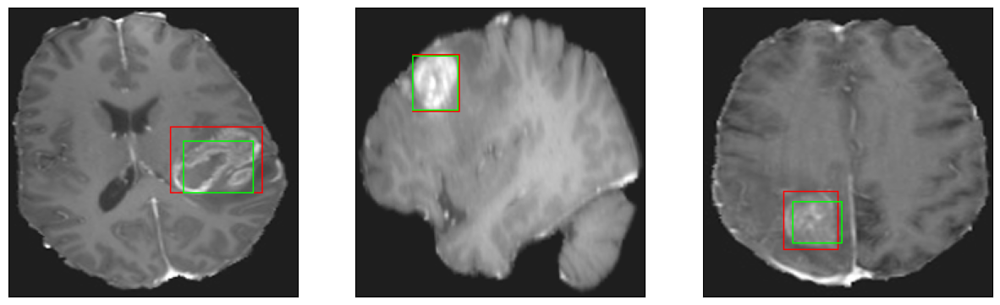

26/26 [==============================] - 3s 108ms/step - loss: 4.3997 - IoU: 0.6446 - val_loss: 8.3911 - val_IoU: 0.5538
Epoch 182/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0598 - IoU: 0.6626
Epoch 182: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


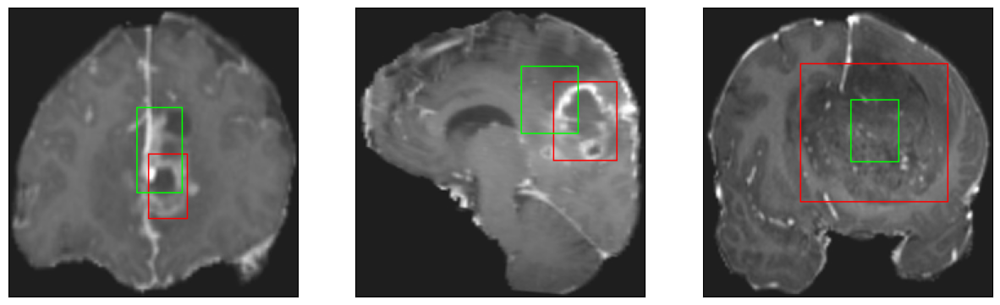

26/26 [==============================] - 3s 114ms/step - loss: 4.0534 - IoU: 0.6628 - val_loss: 8.4078 - val_IoU: 0.5423
Epoch 183/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1140 - IoU: 0.6640
Epoch 183: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


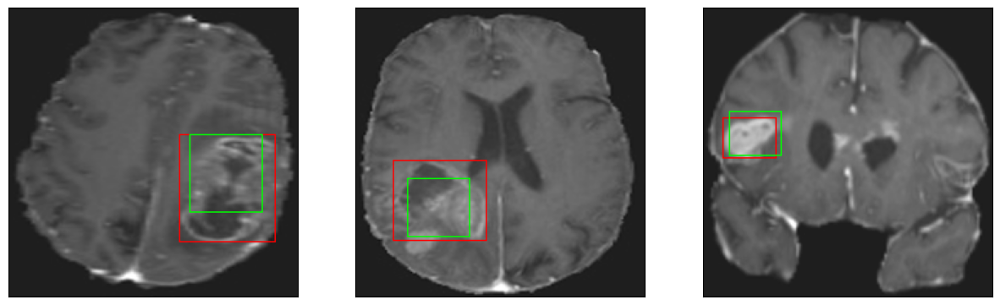

26/26 [==============================] - 3s 106ms/step - loss: 4.1295 - IoU: 0.6626 - val_loss: 8.0347 - val_IoU: 0.5591
Epoch 184/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0914 - IoU: 0.6676
Epoch 184: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


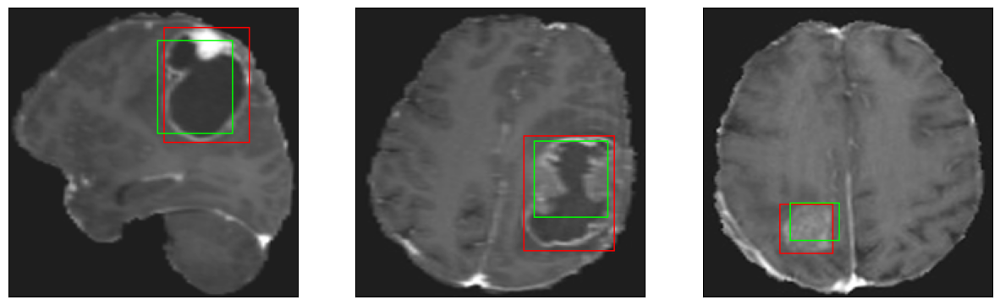

26/26 [==============================] - 3s 120ms/step - loss: 4.0867 - IoU: 0.6674 - val_loss: 8.0869 - val_IoU: 0.5548
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2274 - IoU: 0.6516
Epoch 185: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


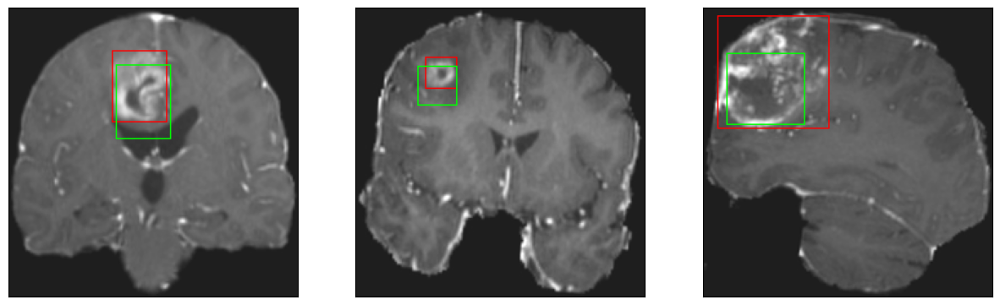

26/26 [==============================] - 2s 96ms/step - loss: 4.2370 - IoU: 0.6517 - val_loss: 8.4291 - val_IoU: 0.5390
Epoch 186/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1030 - IoU: 0.6702
Epoch 186: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


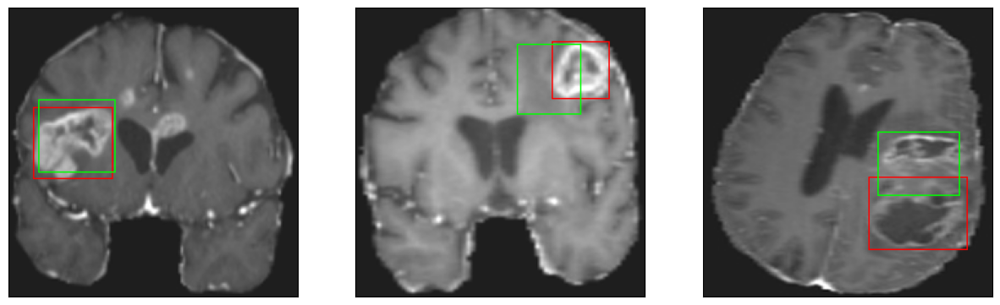

26/26 [==============================] - 3s 98ms/step - loss: 4.1381 - IoU: 0.6674 - val_loss: 8.3954 - val_IoU: 0.5556
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2095 - IoU: 0.6489
Epoch 187: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


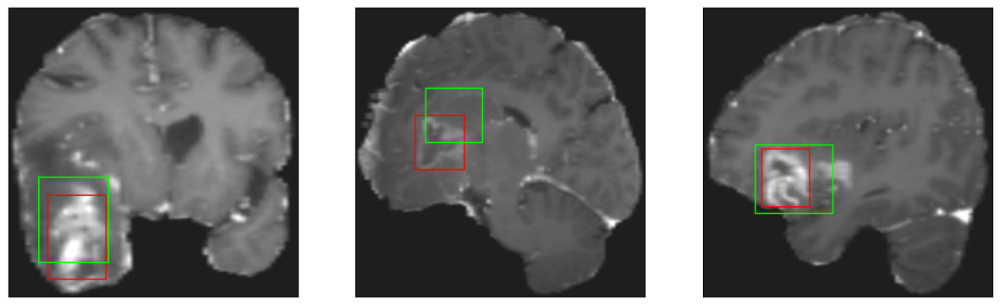

26/26 [==============================] - 3s 103ms/step - loss: 4.2036 - IoU: 0.6496 - val_loss: 8.6099 - val_IoU: 0.5578
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 4.2192 - IoU: 0.6608
Epoch 188: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


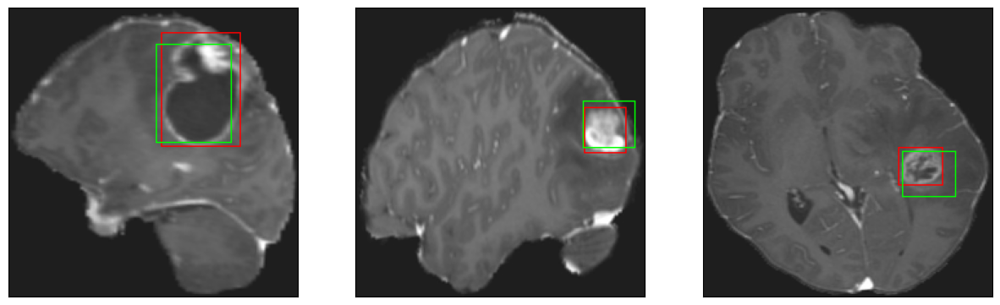

26/26 [==============================] - 3s 107ms/step - loss: 4.2192 - IoU: 0.6608 - val_loss: 7.8774 - val_IoU: 0.5702
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 4.0489 - IoU: 0.6706
Epoch 189: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


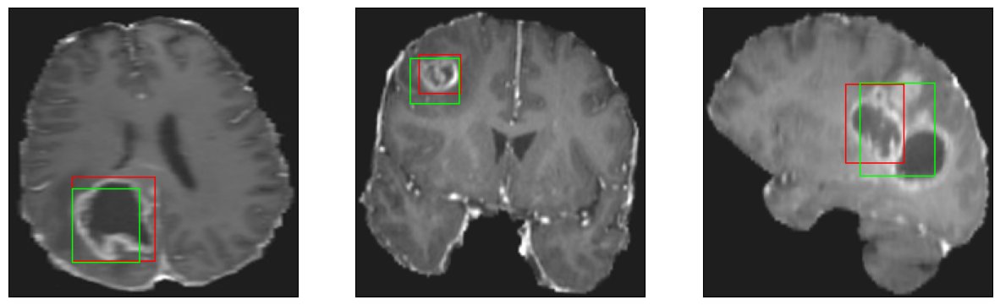

26/26 [==============================] - 3s 120ms/step - loss: 4.0489 - IoU: 0.6706 - val_loss: 8.1924 - val_IoU: 0.5509
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 4.1973 - IoU: 0.6592
Epoch 190: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


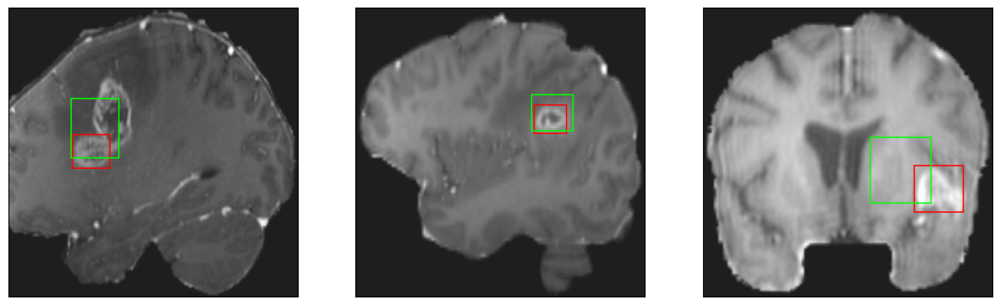

26/26 [==============================] - 3s 110ms/step - loss: 4.1973 - IoU: 0.6592 - val_loss: 8.6616 - val_IoU: 0.5248
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2795 - IoU: 0.6524
Epoch 191: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


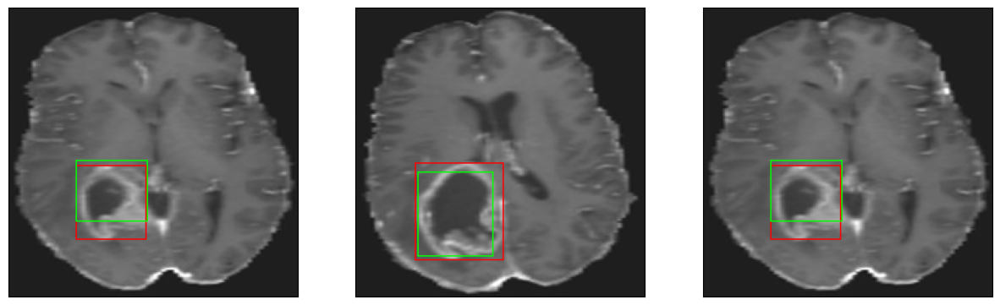

26/26 [==============================] - 3s 108ms/step - loss: 4.2495 - IoU: 0.6532 - val_loss: 7.9008 - val_IoU: 0.5710
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 4.1999 - IoU: 0.6549
Epoch 192: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


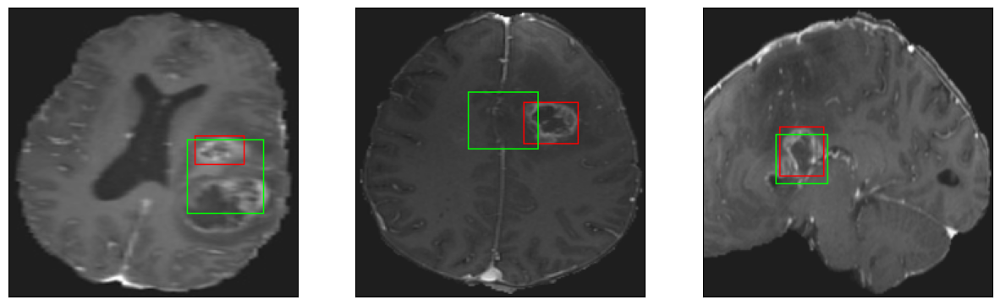

26/26 [==============================] - 3s 122ms/step - loss: 4.1999 - IoU: 0.6549 - val_loss: 8.1788 - val_IoU: 0.5515
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0077 - IoU: 0.6722
Epoch 193: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


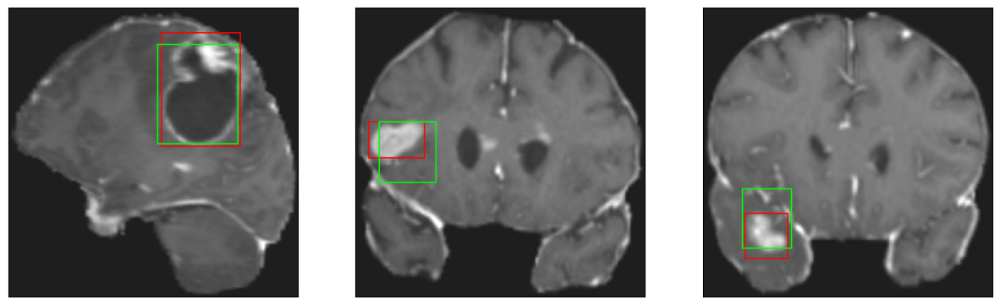

26/26 [==============================] - 3s 110ms/step - loss: 4.0574 - IoU: 0.6700 - val_loss: 8.1644 - val_IoU: 0.5546
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0461 - IoU: 0.6652
Epoch 194: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


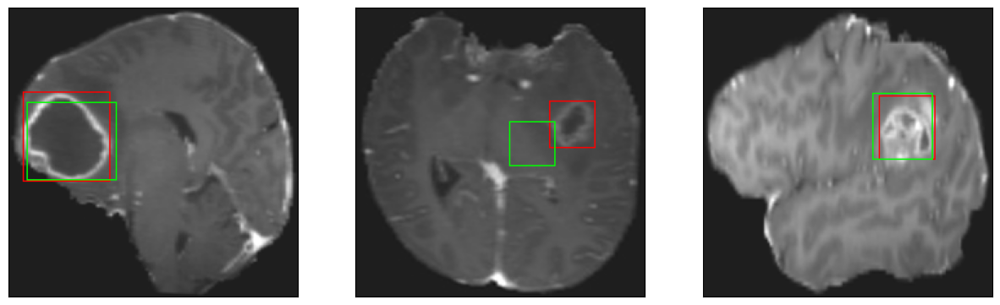

26/26 [==============================] - 3s 103ms/step - loss: 4.0845 - IoU: 0.6632 - val_loss: 8.2515 - val_IoU: 0.5505
Epoch 195/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4190 - IoU: 0.6421
Epoch 195: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


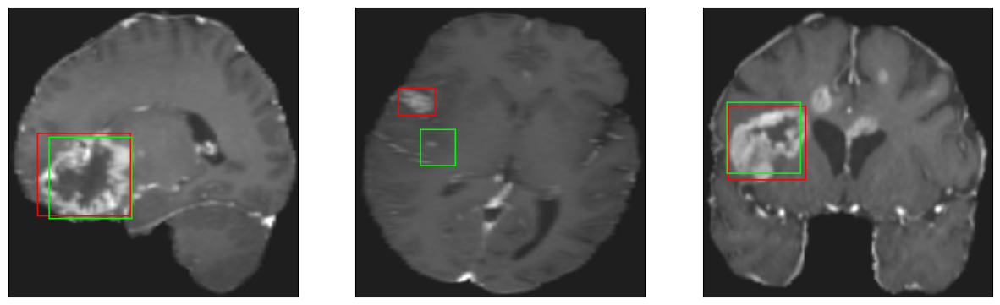

26/26 [==============================] - 3s 105ms/step - loss: 4.4739 - IoU: 0.6414 - val_loss: 8.4286 - val_IoU: 0.5436
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1344 - IoU: 0.6658
Epoch 196: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


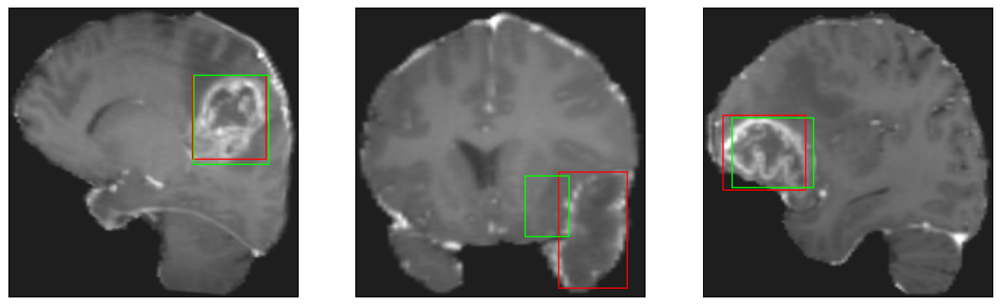

26/26 [==============================] - 3s 117ms/step - loss: 4.2290 - IoU: 0.6620 - val_loss: 8.4050 - val_IoU: 0.5497
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 4.4937 - IoU: 0.6341
Epoch 197: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


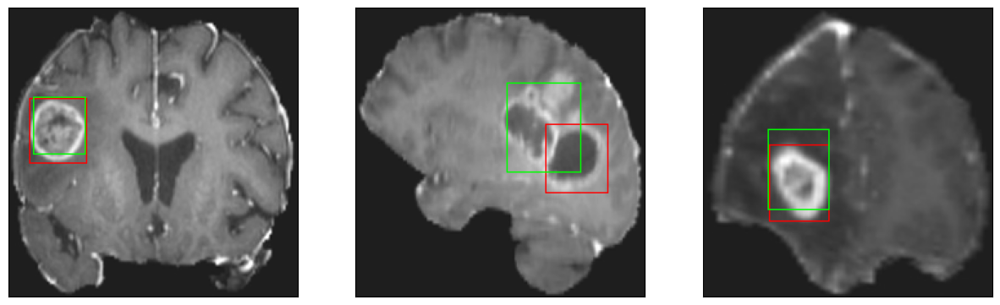

26/26 [==============================] - 3s 110ms/step - loss: 4.4937 - IoU: 0.6341 - val_loss: 8.5409 - val_IoU: 0.5153
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4096 - IoU: 0.6392
Epoch 198: val_IoU did not improve from 0.57602
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


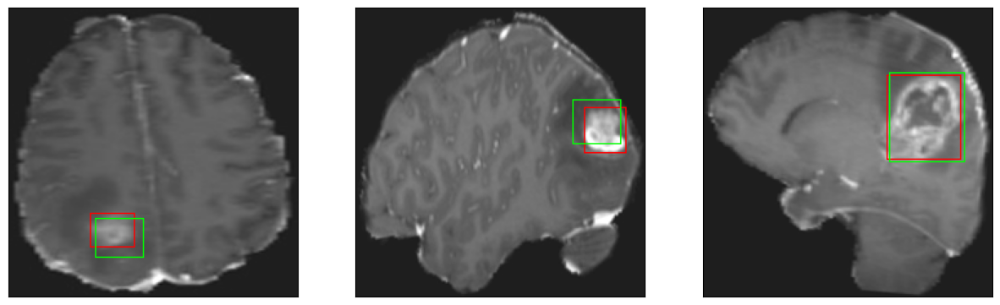

26/26 [==============================] - 3s 106ms/step - loss: 4.3883 - IoU: 0.6399 - val_loss: 8.3750 - val_IoU: 0.5362
Epoch 199/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1653 - IoU: 0.6630
Epoch 199: val_IoU improved from 0.57602 to 0.57792, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


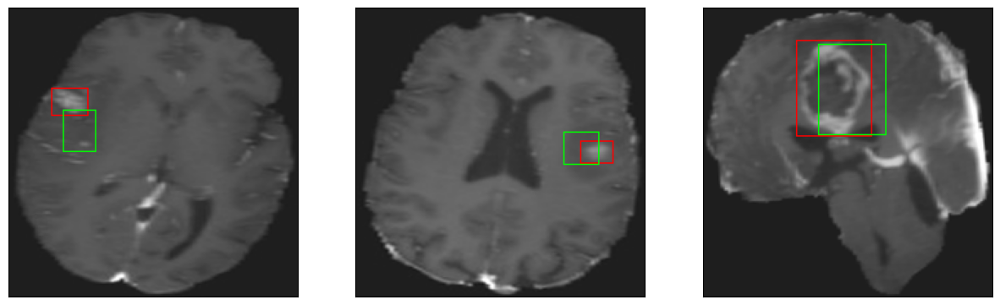

26/26 [==============================] - 4s 167ms/step - loss: 4.1832 - IoU: 0.6608 - val_loss: 7.8526 - val_IoU: 0.5779
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0170 - IoU: 0.6727
Epoch 200: val_IoU did not improve from 0.57792
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


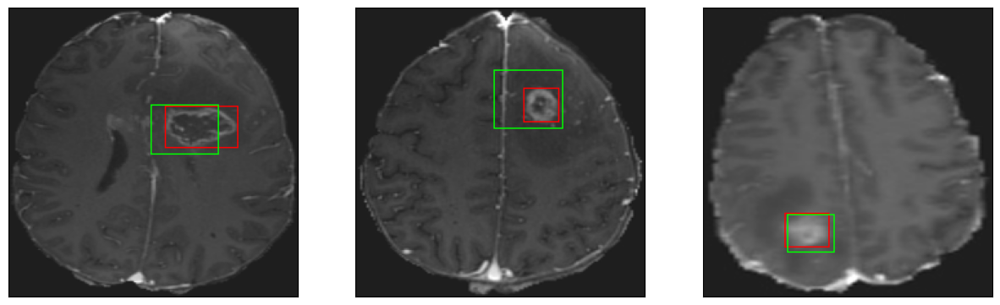

26/26 [==============================] - 3s 115ms/step - loss: 4.0489 - IoU: 0.6715 - val_loss: 8.3042 - val_IoU: 0.5421


In [24]:
#Model fitting
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

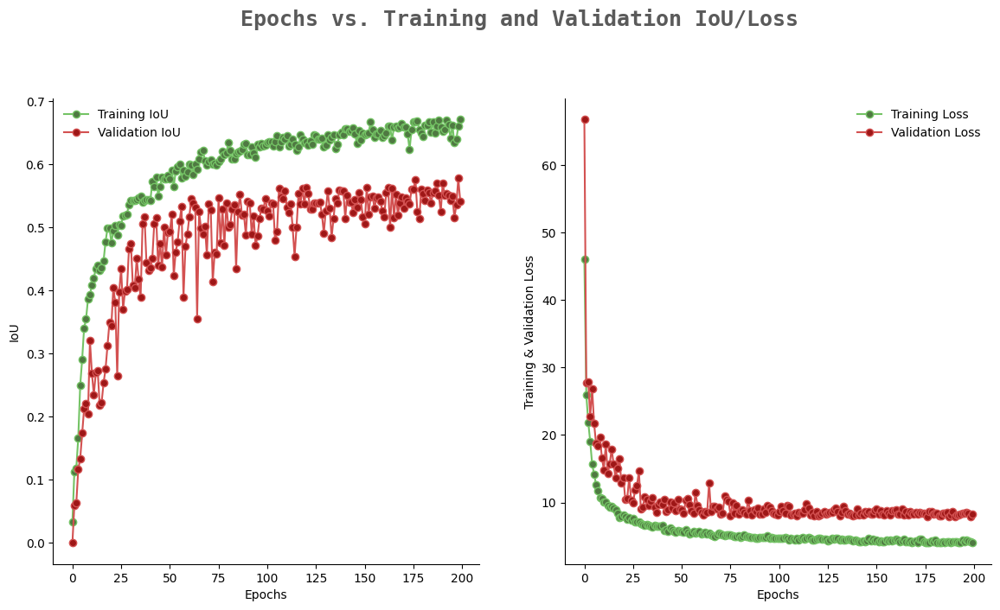

In [25]:
#History plot
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#Load the model with better results
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
#Load the model with better results
model.evaluate(test_dataset)

8/8 [==============================] - 1s 29ms/step - loss: 9.5942 - IoU: 0.4786


[9.594249725341797, 0.47856467962265015]

In [29]:
#Model evaluation in Loss and IoU for the val_dataset
model.evaluate(val_dataset)

3/3 [==============================] - 0s 29ms/step - loss: 7.8526 - IoU: 0.5774


[7.852572917938232, 0.5774405598640442]

In [30]:
#Model evaluation in Loss and IoU for the train_dataset
model.evaluate(train_dataset)

26/26 [==============================] - 1s 42ms/step - loss: 2.9500 - IoU: 0.7566


[2.949950695037842, 0.756632924079895]